# Your First GAN

### Goal
In this notebook, you're going to create your first generative adversarial network (GAN) for this course! Specifically, you will build and train a GAN that can generate hand-written images of digits (0-9). You will be using PyTorch in this specialization, so if you're not familiar with this framework, you may find the [PyTorch documentation](https://pytorch.org/docs/stable/index.html) useful. The hints will also often include links to relevant documentation.

### Learning Objectives
1.   Build the generator and discriminator components of a GAN from scratch.
2.   Create generator and discriminator loss functions.
3.   Train your GAN and visualize the generated images.

## Getting Started
You will begin by importing some useful packages and the dataset you will use to build and train your GAN. You are also provided with a visualizer function to help you investigate the images your GAN will create.


In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST # Training dataset
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in a uniform grid.
    '''
    image_unflat = image_tensor.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

#### MNIST Dataset
The training images your discriminator will be using is from a dataset called [MNIST](http://yann.lecun.com/exdb/mnist/). It contains 60,000 images of handwritten digits.

You may notice that the images are quite pixelated -- this is because they are all only 28 x 28! The small size of its images makes MNIST ideal for simple training. Additionally, these images are also in black-and-white so only one dimension, or "color channel", is needed to represent them (more on this later in the course).

#### Tensor
You will represent the data using [tensors](https://pytorch.org/docs/stable/tensors.html). Tensors are a generalization of matrices: for example, a stack of three matrices with the amounts of red, green, and blue at different locations in a 64 x 64 pixel image is a tensor with the shape 3 x 64 x 64.

Tensors are easy to manipulate and supported by [PyTorch](https://pytorch.org/), the machine learning library you will be using. Feel free to explore them more, but you can imagine these as multi-dimensional matrices or vectors!

#### Batches
While you could train your model after generating one image, it is extremely inefficient and leads to less stable training. In GANs, and in machine learning in general, you will process multiple images per training step. These are called batches.

This means that your generator will generate an entire batch of images and receive the discriminator's feedback on each before updating the model. The same goes for the discriminator, it will calculate its loss on the entire batch of generated images as well as on the reals before the model is updated.

## Generator
The first step is to build the generator component.

You will start by creating a function to make a single layer/block for the generator's neural network. Each block should include a [linear transformation](https://pytorch.org/docs/stable/generated/torch.nn.Linear.html) to map to another shape, a [batch normalization](https://pytorch.org/docs/stable/generated/torch.nn.BatchNorm1d.html) for stabilization, and finally a non-linear activation function (you use a [ReLU here](https://pytorch.org/docs/master/generated/torch.nn.ReLU.html)) so the output can be transformed in complex ways. You will learn more about activations and batch normalization later in the course.

In [2]:
def get_generator_block(input_dim, output_dim):
    '''
    Function for returning a block of the generator's neural network
    given input and output dimensions.
    Parameters:
        input_dim: the dimension of the input vector, a scalar
        output_dim: the dimension of the output vector, a scalar
    Returns:
        a generator neural network layer, with a linear transformation 
          followed by a batch normalization and then a relu activation
    '''
    return nn.Sequential(
        nn.Linear(input_dim, output_dim),
        nn.BatchNorm1d(output_dim),
        nn.ReLU(output_dim),
    )

In [3]:
# Verify the generator block function
def test_gen_block(in_features, out_features, num_test=1000):
    block = get_generator_block(in_features, out_features)

    # Check the three parts
    assert len(block) == 3
    assert type(block[0]) == nn.Linear
    assert type(block[1]) == nn.BatchNorm1d
    assert type(block[2]) == nn.ReLU
    
    # Check the output shape
    test_input = torch.randn(num_test, in_features)
    test_output = block(test_input)
    assert tuple(test_output.shape) == (num_test, out_features)
    assert test_output.std() > 0.55
    assert test_output.std() < 0.65

test_gen_block(25, 12)
test_gen_block(15, 28)
print("Success!")

Success!


Now you can build the generator class. It will take 3 values:

*   The noise vector dimension
*   The image dimension
*   The initial hidden dimension

Using these values, the generator will build a neural network with 5 layers/blocks. Beginning with the noise vector, the generator will apply non-linear transformations via the block function until the tensor is mapped to the size of the image to be outputted (the same size as the real images from MNIST). You will need to fill in the code for final layer since it is different than the others. The final layer does not need a normalization or activation function, but does need to be scaled with a [sigmoid function](https://pytorch.org/docs/master/generated/torch.nn.Sigmoid.html). 

Finally, you are given a forward pass function that takes in a noise vector and generates an image of the output dimension using your neural network.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">Generator</font></code></b>
</font>
</summary>

1. The output size of the final linear transformation should be im_dim, but remember you need to scale the outputs between 0 and 1 using the sigmoid function.
2. [nn.Linear](https://pytorch.org/docs/master/generated/torch.nn.Linear.html) and [nn.Sigmoid](https://pytorch.org/docs/master/generated/torch.nn.Sigmoid.html) will be useful here. 
</details>


In [4]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_dim: the dimension of the images, fitted for the dataset used, a scalar
          (MNIST images are 28 x 28 = 784 so that is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_dim=784, hidden_dim=128):
        super(Generator, self).__init__()
        # Build the neural network
        self.gen = nn.Sequential(
            get_generator_block(z_dim, hidden_dim),
            get_generator_block(hidden_dim, hidden_dim * 2),
            get_generator_block(hidden_dim * 2, hidden_dim * 4),
            get_generator_block(hidden_dim * 4, hidden_dim * 8),
            nn.Linear(hidden_dim * 8, im_dim),
            nn.Sigmoid()
        )
    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        return self.gen(noise)
    
    # Needed for grading
    def get_gen(self):
        '''
        Returns:
            the sequential model
        '''
        return self.gen

In [5]:
# Verify the generator class
def test_generator(z_dim, im_dim, hidden_dim, num_test=10000):
    gen = Generator(z_dim, im_dim, hidden_dim).get_gen()
    
    # Check there are six modules in the sequential part
    assert len(gen) == 6
    assert str(gen.__getitem__(4)).replace(' ', '') == f'Linear(in_features={hidden_dim * 8},out_features={im_dim},bias=True)'
    assert str(gen.__getitem__(5)).replace(' ', '') == 'Sigmoid()'
    test_input = torch.randn(num_test, z_dim)
    test_output = gen(test_input)
    
    # Check that the output shape is correct
    assert tuple(test_output.shape) == (num_test, im_dim)
    assert test_output.max() < 1, "Make sure to use a sigmoid"
    assert test_output.min() > 0, "Make sure to use a sigmoid"
    assert test_output.std() > 0.05, "Don't use batchnorm here"
    assert test_output.std() < 0.15, "Don't use batchnorm here"

test_generator(5, 10, 20)
test_generator(20, 8, 24)
print("Success!")

Success!


## Noise
To be able to use your generator, you will need to be able to create noise vectors. The noise vector z has the important role of making sure the images generated from the same class don't all look the same -- think of it as a random seed. You will generate it randomly using PyTorch by sampling random numbers from the normal distribution. Since multiple images will be processed per pass, you will generate all the noise vectors at once.

Note that whenever you create a new tensor using torch.ones, torch.zeros, or torch.randn, you either need to create it on the target device, e.g. `torch.ones(3, 3, device=device)`, or move it onto the target device using `torch.ones(3, 3).to(device)`. You do not need to do this if you're creating a tensor by manipulating another tensor or by using a variation that defaults the device to the input, such as `torch.ones_like`. In general, use `torch.ones_like` and `torch.zeros_like` instead of `torch.ones` or `torch.zeros` where possible.

<details>

<summary>
<font size="3" color="green">
<b>Optional hint for <code><font size="4">get_noise</font></code></b>
</font>
</summary>

1. 
You will probably find [torch.randn](https://pytorch.org/docs/master/generated/torch.randn.html) useful here.
</details>

In [6]:
def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim),
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    '''
    # NOTE: To use this on GPU with device='cuda', make sure to pass the device 
    # argument to the function you use to generate the noise.
    return torch.randn(n_samples, z_dim).to(device)

In [7]:
# Verify the noise vector function
def test_get_noise(n_samples, z_dim, device='cpu'):
    noise = get_noise(n_samples, z_dim, device)
    
    # Make sure a normal distribution was used
    assert tuple(noise.shape) == (n_samples, z_dim)
    assert torch.abs(noise.std() - torch.tensor(1.0)) < 0.01
    assert str(noise.device).startswith(device)

test_get_noise(1000, 100, 'cpu')
if torch.cuda.is_available():
    test_get_noise(1000, 32, 'cuda')
print("Success!")

Success!


## Discriminator
The second component that you need to construct is the discriminator. As with the generator component, you will start by creating a function that builds a neural network block for the discriminator.

*Note: You use leaky ReLUs to prevent the "dying ReLU" problem, which refers to the phenomenon where the parameters stop changing due to consistently negative values passed to a ReLU, which result in a zero gradient. You will learn more about this in the following lectures!* 





In [8]:
def get_discriminator_block(input_dim, output_dim):
    '''
    Discriminator Block
    Function for returning a neural network of the discriminator given input and output dimensions.
    Parameters:
        input_dim: the dimension of the input vector, a scalar
        output_dim: the dimension of the output vector, a scalar
    Returns:
        a discriminator neural network layer, with a linear transformation 
          followed by an nn.LeakyReLU activation with negative slope of 0.2 
          (https://pytorch.org/docs/master/generated/torch.nn.LeakyReLU.html)
    '''
    return nn.Sequential(
    nn.Linear(input_dim, output_dim),
    nn.LeakyReLU(negative_slope=0.2)
    )
    

In [9]:
# Verify the discriminator block function
def test_disc_block(in_features, out_features, num_test=10000):
    block = get_discriminator_block(in_features, out_features)

    # Check there are two parts
    assert len(block) == 2
    test_input = torch.randn(num_test, in_features)
    test_output = block(test_input)

    # Check that the shape is right
    assert tuple(test_output.shape) == (num_test, out_features)
    
    # Check that the LeakyReLU slope is about 0.2
    assert -test_output.min() / test_output.max() > 0.1
    assert -test_output.min() / test_output.max() < 0.3
    assert test_output.std() > 0.3
    assert test_output.std() < 0.5
    
    assert str(block.__getitem__(0)).replace(' ', '') == f'Linear(in_features={in_features},out_features={out_features},bias=True)'        
    assert str(block.__getitem__(1)).replace(' ', '').replace(',inplace=True', '') == 'LeakyReLU(negative_slope=0.2)'


test_disc_block(25, 12)
test_disc_block(15, 28)
print("Success!")

Success!


Now you can use these blocks to make a discriminator! The discriminator class holds 2 values:

*   The image dimension
*   The hidden dimension

The discriminator will build a neural network with 4 layers. It will start with the image tensor and transform it until it returns a single number (1-dimension tensor) output. This output classifies whether an image is fake or real. Note that you do not need a sigmoid after the output layer since it is included in the loss function. Finally, to use your discrimator's neural network you are given a forward pass function that takes in an image tensor to be classified.


In [10]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
        im_dim: the dimension of the images, fitted for the dataset used, a scalar
            (MNIST images are 28x28 = 784 so that is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_dim=784, hidden_dim=128):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            get_discriminator_block(im_dim, hidden_dim * 4),
            get_discriminator_block(hidden_dim * 4, hidden_dim * 2),
            get_discriminator_block(hidden_dim * 2, hidden_dim),
            # Want to transform the final output into a single value,
            # so add one more linear map
            nn.Linear(hidden_dim, 1)            
        )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_dim)
        '''
        return self.disc(image)
    
    # Needed for grading
    def get_disc(self):
        '''
        Returns:
            the sequential model
        '''
        return self.disc

In [11]:
# Verify the discriminator class
def test_discriminator(z_dim, hidden_dim, num_test=100):
    
    disc = Discriminator(z_dim, hidden_dim).get_disc()

    # Check there are three parts
    assert len(disc) == 4
    assert type(disc.__getitem__(3)) == nn.Linear

    # Check the linear layer is correct
    test_input = torch.randn(num_test, z_dim)
    test_output = disc(test_input)
    assert tuple(test_output.shape) == (num_test, 1)

test_discriminator(5, 10)
test_discriminator(20, 8)
print("Success!")

Success!


## Training
Now you can put it all together!
First, you will set your parameters:
  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type, here using a GPU (which runs CUDA), not CPU

Next, you will load the MNIST dataset as tensors using a dataloader.



In [19]:
from torchvision import datasets

# Set your parameters
criterion = nn.BCEWithLogitsLoss()
n_epochs = 300
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.00001
device = 'cuda'

dataloader = DataLoader(
    MNIST('../../data', download=False, transform=transforms.ToTensor()),
    batch_size=batch_size,
    shuffle=True)

Now, you can initialize your generator, discriminator, and optimizers. Note that each optimizer only takes the parameters of one particular model, since we want each optimizer to optimize only one of the models.

In [13]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator().to(device) 
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

Before you train your GAN, you will need to create functions to calculate the discriminator's loss and the generator's loss. This is how the discriminator and generator will know how they are doing and improve themselves. Since the generator is needed when calculating the discriminator's loss, you will need to call .detach() on the generator result to ensure that only the discriminator is updated!

Remember that you have already defined a loss function earlier (`criterion`) and you are encouraged to use `torch.ones_like` and `torch.zeros_like` instead of `torch.ones` or `torch.zeros`. If you use `torch.ones` or `torch.zeros`, you'll need to pass `device=device` to them.

In [14]:
def get_disc_loss(gen, disc, criterion, real, num_images, z_dim, device):
    '''
    Return the loss of the discriminator given inputs.
    Parameters:
        gen: the generator model, which returns an image given z-dimensional noise
        disc: the discriminator model, which returns a single-dimensional prediction of real/fake
        criterion: the loss function, which should be used to compare 
               the discriminator's predictions to the ground truth reality of the images 
               (e.g. fake = 0, real = 1)
        real: a batch of real images
        num_images: the number of images the generator should produce, 
                which is also the length of the real images
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    Returns:
        disc_loss: a torch scalar loss value for the current batch
    '''
    #     Steps:
    #       1) Create noise vectors and generate a batch (num_images) of fake images. 
    #            Make sure to pass the device argument to the noise.
    #       2) Get the discriminator's prediction of the fake image 
    #            and calculate the loss. Don't forget to detach the generator!
    #            (Remember the loss function you set earlier -- criterion. You need a 
    #            'ground truth' tensor in order to calculate the loss. 
    #            For example, a ground truth tensor for a fake image is all zeros.)
    #       3) Get the discriminator's prediction of the real image and calculate the loss.
    #       4) Calculate the discriminator's loss by averaging the real and fake loss
    #            and set it to disc_loss.
    #     Note: Please do not use concatenation in your solution. The tests are being updated to 
    #           support this, but for now, average the two losses as described in step (4).
    #     *Important*: You should NOT write your own loss function here - use criterion(pred, true)!
    
    # create noise vectors   
    noise_vector = get_noise(num_images, z_dim, device=device)
    
    # Generate fakes
    fakes = gen(noise_vector).detach()

    # Generate fake target labels: all zeros of course
    ground_truth_fake = torch.zeros((num_images,1)).to(device)       
    fake_pred = disc(fakes)
    fake_loss = criterion(fake_pred, ground_truth_fake)
    
    # Generate real target labels: all ones
    ground_truth_real = torch.ones((num_images,1)).to(device)       
    real_pred = disc(real)
    real_loss = criterion(real_pred, ground_truth_real)
  
    disc_loss = (fake_loss + real_loss)/2 
   
    return disc_loss

In [15]:
def test_disc_reasonable(num_images=10):
    # Don't use explicit casts to cuda - use the device argument
    import inspect, re
    lines = inspect.getsource(get_disc_loss)
    assert (re.search(r"to\(.cuda.\)", lines)) is None
    assert (re.search(r"\.cuda\(\)", lines)) is None

    z_dim = 64
    gen = torch.zeros_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.ones(num_images, 1)
    disc_loss = get_disc_loss(gen, disc, criterion, real, num_images, z_dim, 'cpu')
    assert tuple(disc_loss.shape) == (num_images, z_dim)
    assert torch.all(torch.abs(disc_loss - 0.5) < 1e-5)

    gen = torch.ones_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.zeros(num_images, 1)
    assert torch.all(torch.abs(get_disc_loss(gen, disc, criterion, real, num_images, z_dim, 'cpu')) < 1e-5)

def test_disc_loss(max_tests = 10):
    z_dim = 64
    gen = Generator(z_dim).to(device)
    gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
    disc = Discriminator().to(device) 
    disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)
    num_steps = 0
    for real, _ in dataloader:
        cur_batch_size = len(real)
        real = real.view(cur_batch_size, -1).to(device)

        ### Update discriminator ###
        # Zero out the gradient before backpropagation
        disc_opt.zero_grad()

        # Calculate discriminator loss
        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)
        assert (disc_loss - 0.68).abs() < 0.05

        # Update gradients
        disc_loss.backward(retain_graph=True)

        # Check that they detached correctly
        assert gen.gen[0][0].weight.grad is None

        # Update optimizer
        old_weight = disc.disc[0][0].weight.data.clone()
        disc_opt.step()
        new_weight = disc.disc[0][0].weight.data
        
        # Check that some discriminator weights changed
        assert not torch.all(torch.eq(old_weight, new_weight))
        num_steps += 1
        if num_steps >= max_tests:
            break

test_disc_reasonable()
test_disc_loss()
print("Success!")

Success!


In [16]:
def get_gen_loss(gen, disc, criterion, num_images, z_dim, device):
    '''
    Return the loss of the generator given inputs.
    Parameters:
        gen: the generator model, which returns an image given z-dimensional noise
        disc: the discriminator model, which returns a single-dimensional prediction of real/fake
        criterion: the loss function, which should be used to compare 
               the discriminator's predictions to the ground truth reality of the images 
               (e.g. fake = 0, real = 1)
        num_images: the number of images the generator should produce, 
                which is also the length of the real images
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    Returns:
        gen_loss: a torch scalar loss value for the current batch
    '''
    #     These are the steps you will need to complete:
    #       1) Create noise vectors and generate a batch of fake images. 
    #           Remember to pass the device argument to the get_noise function.
    #       2) Get the discriminator's prediction of the fake image.
    #       3) Calculate the generator's loss. Remember the generator wants
    #          the discriminator to think that its fake images are real
    #     *Important*: You should NOT write your own loss function here - use criterion(pred, true)!

    #1
    noise_vector = get_noise(num_images, z_dim, device=device)
    fakes = gen(noise_vector)
    
    #2
    fake_pred = disc(fakes)
    
    #3
    ground_truth_real = torch.ones((num_images,1)).to(device)       
    gen_loss = criterion(fake_pred, ground_truth_real)
    
    return gen_loss

In [17]:
def test_gen_reasonable(num_images=10):
    # Don't use explicit casts to cuda - use the device argument
    import inspect, re
    lines = inspect.getsource(get_gen_loss)
    assert (re.search(r"to\(.cuda.\)", lines)) is None
    assert (re.search(r"\.cuda\(\)", lines)) is None
    
    z_dim = 64
    gen = torch.zeros_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    gen_loss_tensor = get_gen_loss(gen, disc, criterion, num_images, z_dim, 'cpu')
    assert torch.all(torch.abs(gen_loss_tensor) < 1e-5)
    #Verify shape. Related to gen_noise parametrization
    assert tuple(gen_loss_tensor.shape) == (num_images, z_dim)

    gen = torch.ones_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.zeros(num_images, 1)
    gen_loss_tensor = get_gen_loss(gen, disc, criterion, num_images, z_dim, 'cpu')
    assert torch.all(torch.abs(gen_loss_tensor - 1) < 1e-5)
    #Verify shape. Related to gen_noise parametrization
    assert tuple(gen_loss_tensor.shape) == (num_images, z_dim)
    

def test_gen_loss(num_images):
    z_dim = 64
    gen = Generator(z_dim).to(device)
    gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
    disc = Discriminator().to(device) 
    disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)
    
    gen_loss = get_gen_loss(gen, disc, criterion, num_images, z_dim, device)
    
    # Check that the loss is reasonable
    assert (gen_loss - 0.7).abs() < 0.1
    gen_loss.backward()
    old_weight = gen.gen[0][0].weight.clone()
    gen_opt.step()
    new_weight = gen.gen[0][0].weight
    assert not torch.all(torch.eq(old_weight, new_weight))


test_gen_reasonable(10)
test_gen_loss(18)
print("Success!")

Success!


Finally, you can put everything together! For each epoch, you will process the entire dataset in batches. For every batch, you will need to update the discriminator and generator using their loss. Batches are sets of images that will be predicted on before the loss functions are calculated (instead of calculating the loss function after each image). Note that you may see a loss to be greater than 1, this is okay since binary cross entropy loss can be any positive number for a sufficiently confident wrong guess. 

It’s also often the case that the discriminator will outperform the generator, especially at the start, because its job is easier. It's important that neither one gets too good (that is, near-perfect accuracy), which would cause the entire model to stop learning. Balancing the two models is actually remarkably hard to do in a standard GAN and something you will see more of in later lectures and assignments.

After you've submitted a working version with the original architecture, feel free to play around with the architecture if you want to see how different architectural choices can lead to better or worse GANs. For example, consider changing the size of the hidden dimension, or making the networks shallower or deeper by changing the number of layers.

<!-- In addition, be warned that this runs very slowly on a CPU. One way to run this more quickly is to use Google Colab: 

1.   Download the .ipynb
2.   Upload it to Google Drive and open it with Google Colab
3.   Make the runtime type GPU (under “Runtime” -> “Change runtime type” -> Select “GPU” from the dropdown)
4.   Replace `device = "cpu"` with `device = "cuda"`
5.   Make sure your `get_noise` function uses the right device -->

But remember, don’t expect anything spectacular: this is only the first lesson. The results will get better with later lessons as you learn methods to help keep your generator and discriminator at similar levels.

You should roughly expect to see this progression. On a GPU, this should take about 15 seconds per 500 steps, on average, while on CPU it will take roughly 1.5 minutes.

Step 500: Generator loss: 1.5264854619503025, discriminator loss: 0.24435384500026702


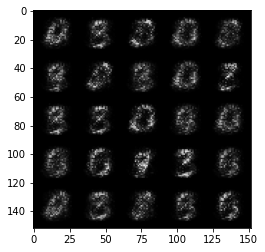

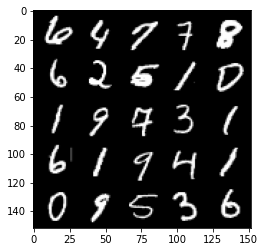

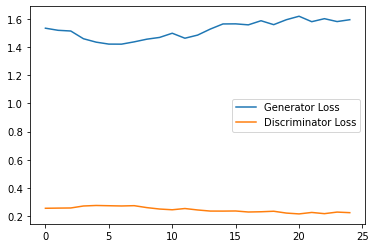

Step 1000: Generator loss: 1.7420979526042946, discriminator loss: 0.20151972523331657


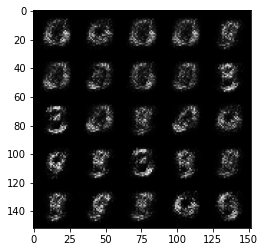

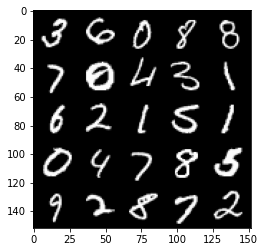

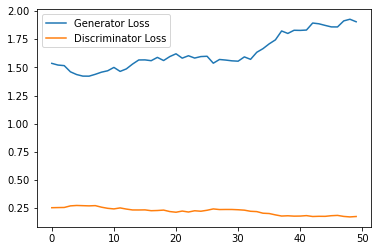

Step 1500: Generator loss: 2.16409227347374, discriminator loss: 0.14967557370662712


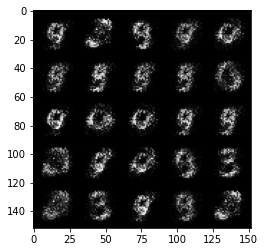

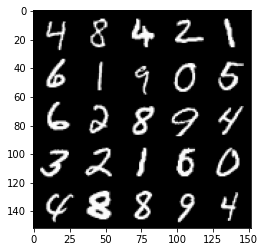

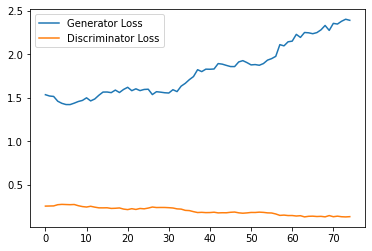

Step 2000: Generator loss: 2.6369085297584522, discriminator loss: 0.11442167016863813


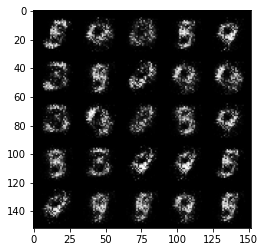

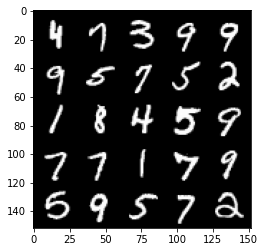

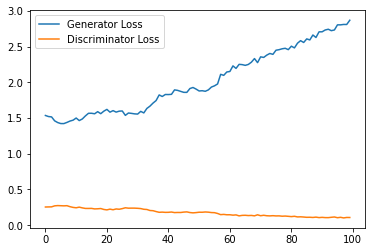

Step 2500: Generator loss: 2.9717389736175517, discriminator loss: 0.1093218379989266


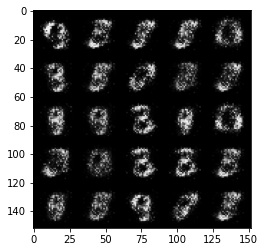

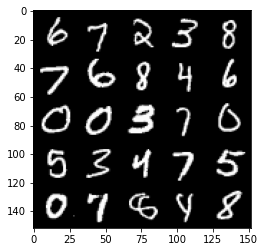

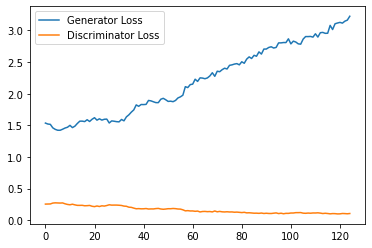

Step 3000: Generator loss: 3.1450655951499953, discriminator loss: 0.10599778549373141


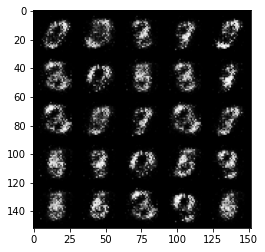

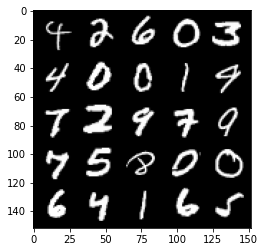

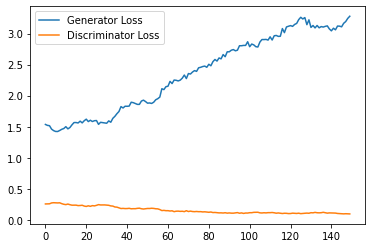

Step 3500: Generator loss: 3.34889638996124, discriminator loss: 0.09231690958142279


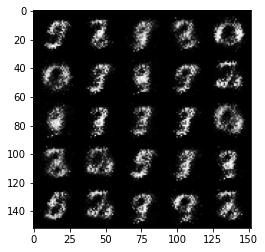

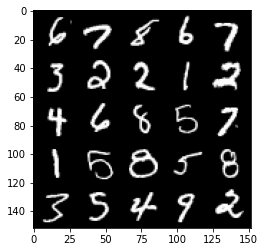

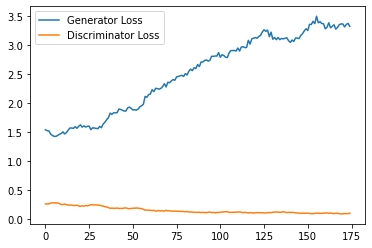

Step 4000: Generator loss: 3.457395180225373, discriminator loss: 0.08484784564375873


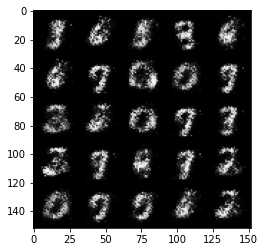

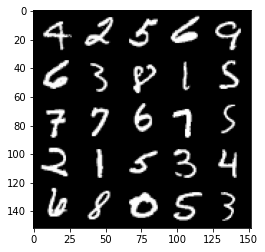

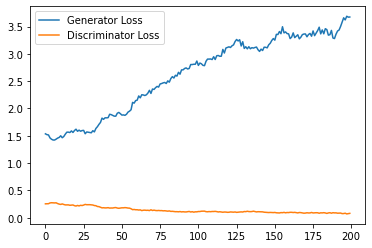

Step 4500: Generator loss: 3.659366892337801, discriminator loss: 0.08232927692681556


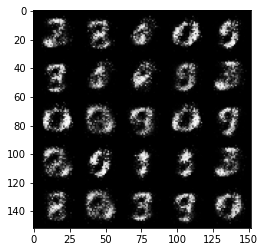

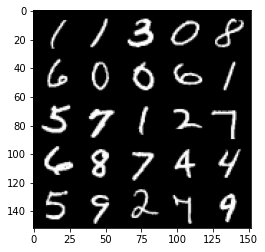

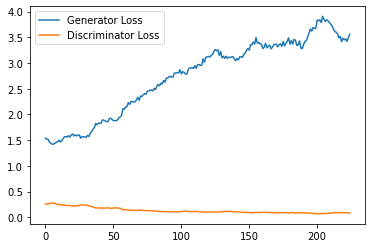

Step 5000: Generator loss: 3.688849759101869, discriminator loss: 0.06893552443385122


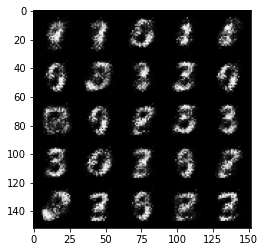

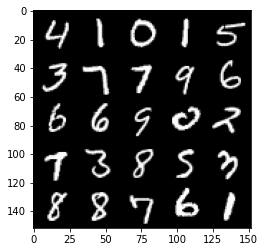

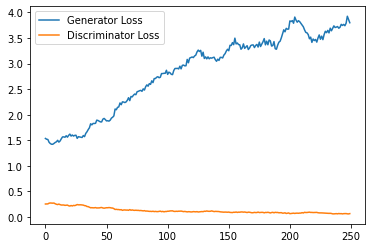

Step 5500: Generator loss: 3.807595335483552, discriminator loss: 0.061394305467605575


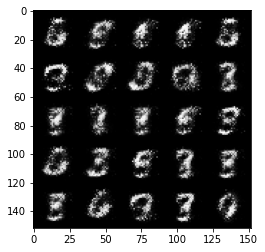

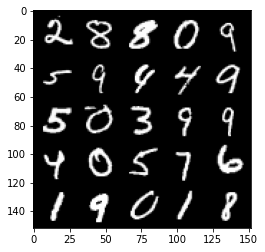

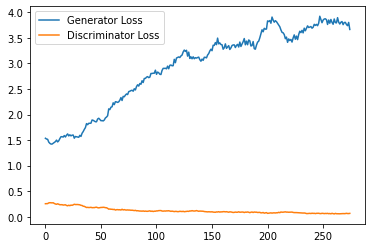

Step 6000: Generator loss: 3.7969432435035695, discriminator loss: 0.05827121646329763


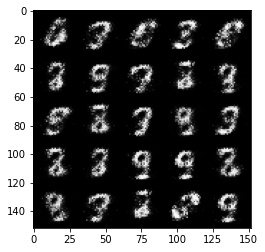

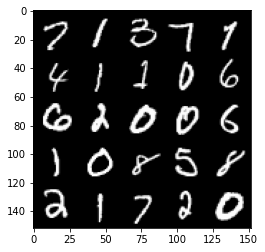

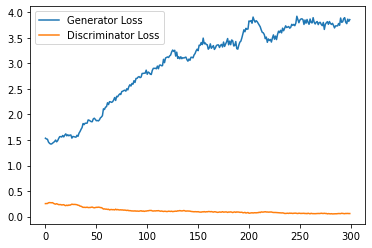

Step 6500: Generator loss: 3.9683666987419137, discriminator loss: 0.05556963275372988


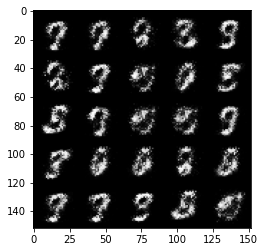

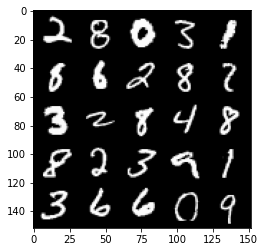

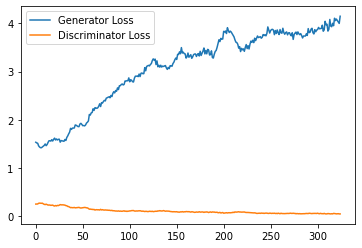

Step 7000: Generator loss: 4.027174983501435, discriminator loss: 0.055213185004889975


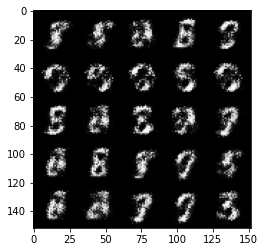

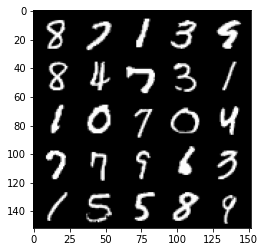

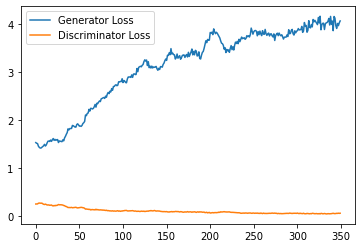

Step 7500: Generator loss: 3.76398860692978, discriminator loss: 0.07945883703976869


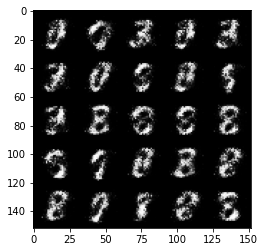

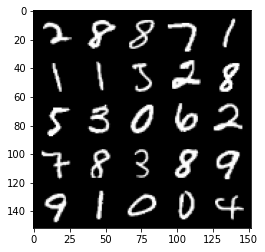

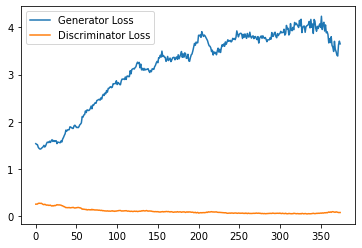

Step 8000: Generator loss: 4.095455059051515, discriminator loss: 0.06249776529893283


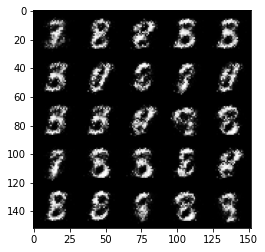

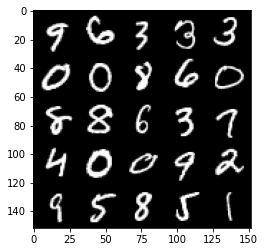

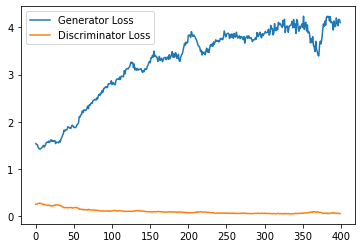

Step 8500: Generator loss: 3.9290654406547585, discriminator loss: 0.06775112795829774


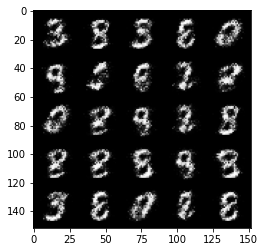

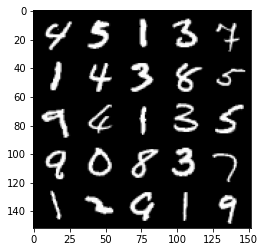

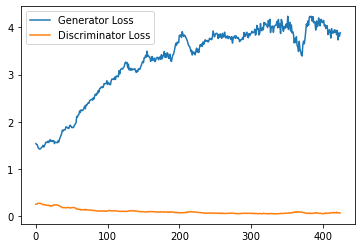

Step 9000: Generator loss: 3.770754985332488, discriminator loss: 0.07490718100965026


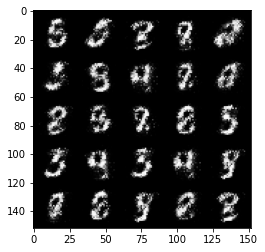

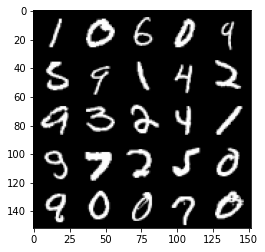

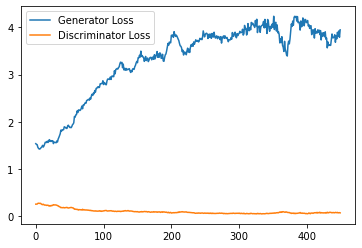

Step 9500: Generator loss: 4.050142638683319, discriminator loss: 0.06408434188738468


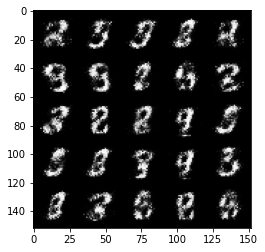

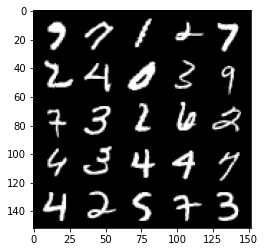

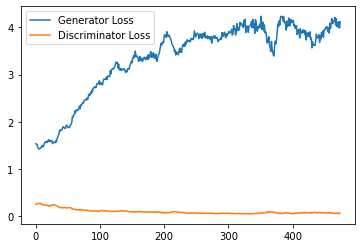

Step 10000: Generator loss: 4.1496702094078035, discriminator loss: 0.07435567834228274


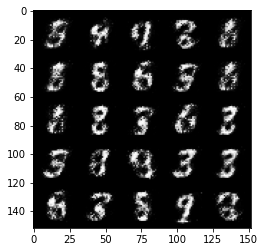

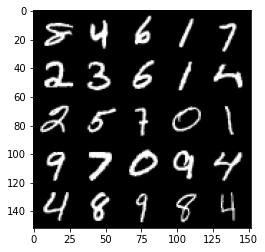

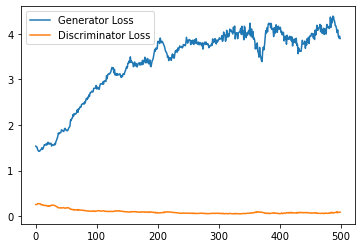

Step 10500: Generator loss: 3.7757845349311836, discriminator loss: 0.0996814285665751


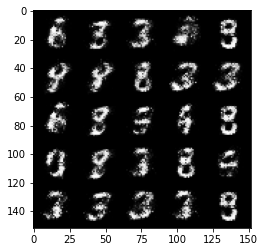

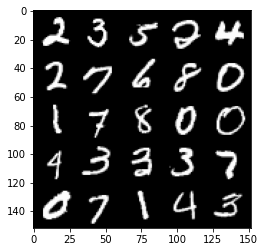

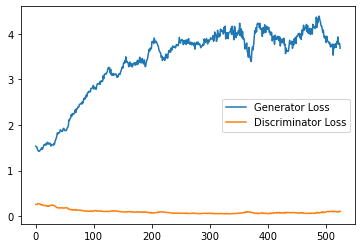

Step 11000: Generator loss: 3.6949355545043954, discriminator loss: 0.09224772820621728


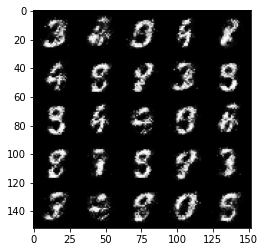

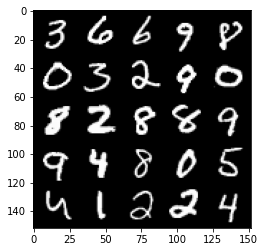

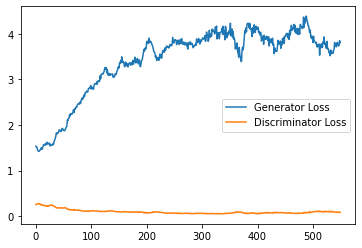

Step 11500: Generator loss: 3.742211918830869, discriminator loss: 0.08137903901189564


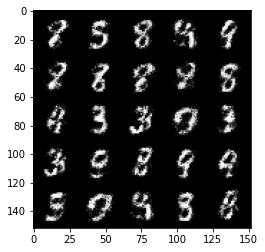

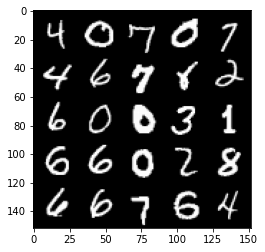

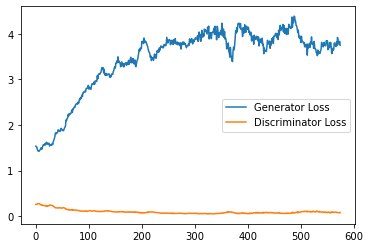

Step 12000: Generator loss: 3.7399335098266606, discriminator loss: 0.08437596870958802


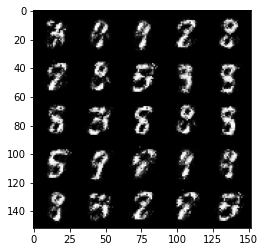

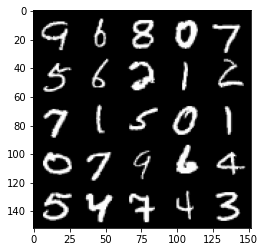

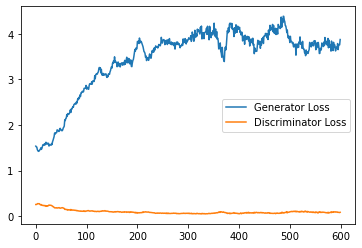

Step 12500: Generator loss: 3.814247184753418, discriminator loss: 0.09502720713615422


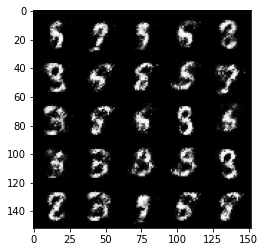

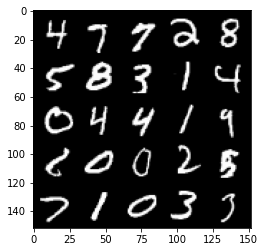

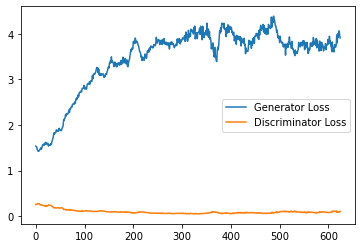

Step 13000: Generator loss: 3.7512380771636975, discriminator loss: 0.0976172095239163


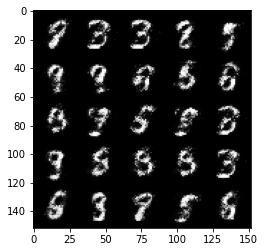

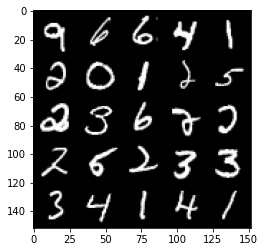

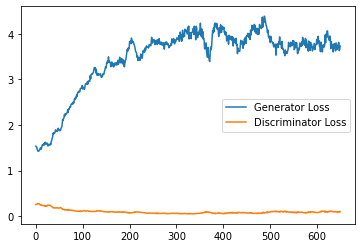

Step 13500: Generator loss: 3.773310491085053, discriminator loss: 0.09729648859053847


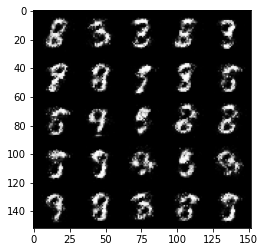

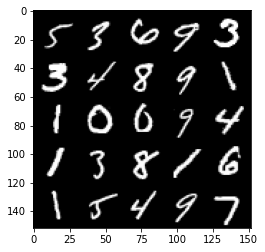

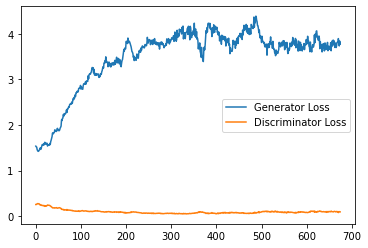

Step 14000: Generator loss: 3.708387634754179, discriminator loss: 0.1092162874341011


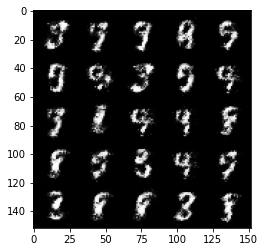

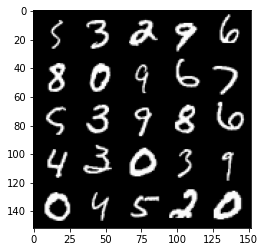

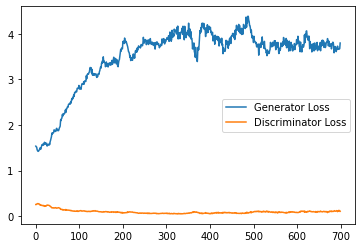

Step 14500: Generator loss: 3.573672239303587, discriminator loss: 0.12783163155615326


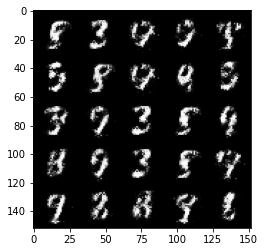

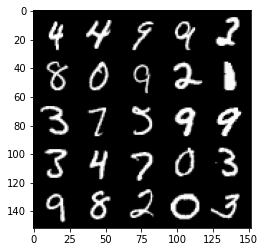

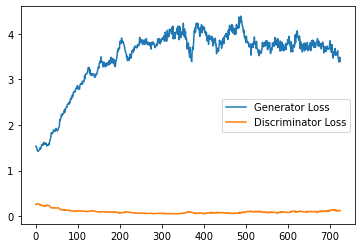

Step 15000: Generator loss: 3.660299725532536, discriminator loss: 0.10973085373640064


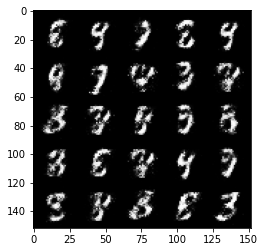

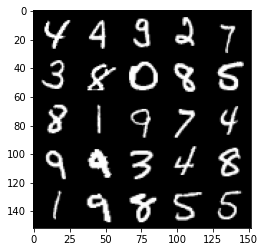

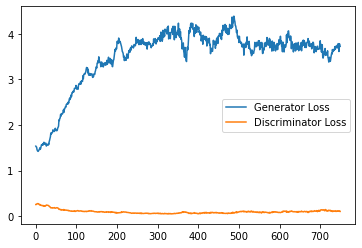

Step 15500: Generator loss: 3.5677596068382242, discriminator loss: 0.12069321951270104


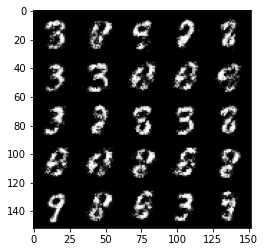

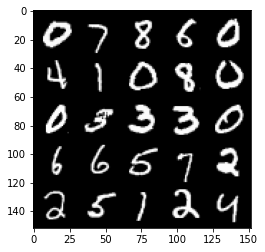

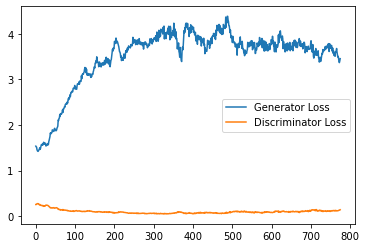

Step 16000: Generator loss: 3.4474994249343878, discriminator loss: 0.12435499951988464


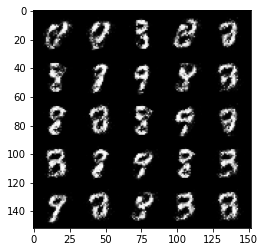

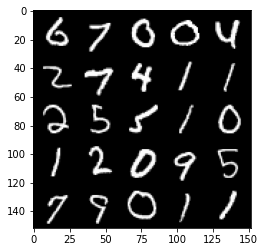

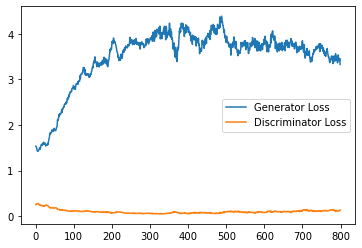

Step 16500: Generator loss: 3.375300864219665, discriminator loss: 0.13992649294435985


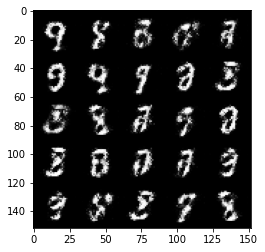

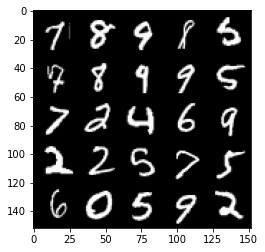

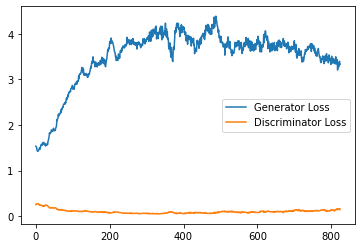

Step 17000: Generator loss: 3.3719838113784775, discriminator loss: 0.1470209354609252


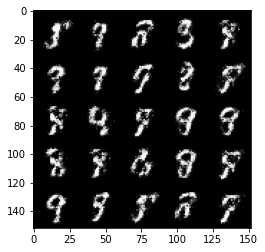

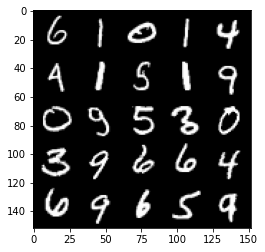

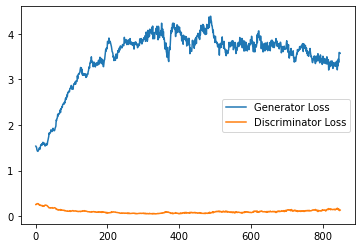

Step 17500: Generator loss: 3.4099179406166096, discriminator loss: 0.1435084673017263


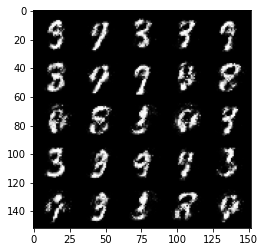

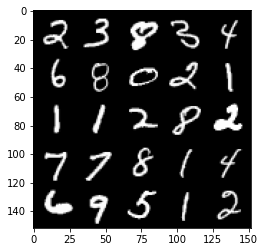

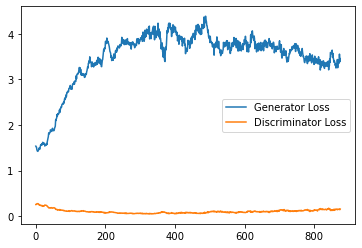

Step 18000: Generator loss: 3.2541837553977926, discriminator loss: 0.16059638421237446


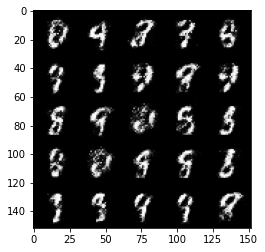

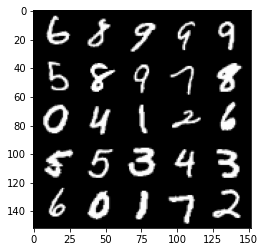

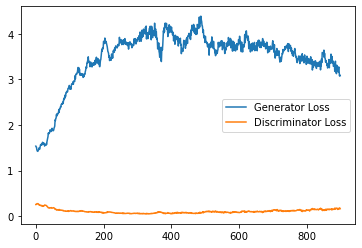

Step 18500: Generator loss: 3.0035812563896154, discriminator loss: 0.17300637078285225


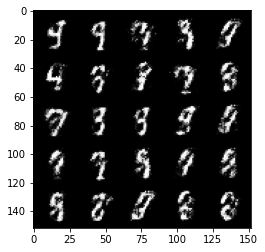

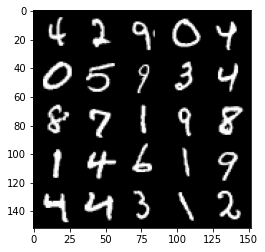

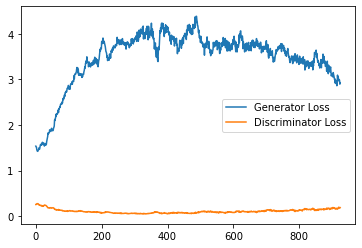

Step 19000: Generator loss: 3.090152382373811, discriminator loss: 0.17419202210009083


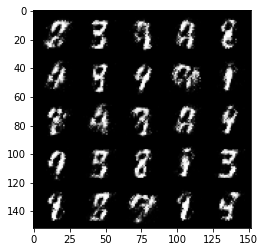

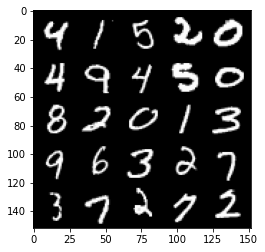

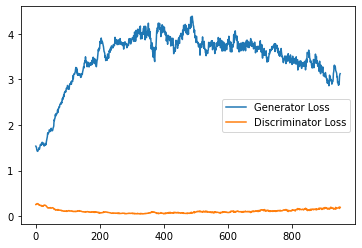

Step 19500: Generator loss: 3.131806980133058, discriminator loss: 0.1762347288280725


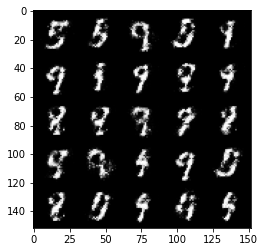

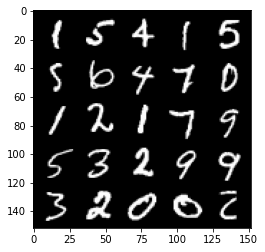

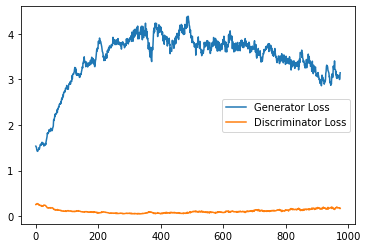

Step 20000: Generator loss: 3.093926209449771, discriminator loss: 0.18208579283952714


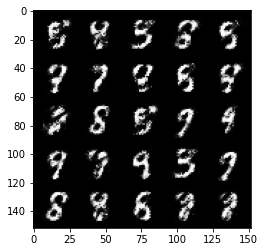

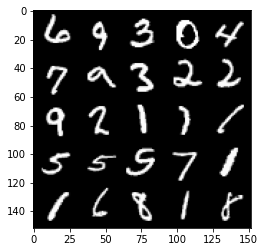

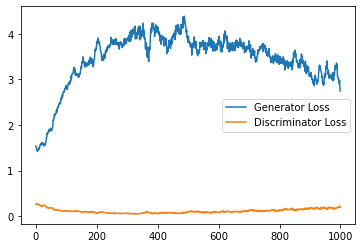

Step 20500: Generator loss: 2.9327570128440863, discriminator loss: 0.18867663037776966


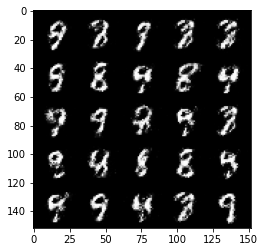

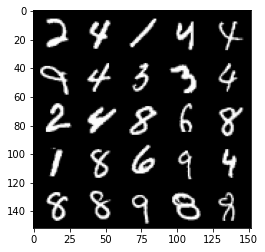

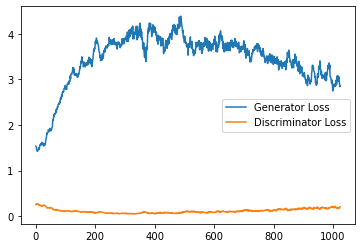

Step 21000: Generator loss: 2.9127020936012267, discriminator loss: 0.18383455322682854


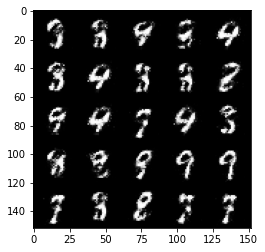

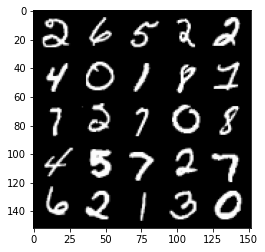

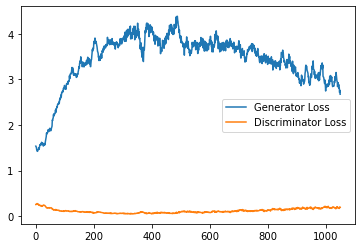

Step 21500: Generator loss: 2.880541340827942, discriminator loss: 0.18839500230550768


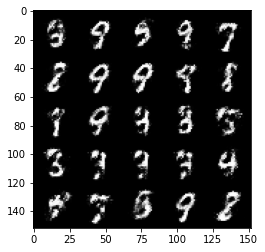

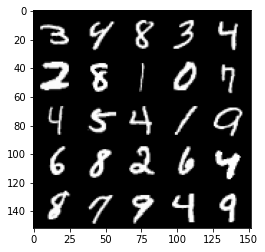

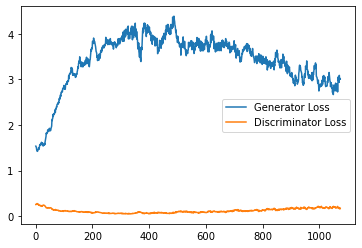

Step 22000: Generator loss: 2.9109692811965955, discriminator loss: 0.17777618472278117


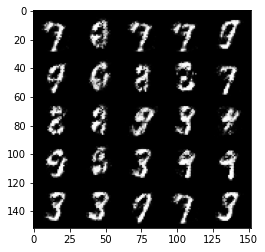

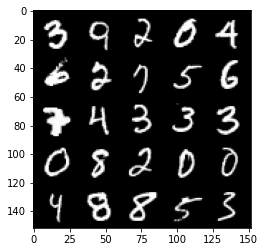

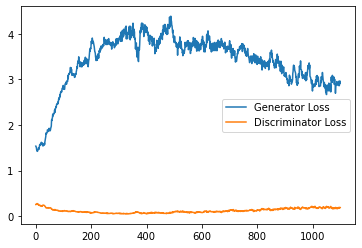

Step 22500: Generator loss: 2.931475523471833, discriminator loss: 0.19320539760589614


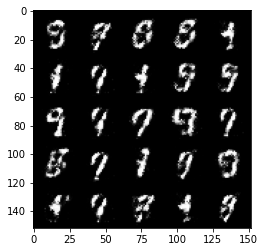

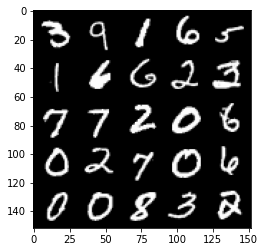

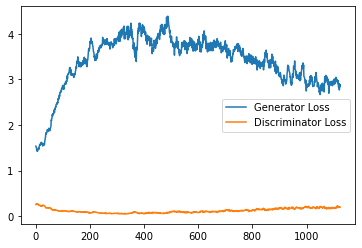

Step 23000: Generator loss: 2.909812596797943, discriminator loss: 0.18365593656897544


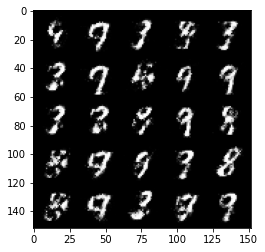

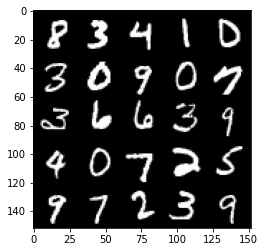

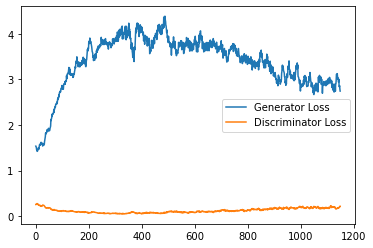

Step 23500: Generator loss: 2.8513283548355126, discriminator loss: 0.20482698516547687


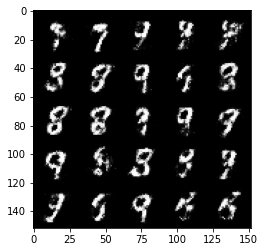

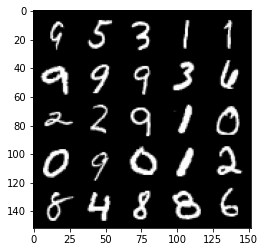

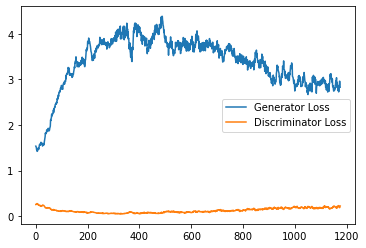

Step 24000: Generator loss: 2.808734551906585, discriminator loss: 0.20351913496851914


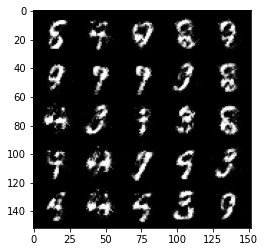

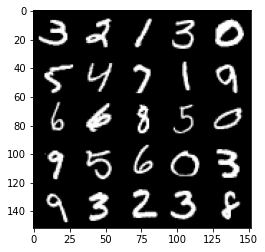

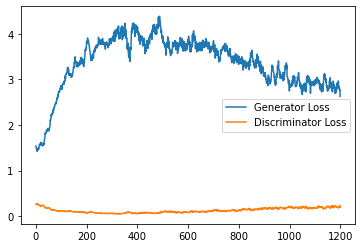

Step 24500: Generator loss: 2.600542063236236, discriminator loss: 0.23412340596318243


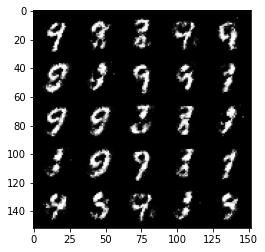

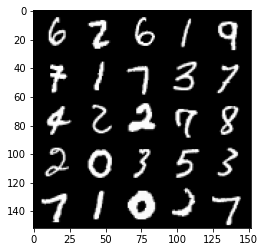

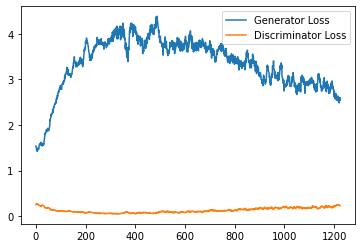

Step 25000: Generator loss: 2.6339447960853577, discriminator loss: 0.22074463877081876


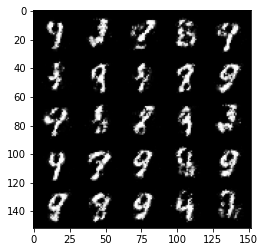

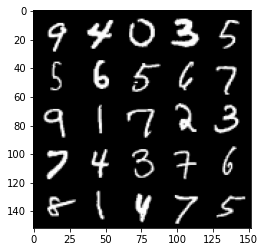

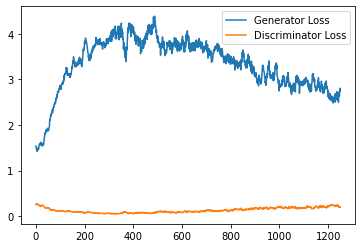

Step 25500: Generator loss: 2.7126805720329252, discriminator loss: 0.2217833012640477


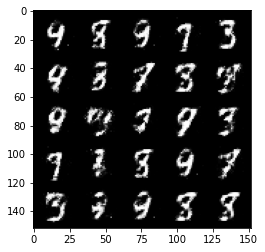

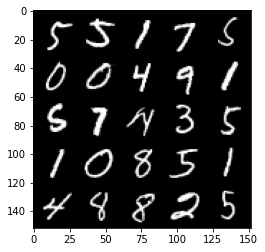

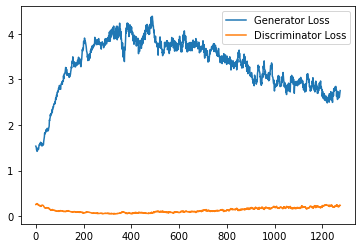

Step 26000: Generator loss: 2.5199348869323694, discriminator loss: 0.2537308275699616


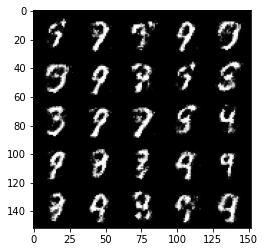

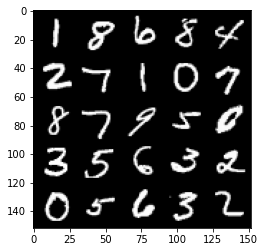

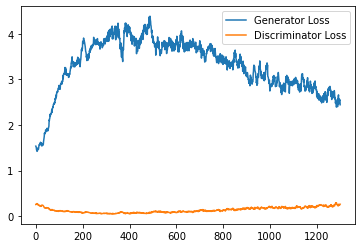

Step 26500: Generator loss: 2.638819114208223, discriminator loss: 0.21026431199908246


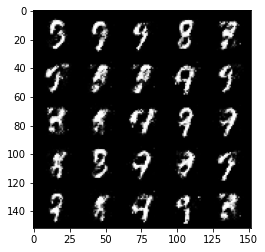

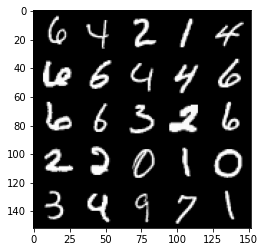

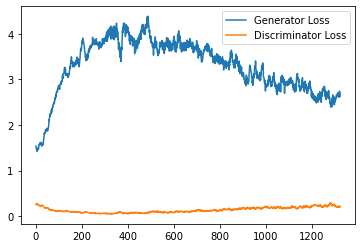

Step 27000: Generator loss: 2.65574126958847, discriminator loss: 0.22098418888449678


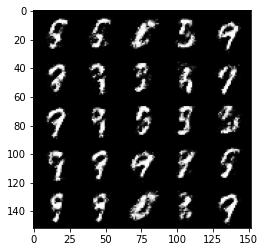

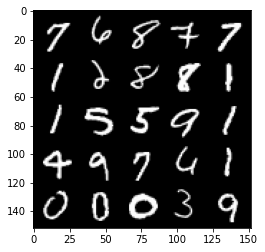

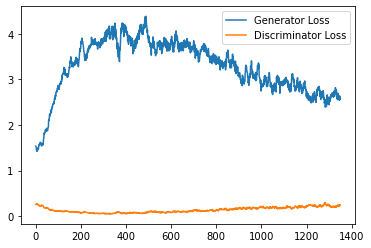

Step 27500: Generator loss: 2.544886087417605, discriminator loss: 0.23363592112064374


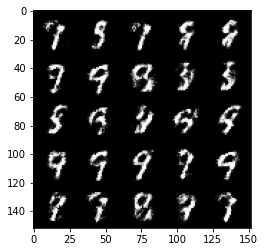

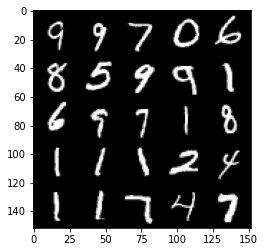

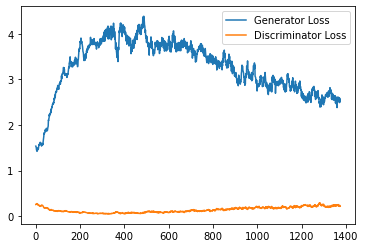

Step 28000: Generator loss: 2.5639998688697783, discriminator loss: 0.23958116132020962


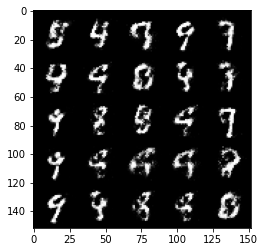

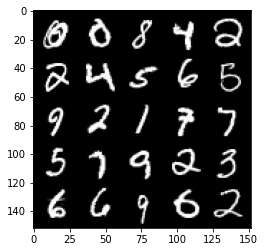

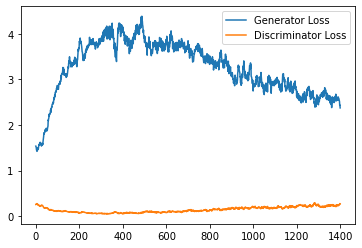

Step 28500: Generator loss: 2.5119004549980186, discriminator loss: 0.2505549831837414


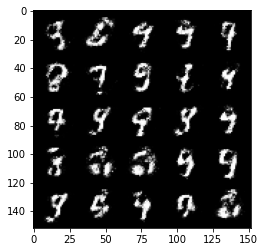

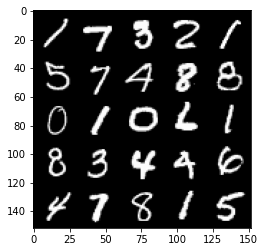

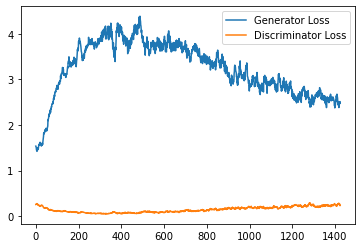

Step 29000: Generator loss: 2.491185557842256, discriminator loss: 0.2559755989313126


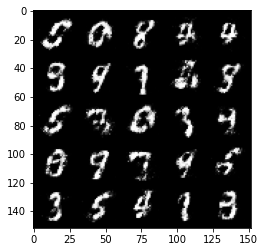

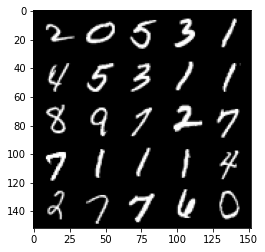

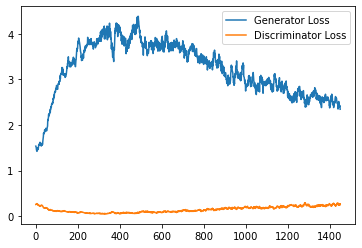

Step 29500: Generator loss: 2.338339460849764, discriminator loss: 0.26078536418080317


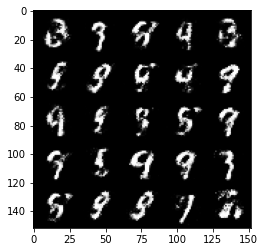

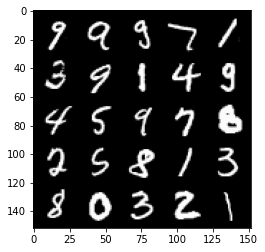

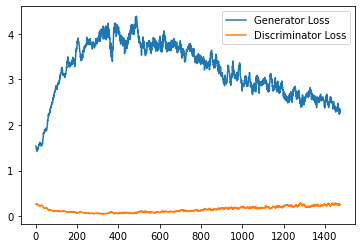

Step 30000: Generator loss: 2.4994548697471624, discriminator loss: 0.23661578607559203


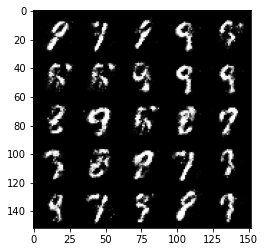

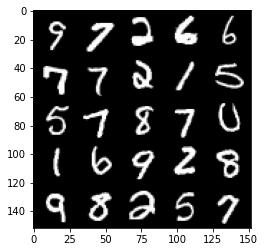

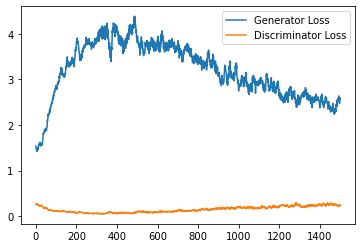

Step 30500: Generator loss: 2.495522204399108, discriminator loss: 0.23868629088997823


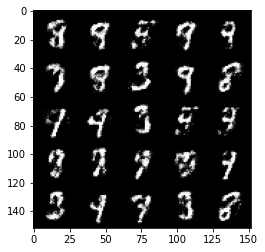

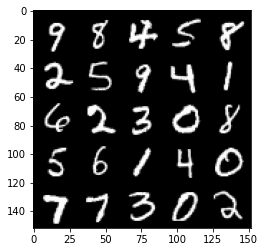

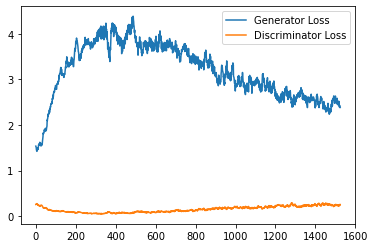

Step 31000: Generator loss: 2.50433212852478, discriminator loss: 0.2369017255306243


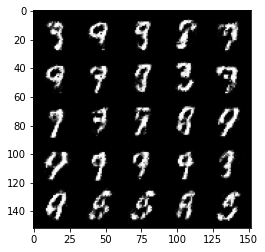

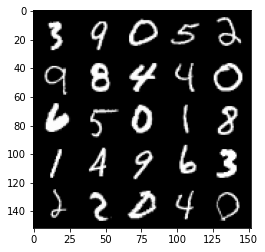

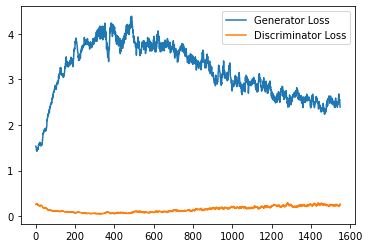

Step 31500: Generator loss: 2.387162135362627, discriminator loss: 0.2550650466978549


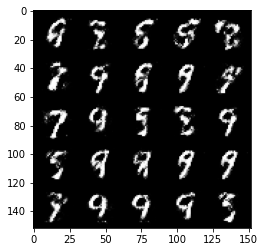

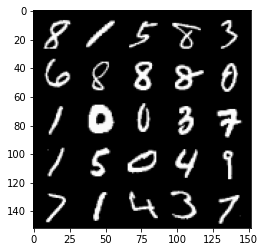

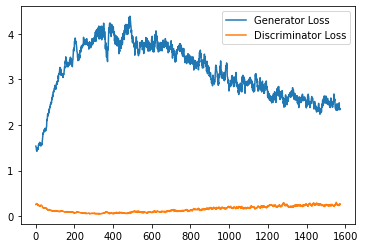

Step 32000: Generator loss: 2.39863906264305, discriminator loss: 0.24737747648358344


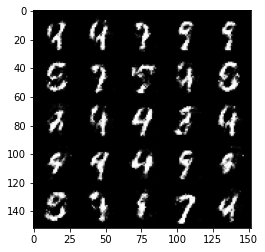

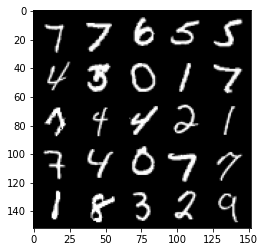

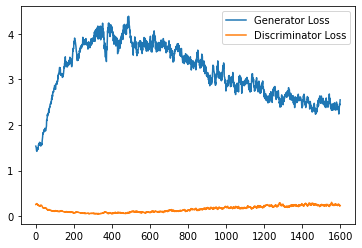

Step 32500: Generator loss: 2.4047903931140904, discriminator loss: 0.261089506596327


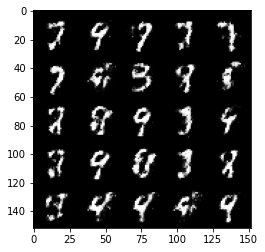

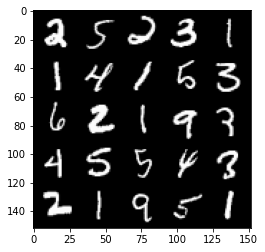

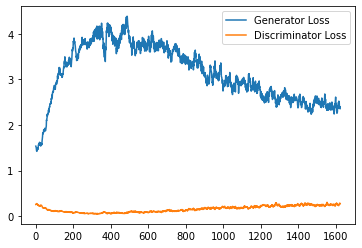

Step 33000: Generator loss: 2.4412852940559393, discriminator loss: 0.24209592750668504


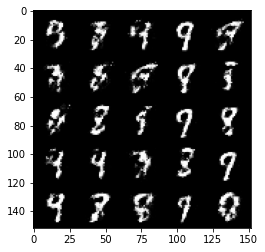

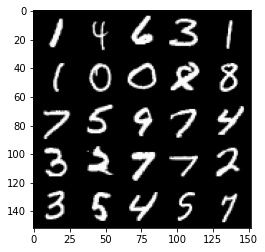

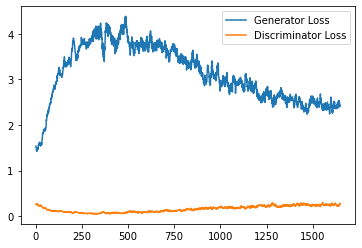

Step 33500: Generator loss: 2.4290792601108535, discriminator loss: 0.24006031700968739


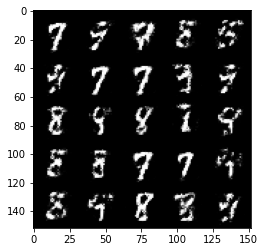

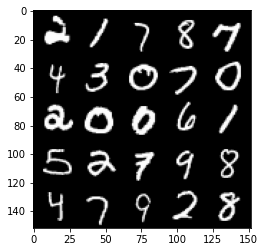

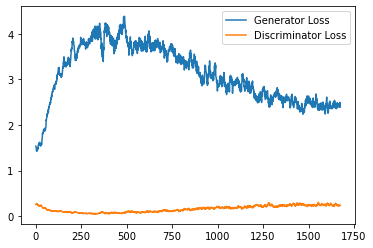

Step 34000: Generator loss: 2.3720047812461846, discriminator loss: 0.2559721970260142


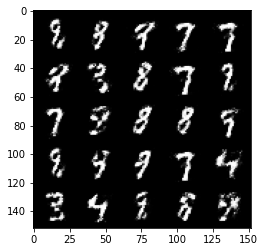

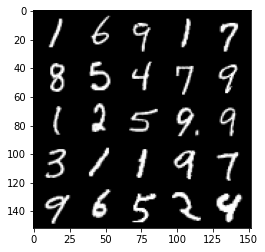

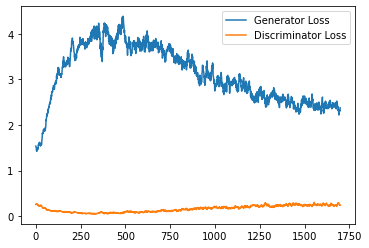

Step 34500: Generator loss: 2.4332027742862694, discriminator loss: 0.24984992226958286


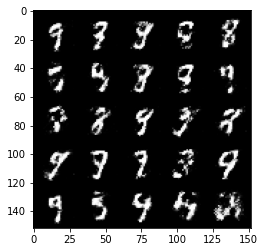

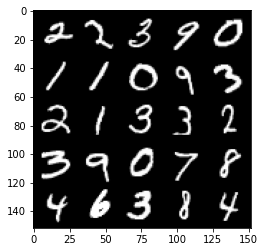

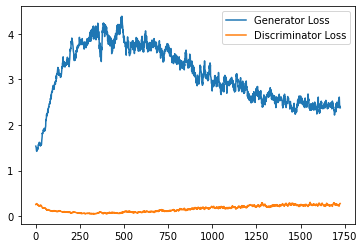

Step 35000: Generator loss: 2.3160606403350843, discriminator loss: 0.26204401537775995


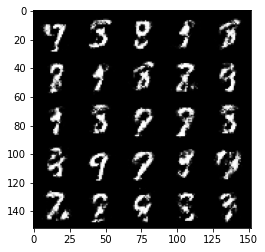

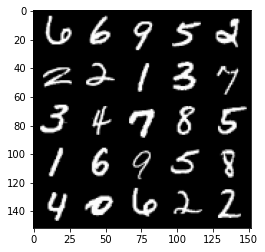

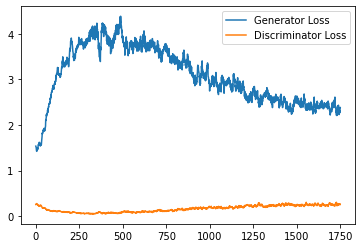

Step 35500: Generator loss: 2.279396752119067, discriminator loss: 0.2761295798420903


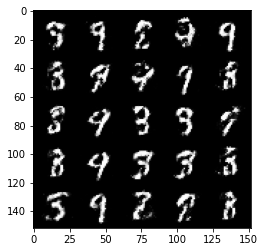

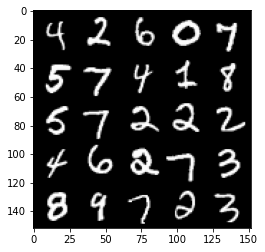

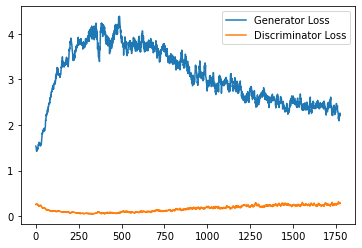

Step 36000: Generator loss: 2.2511383719444287, discriminator loss: 0.27150530886650087


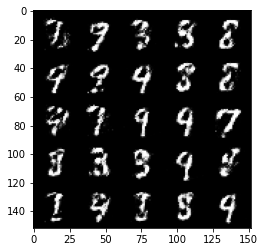

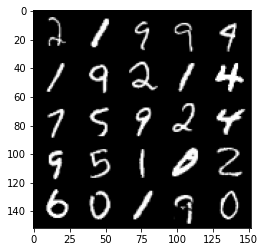

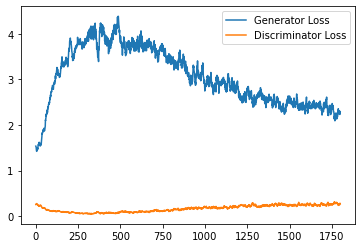

Step 36500: Generator loss: 2.179023019313813, discriminator loss: 0.2985196535587313


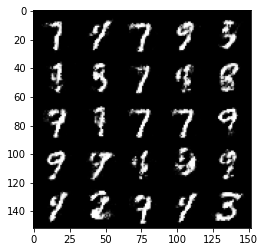

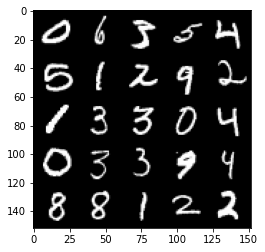

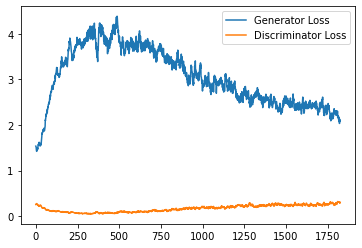

Step 37000: Generator loss: 2.0856061925888048, discriminator loss: 0.30958469837903985


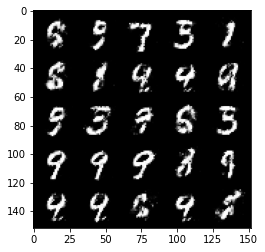

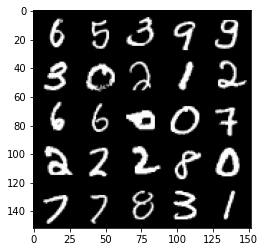

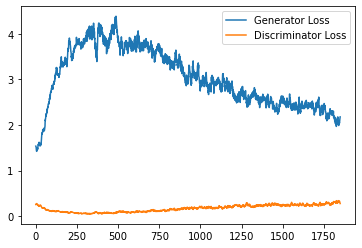

Step 37500: Generator loss: 2.1356328833103175, discriminator loss: 0.2918460139334199


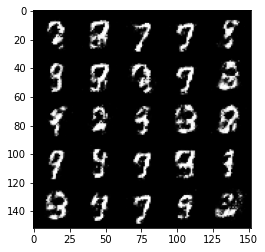

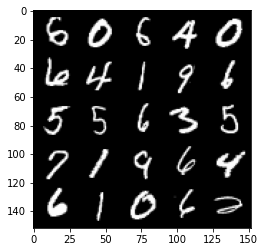

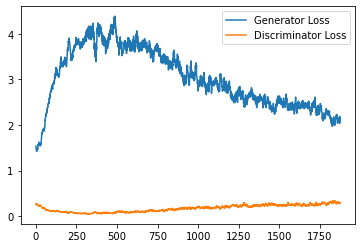

Step 38000: Generator loss: 2.2328517320156105, discriminator loss: 0.2736995963454247


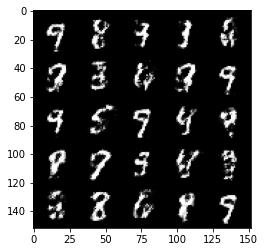

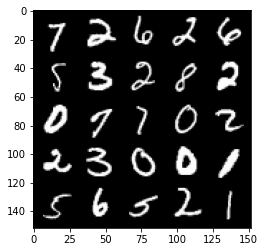

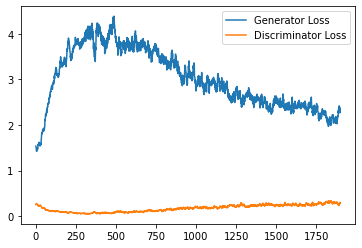

Step 38500: Generator loss: 2.076452551364899, discriminator loss: 0.3282341381311418


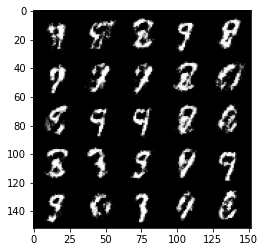

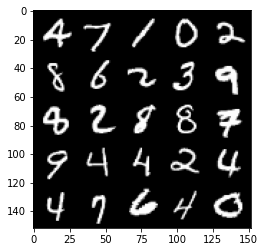

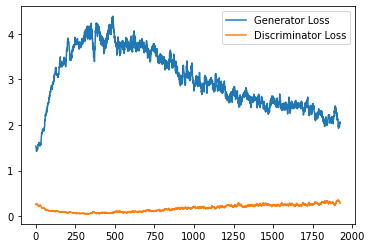

Step 39000: Generator loss: 2.1536309788227084, discriminator loss: 0.32143012946844096


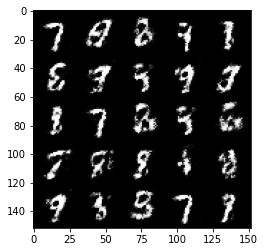

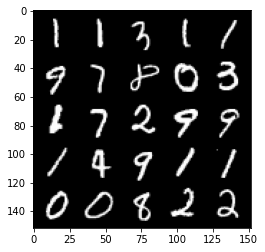

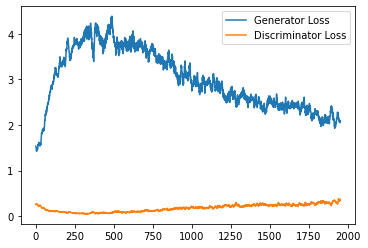

Step 39500: Generator loss: 2.0083804891109454, discriminator loss: 0.3217936766147613


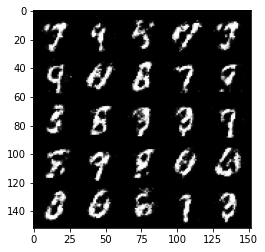

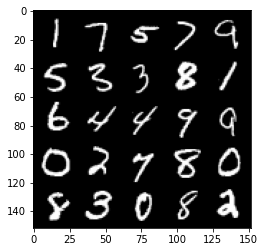

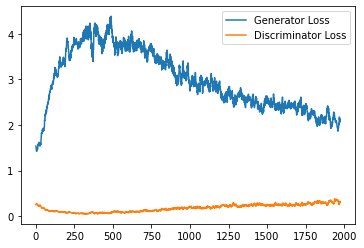

Step 40000: Generator loss: 2.1190066039562216, discriminator loss: 0.29334824436902984


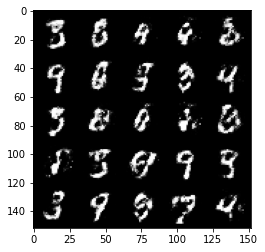

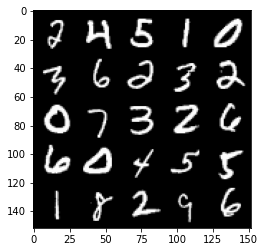

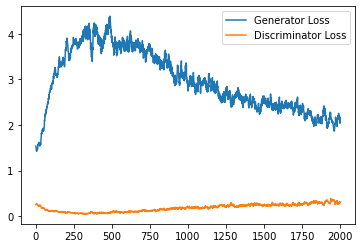

Step 40500: Generator loss: 2.1630297026634198, discriminator loss: 0.2910507251024249


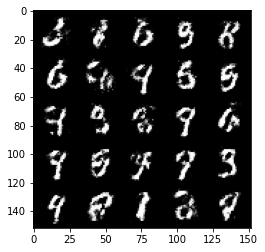

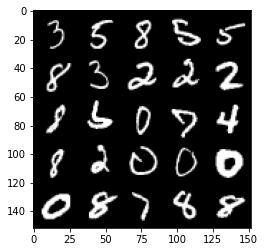

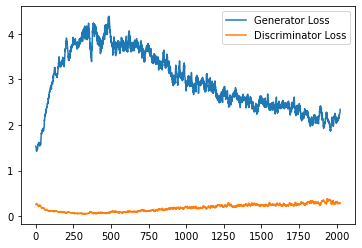

Step 41000: Generator loss: 2.059360265731812, discriminator loss: 0.31084284779429455


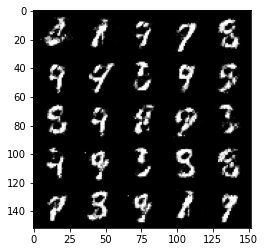

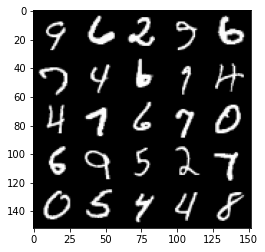

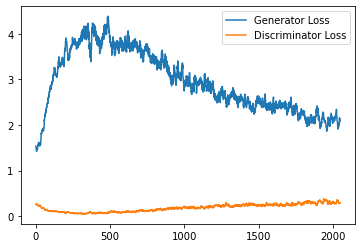

Step 41500: Generator loss: 2.101049045324325, discriminator loss: 0.30865264940261833


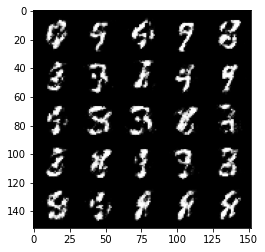

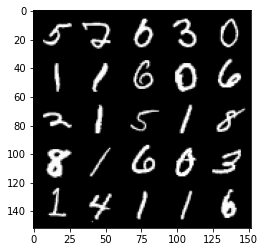

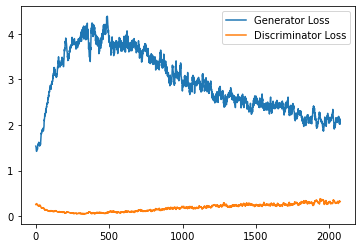

Step 42000: Generator loss: 2.0553397908210753, discriminator loss: 0.2995784569978713


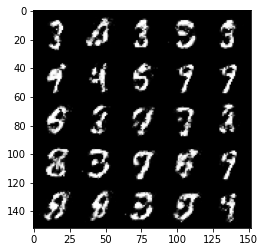

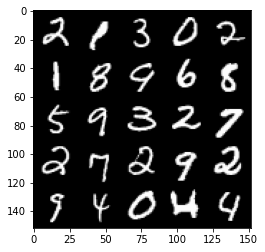

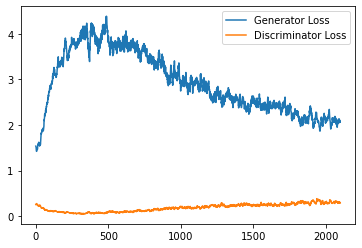

Step 42500: Generator loss: 2.0785872619152075, discriminator loss: 0.30109783032536513


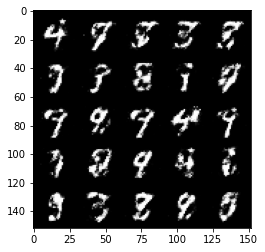

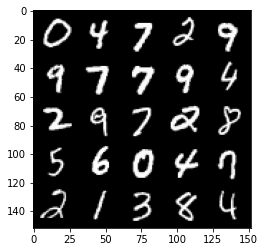

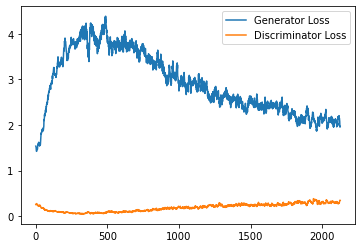

Step 43000: Generator loss: 1.993002346754076, discriminator loss: 0.31725184044241883


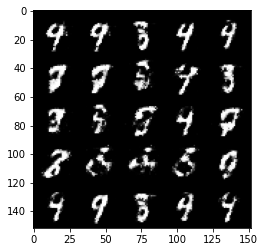

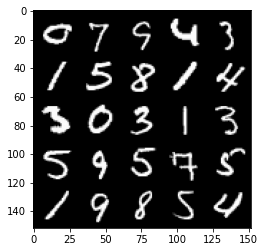

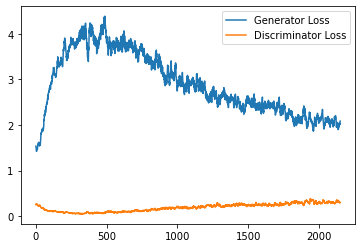

Step 43500: Generator loss: 2.0897571041584015, discriminator loss: 0.2968133019804955


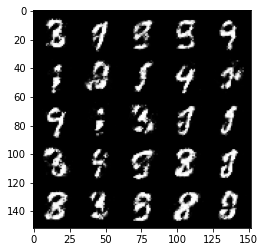

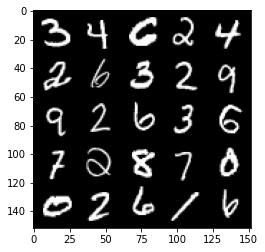

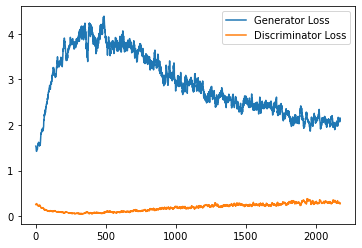

Step 44000: Generator loss: 2.0193870165348065, discriminator loss: 0.31219136628508526


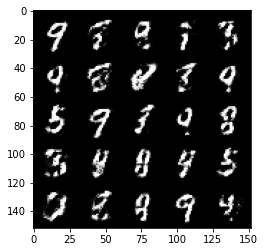

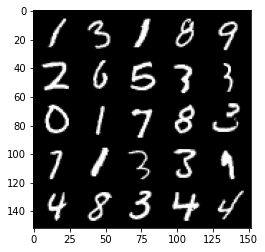

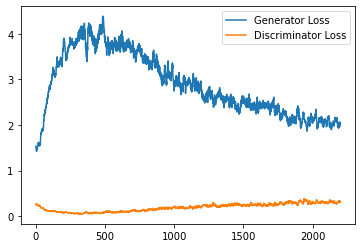

Step 44500: Generator loss: 1.9243135983943926, discriminator loss: 0.32716826224327095


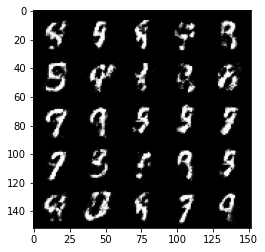

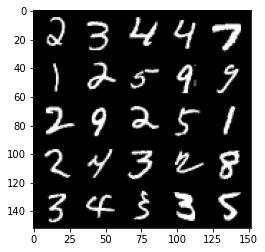

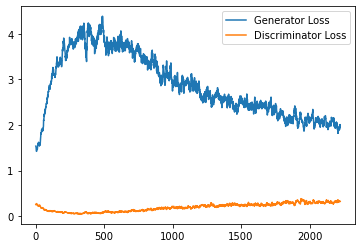

Step 45000: Generator loss: 1.9509814717769631, discriminator loss: 0.3378106980621814


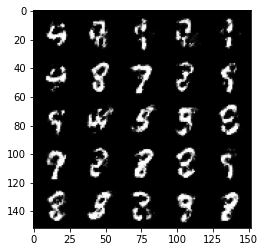

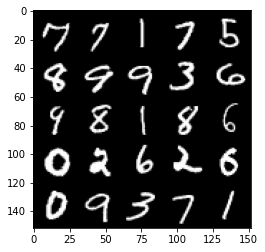

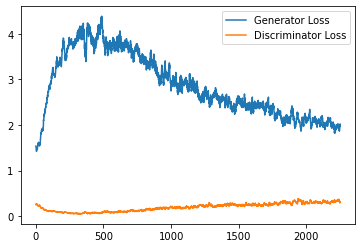

Step 45500: Generator loss: 1.9677473101615897, discriminator loss: 0.32979117712378475


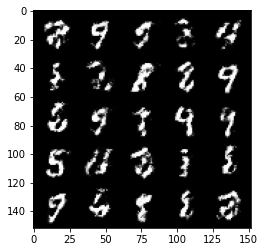

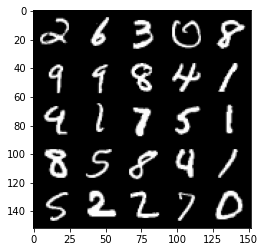

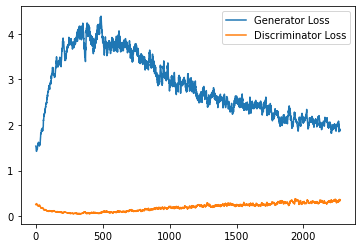

Step 46000: Generator loss: 1.9041088750362396, discriminator loss: 0.32843868610262844


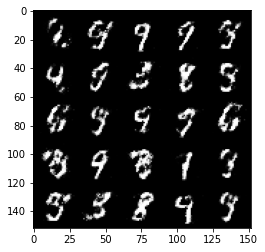

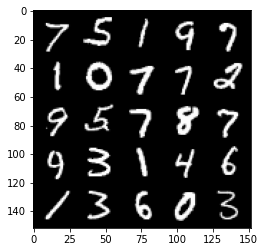

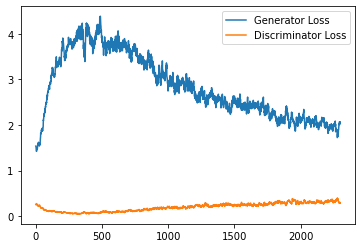

Step 46500: Generator loss: 2.0398099517822263, discriminator loss: 0.3053457267880441


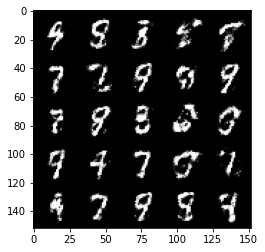

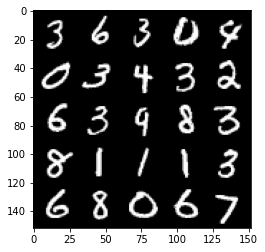

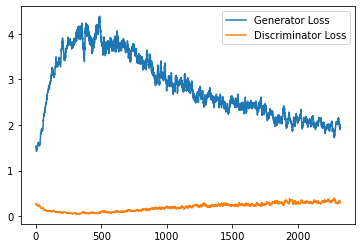

Step 47000: Generator loss: 2.0630862338542943, discriminator loss: 0.30298382666707074


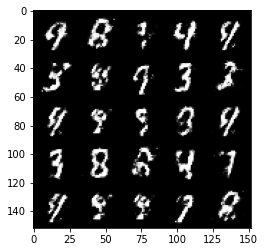

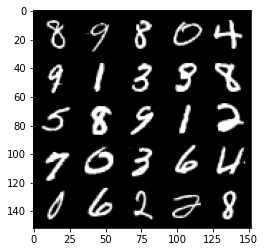

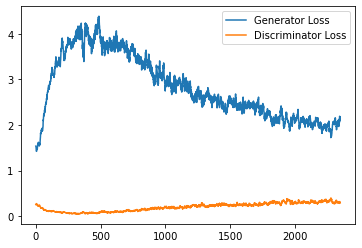

Step 47500: Generator loss: 2.0259095067977926, discriminator loss: 0.3208656568527222


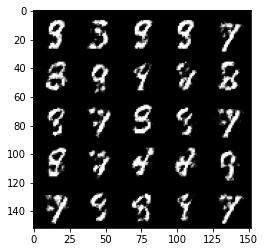

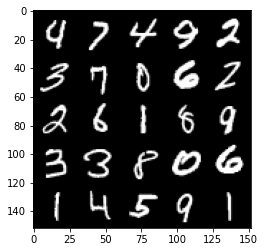

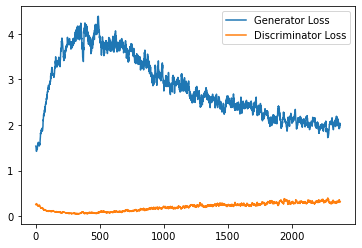

Step 48000: Generator loss: 2.0846148803234086, discriminator loss: 0.3013264422714712


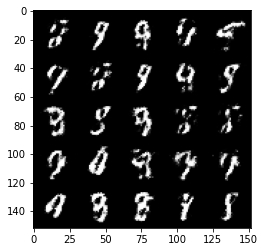

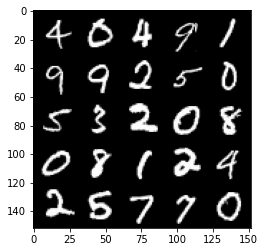

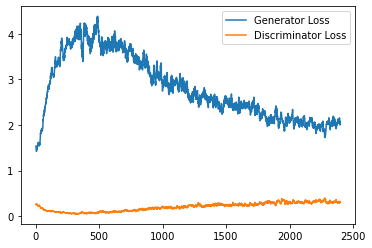

Step 48500: Generator loss: 1.9892873570919036, discriminator loss: 0.32200837197899823


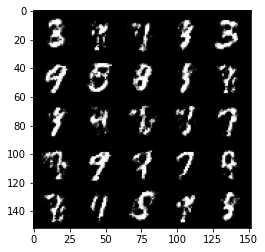

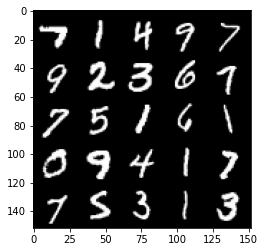

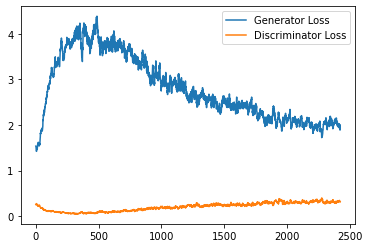

Step 49000: Generator loss: 1.9039561734199497, discriminator loss: 0.34394257956743246


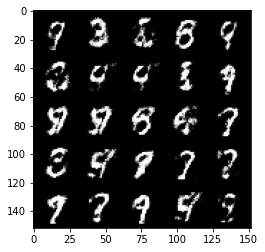

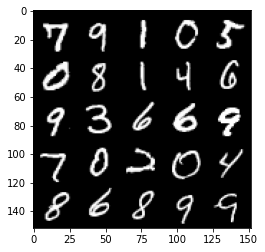

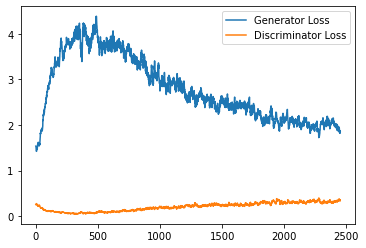

Step 49500: Generator loss: 1.917924566984177, discriminator loss: 0.3258404954969881


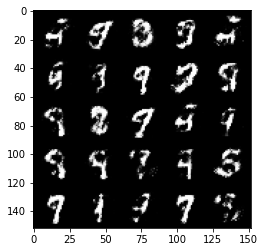

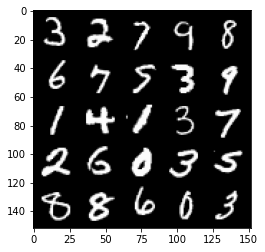

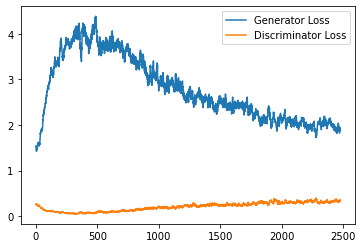

Step 50000: Generator loss: 1.9278291339874278, discriminator loss: 0.3210961917042733


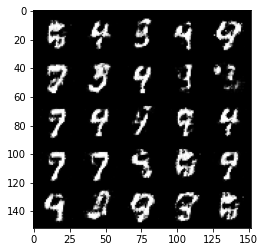

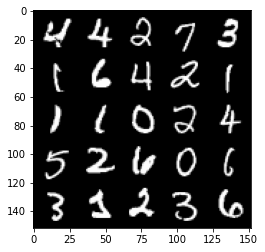

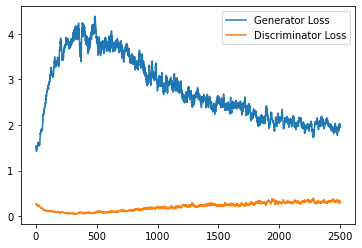

Step 50500: Generator loss: 1.936092343568801, discriminator loss: 0.32983891031146056


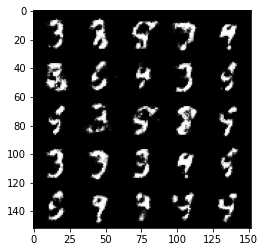

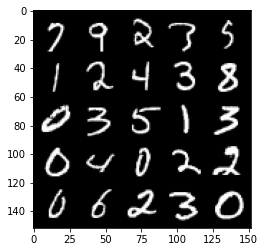

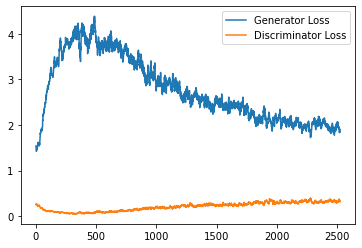

Step 51000: Generator loss: 1.951423767805101, discriminator loss: 0.32700650700926737


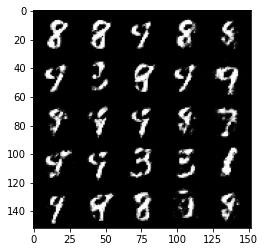

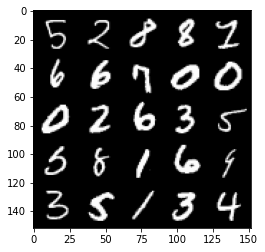

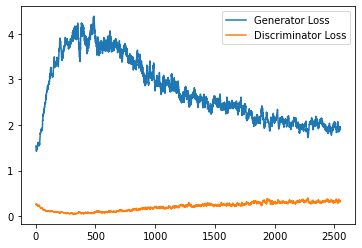

Step 51500: Generator loss: 1.9504426150321952, discriminator loss: 0.3191237117648123


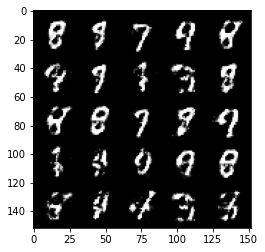

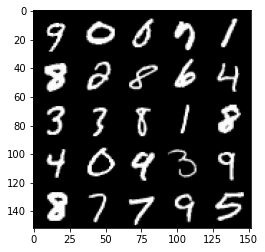

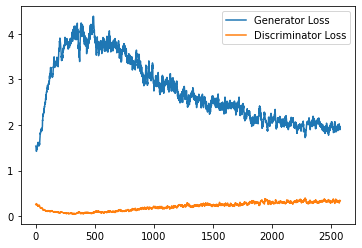

Step 52000: Generator loss: 1.9299784097671502, discriminator loss: 0.32149769595265426


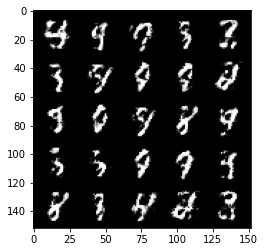

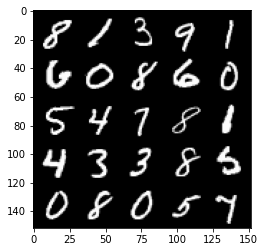

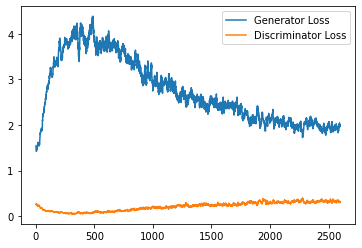

Step 52500: Generator loss: 1.8717725465297685, discriminator loss: 0.34971656933426853


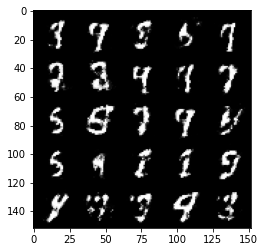

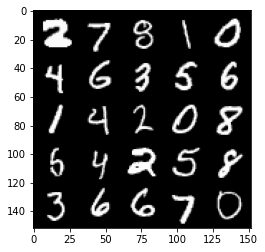

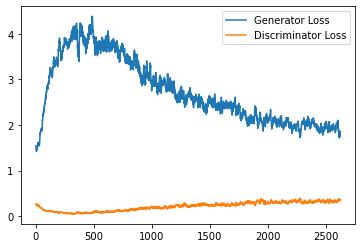

Step 53000: Generator loss: 1.9584781496524832, discriminator loss: 0.32393714234232895


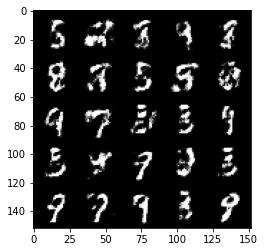

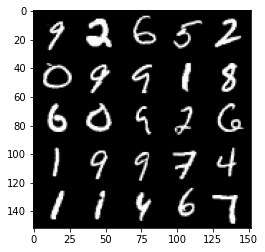

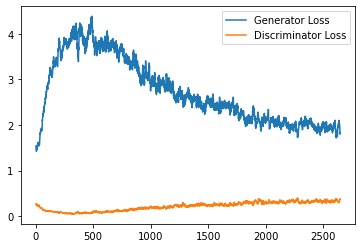

Step 53500: Generator loss: 1.8356588742733002, discriminator loss: 0.3631457980275151


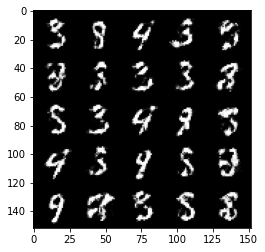

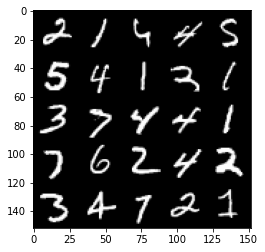

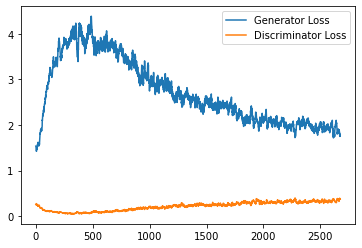

Step 54000: Generator loss: 1.8112556869983683, discriminator loss: 0.3613350210189823


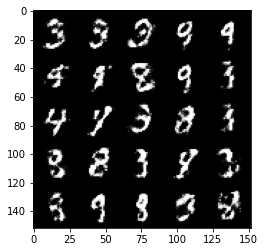

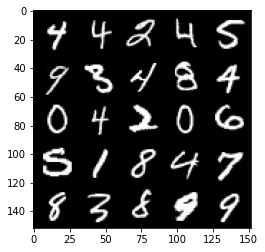

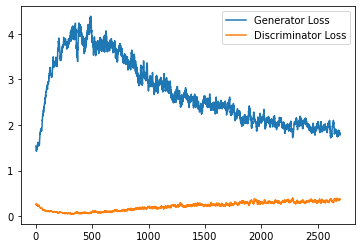

Step 54500: Generator loss: 1.8269629886150356, discriminator loss: 0.35373772823810595


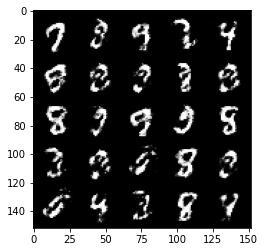

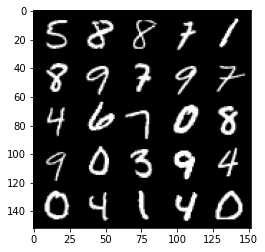

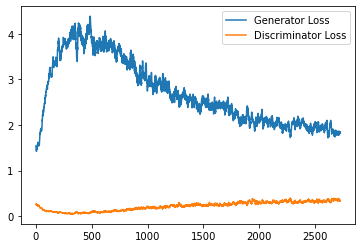

Step 55000: Generator loss: 1.900649058103561, discriminator loss: 0.3312722033262253


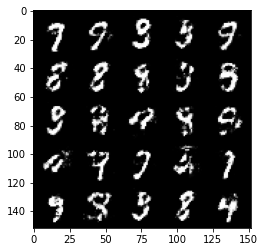

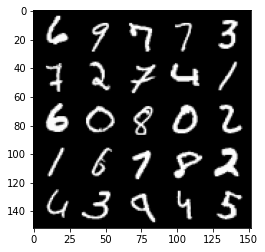

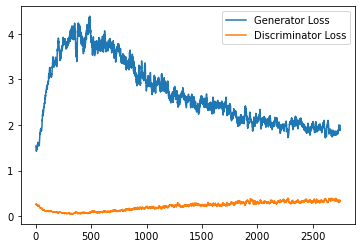

Step 55500: Generator loss: 1.8667271981239308, discriminator loss: 0.3519779149293902


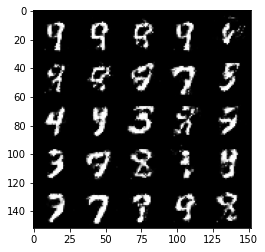

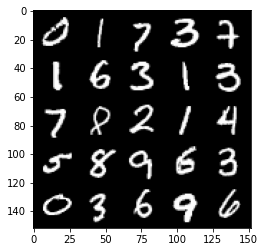

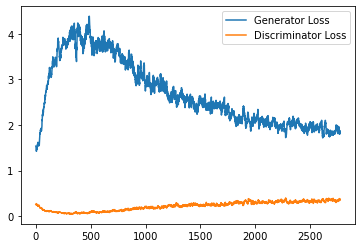

Step 56000: Generator loss: 1.8582168602943412, discriminator loss: 0.3452970169186592


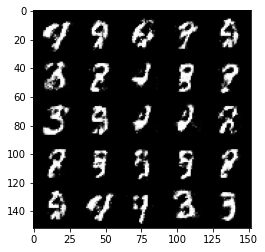

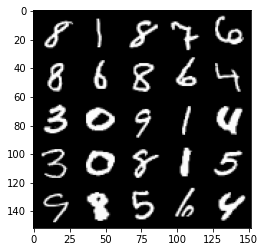

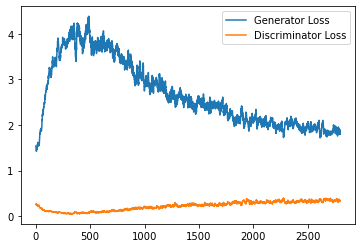

Step 56500: Generator loss: 1.8876492538452134, discriminator loss: 0.34072343304753294


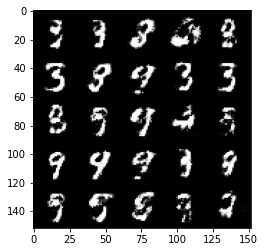

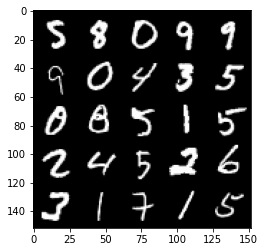

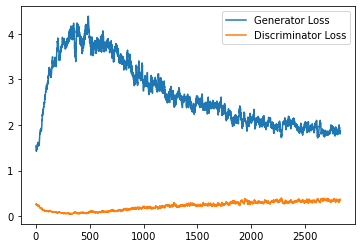

Step 57000: Generator loss: 1.7701380860805505, discriminator loss: 0.37451656353473656


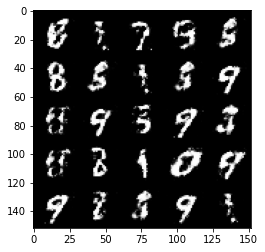

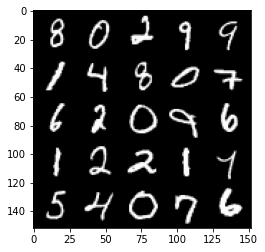

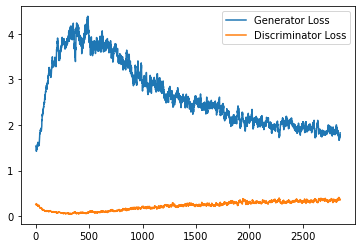

Step 57500: Generator loss: 1.7424965116977689, discriminator loss: 0.366050091266632


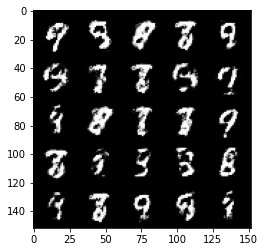

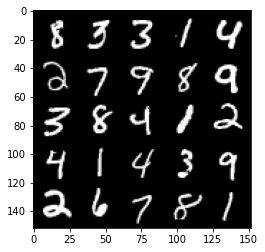

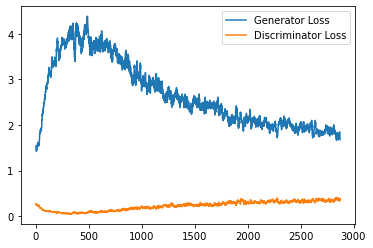

Step 58000: Generator loss: 1.7913493964672085, discriminator loss: 0.3356091536581515


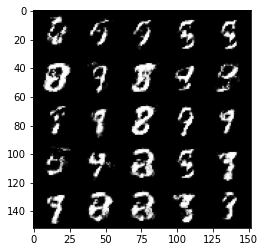

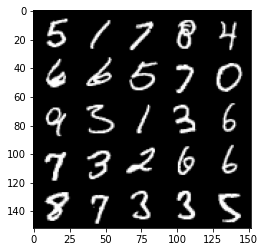

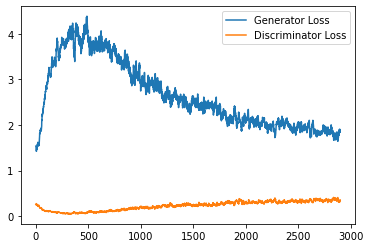

Step 58500: Generator loss: 1.8955744767189038, discriminator loss: 0.32836369091272327


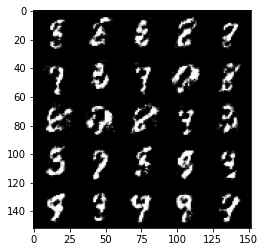

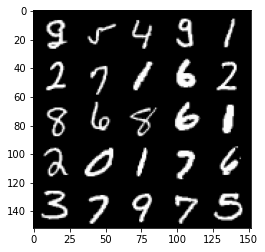

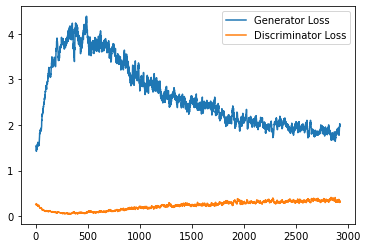

Step 59000: Generator loss: 1.9212961792945848, discriminator loss: 0.3335022122263908


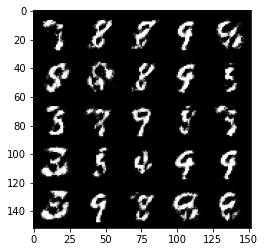

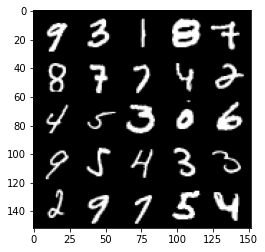

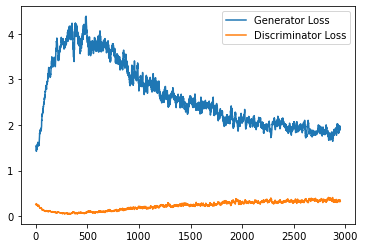

Step 59500: Generator loss: 1.9312146677970874, discriminator loss: 0.32404278478026377


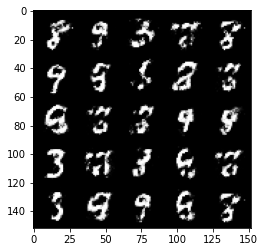

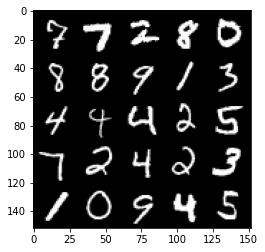

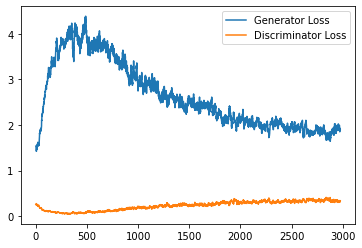

Step 60000: Generator loss: 1.9336431536674494, discriminator loss: 0.32256596636772117


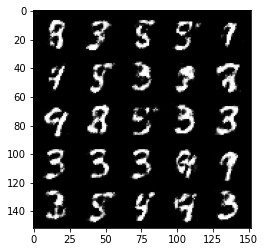

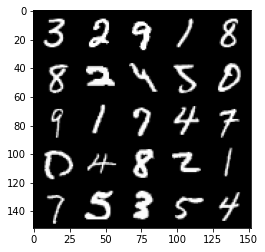

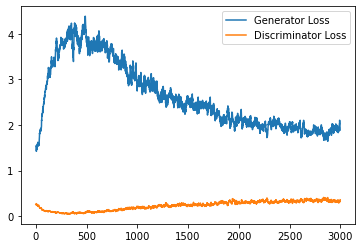

Step 60500: Generator loss: 1.7308817176818851, discriminator loss: 0.3754397578835485


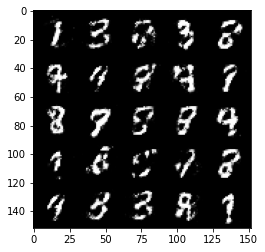

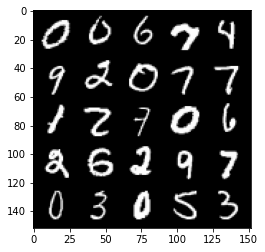

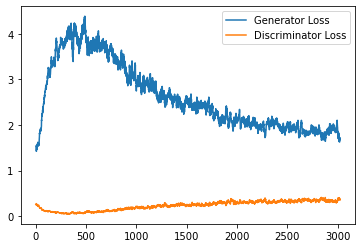

Step 61000: Generator loss: 1.6823371810913084, discriminator loss: 0.37980486094951615


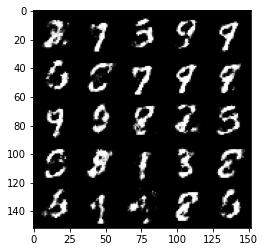

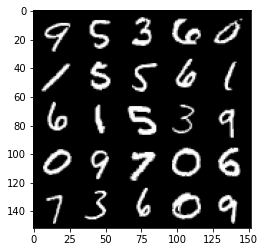

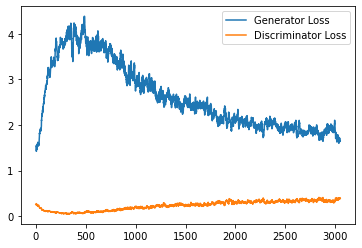

Step 61500: Generator loss: 1.7146248793601977, discriminator loss: 0.3664894907474519


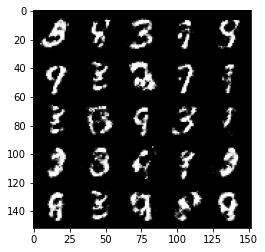

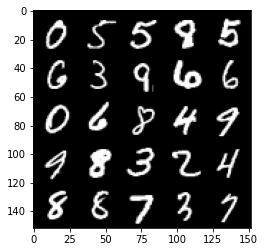

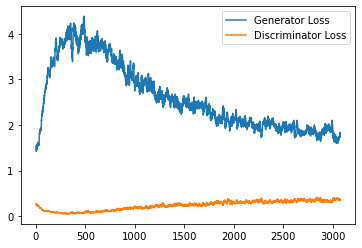

Step 62000: Generator loss: 1.6028620092868808, discriminator loss: 0.4143205775618549


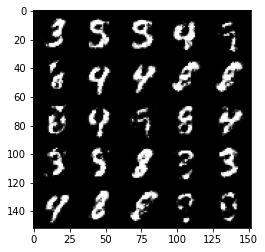

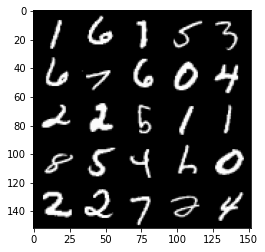

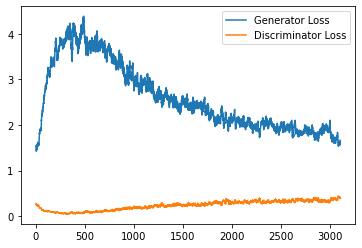

Step 62500: Generator loss: 1.6312062315940852, discriminator loss: 0.3907646744847295


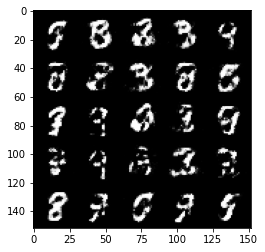

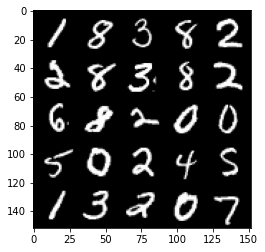

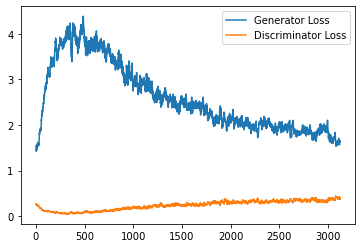

Step 63000: Generator loss: 1.7004743378162364, discriminator loss: 0.3805819089114664


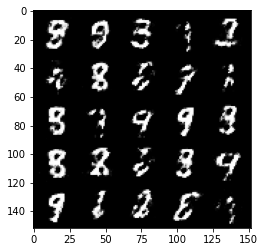

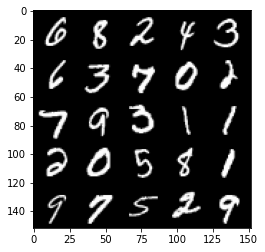

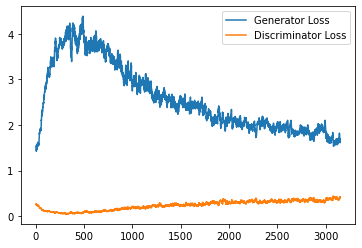

Step 63500: Generator loss: 1.614398695230483, discriminator loss: 0.3950344818234447


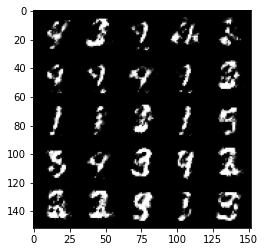

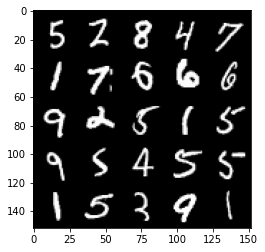

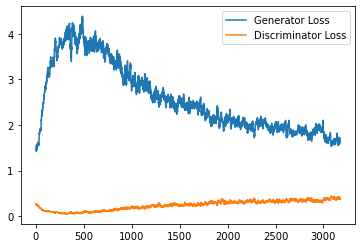

Step 64000: Generator loss: 1.6696360533237453, discriminator loss: 0.37941026037931463


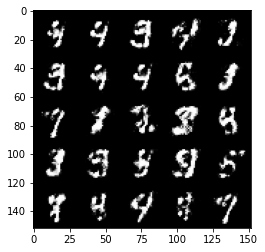

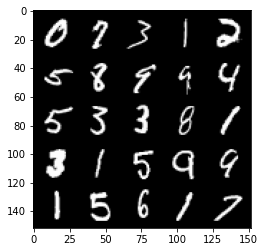

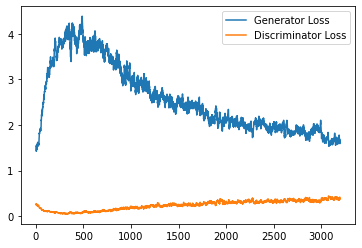

Step 64500: Generator loss: 1.6913937678337094, discriminator loss: 0.3815225240588189


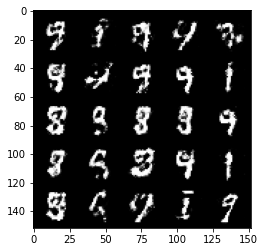

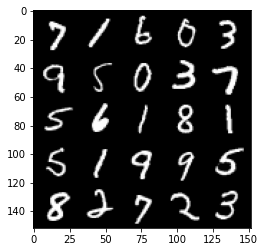

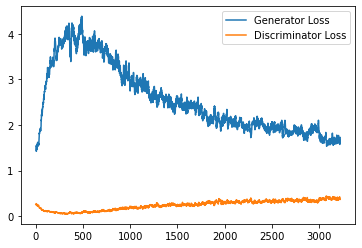

Step 65000: Generator loss: 1.7670252578258514, discriminator loss: 0.35948740732669854


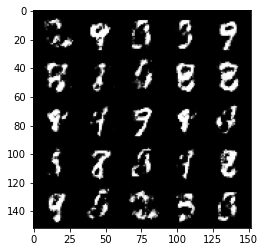

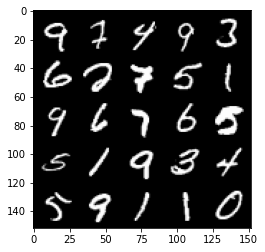

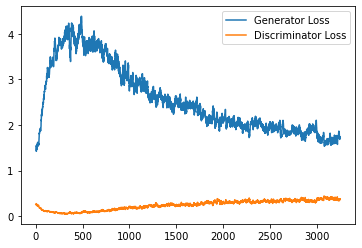

Step 65500: Generator loss: 1.739584646940232, discriminator loss: 0.3693027813434603


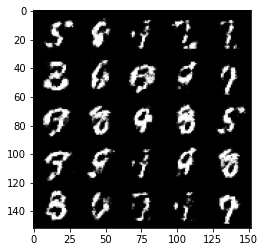

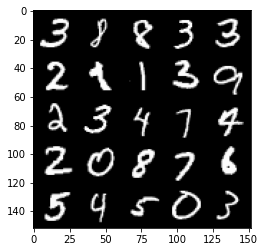

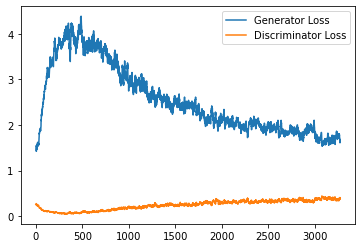

Step 66000: Generator loss: 1.800750615835189, discriminator loss: 0.3332388136386868


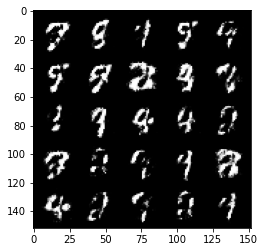

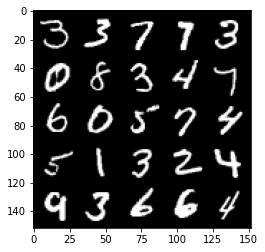

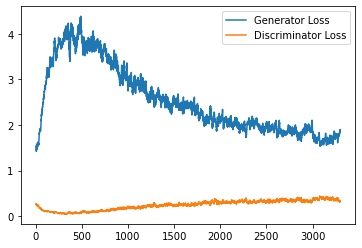

Step 66500: Generator loss: 1.7934371404647815, discriminator loss: 0.35329355576634397


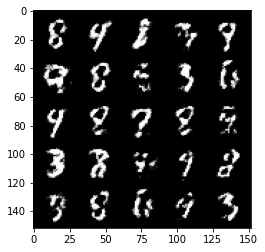

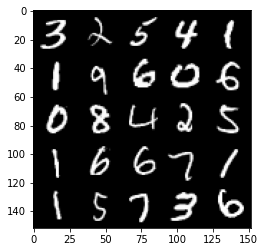

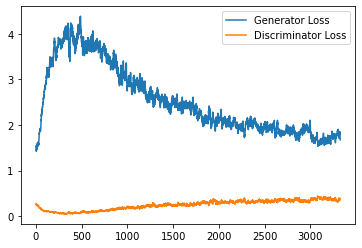

Step 67000: Generator loss: 1.698730370998382, discriminator loss: 0.3708776568472385


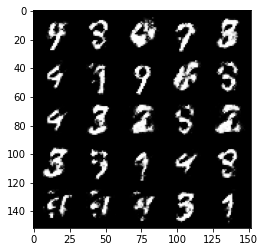

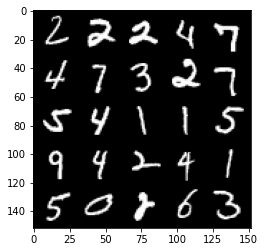

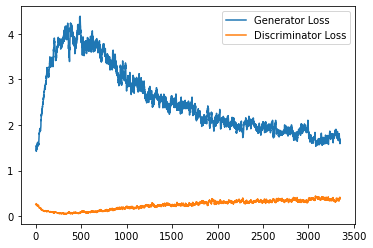

Step 67500: Generator loss: 1.671842498302459, discriminator loss: 0.38333926016092346


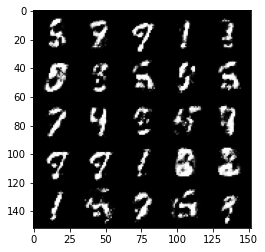

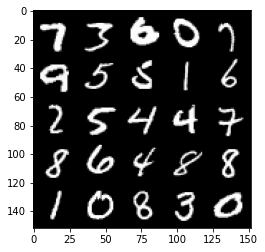

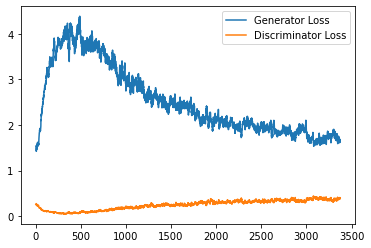

Step 68000: Generator loss: 1.7124131157398224, discriminator loss: 0.3803101099729536


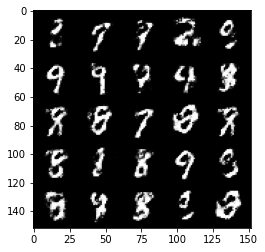

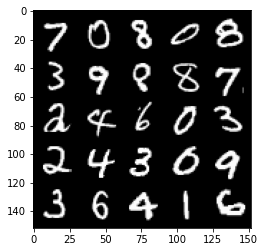

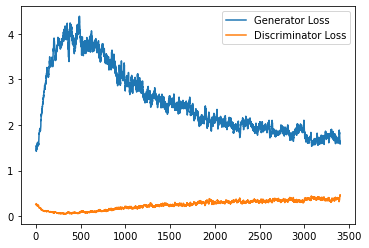

Step 68500: Generator loss: 1.6098206512928013, discriminator loss: 0.4052202056646347


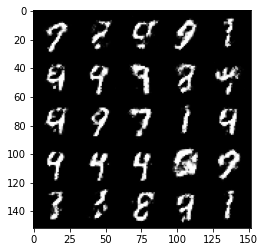

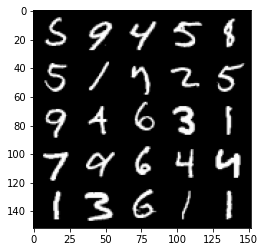

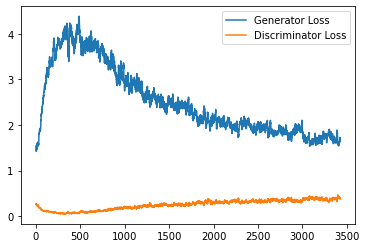

Step 69000: Generator loss: 1.6569712743759144, discriminator loss: 0.38497739219665517


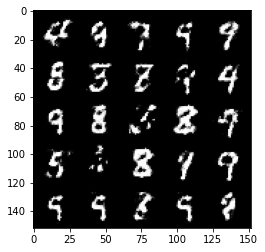

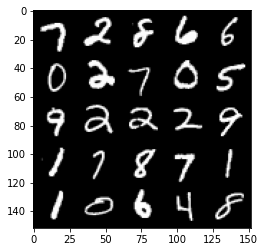

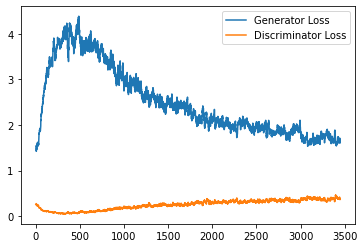

Step 69500: Generator loss: 1.6435032942295078, discriminator loss: 0.39320581233501456


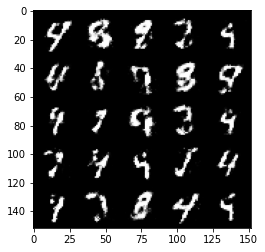

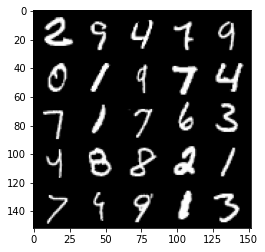

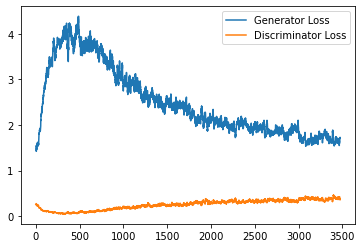

Step 70000: Generator loss: 1.6466416900157932, discriminator loss: 0.3887579191923144


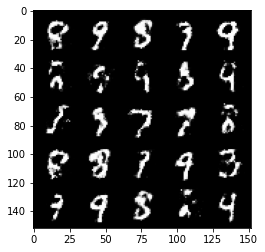

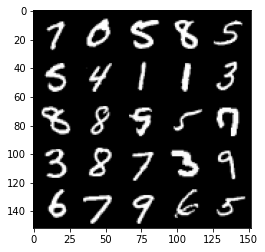

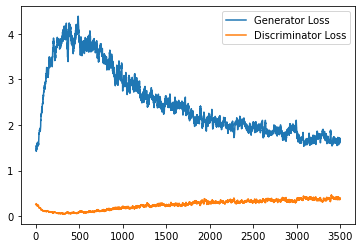

Step 70500: Generator loss: 1.6890059802532202, discriminator loss: 0.3817671852707862


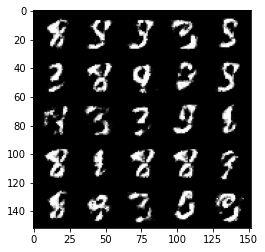

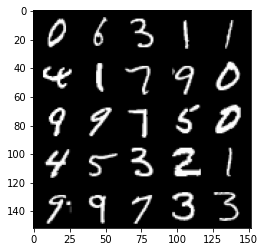

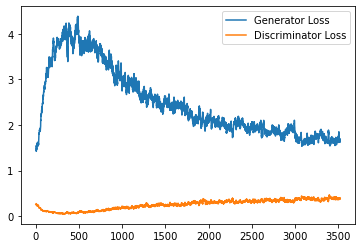

Step 71000: Generator loss: 1.6576478364467624, discriminator loss: 0.37979977369308476


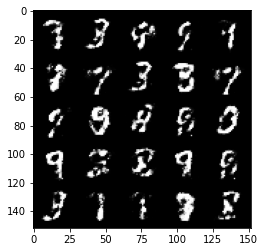

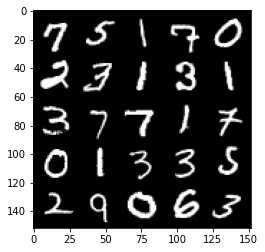

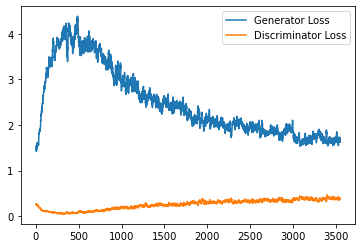

Step 71500: Generator loss: 1.664528774023055, discriminator loss: 0.38346275746822367


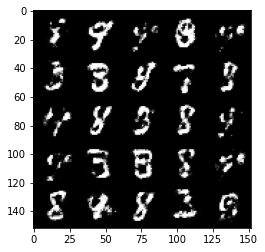

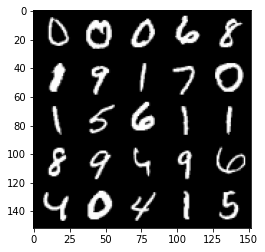

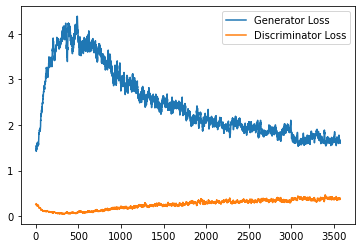

Step 72000: Generator loss: 1.54604379296303, discriminator loss: 0.41461334818601586


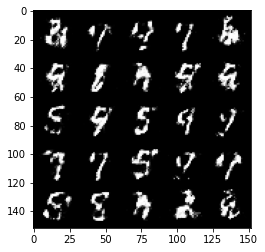

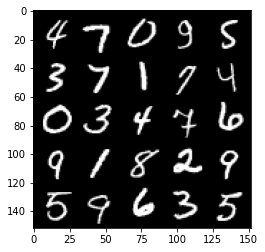

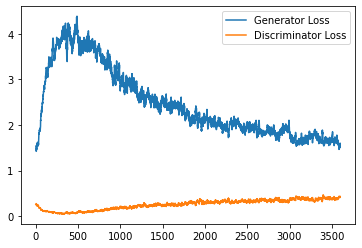

Step 72500: Generator loss: 1.5395847251415244, discriminator loss: 0.4211860355734829


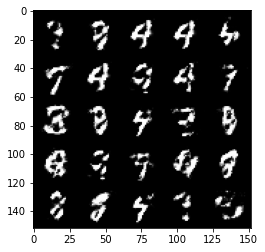

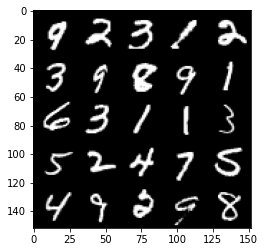

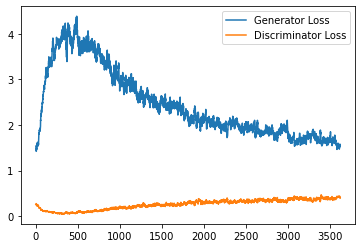

Step 73000: Generator loss: 1.5880176968574529, discriminator loss: 0.4023530606627468


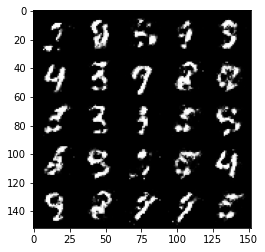

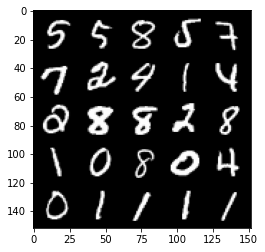

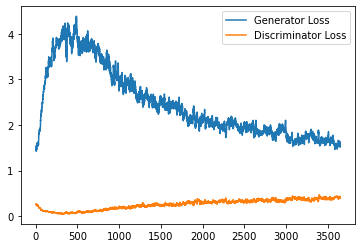

Step 73500: Generator loss: 1.5949231407642384, discriminator loss: 0.40381786924600627


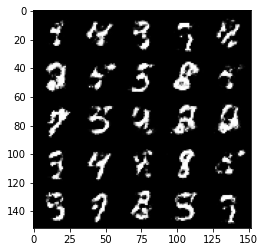

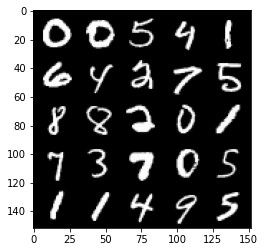

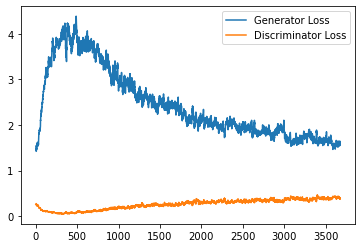

Step 74000: Generator loss: 1.5827401733398434, discriminator loss: 0.3975809843540187


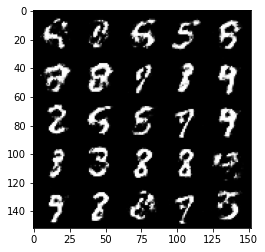

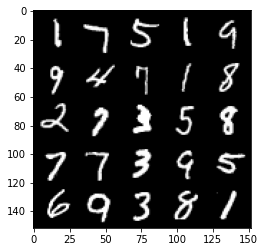

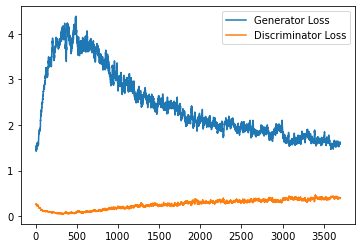

Step 74500: Generator loss: 1.575306012392044, discriminator loss: 0.40957119101285944


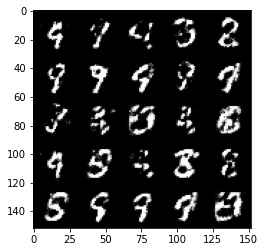

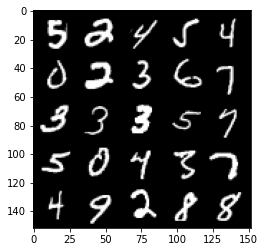

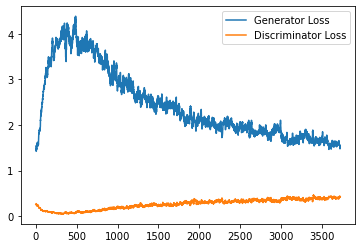

Step 75000: Generator loss: 1.5201597001552574, discriminator loss: 0.41620569229125987


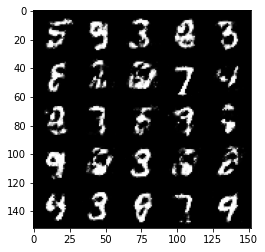

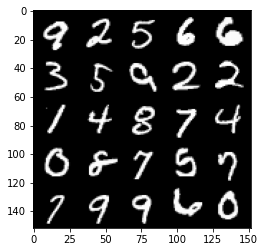

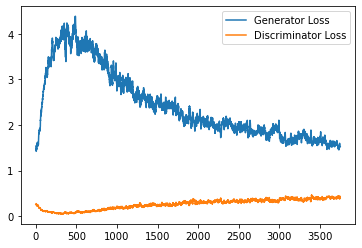

Step 75500: Generator loss: 1.5621463589668276, discriminator loss: 0.41003793811798045


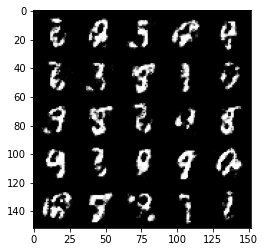

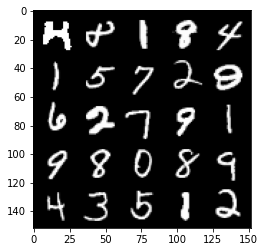

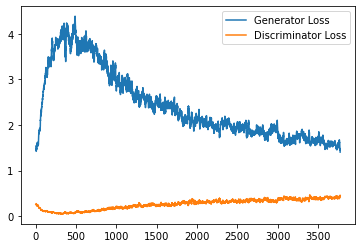

Step 76000: Generator loss: 1.4788468220233915, discriminator loss: 0.4188282490968701


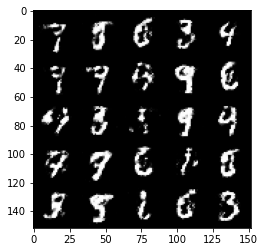

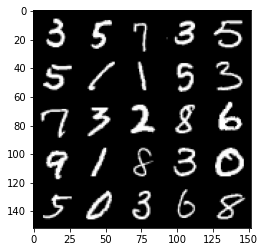

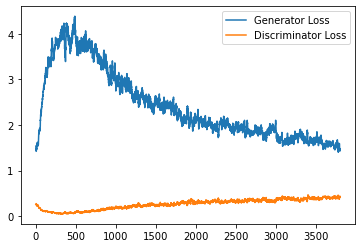

Step 76500: Generator loss: 1.5719154210090651, discriminator loss: 0.3905077365636822


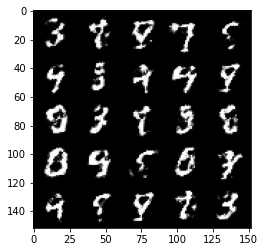

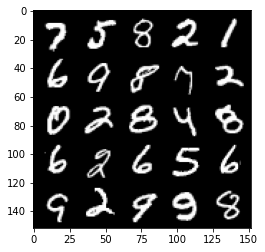

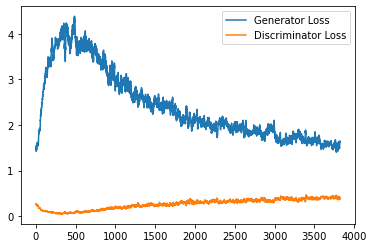

Step 77000: Generator loss: 1.5442642431259148, discriminator loss: 0.4036321533322329


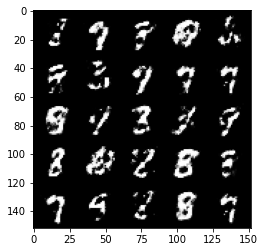

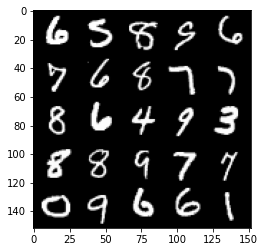

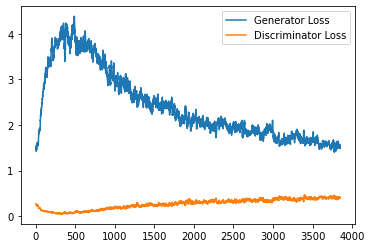

Step 77500: Generator loss: 1.4710899970531475, discriminator loss: 0.42366804534196845


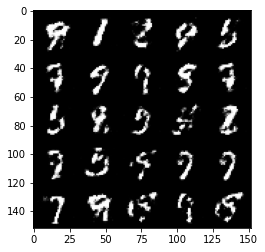

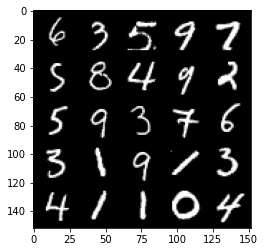

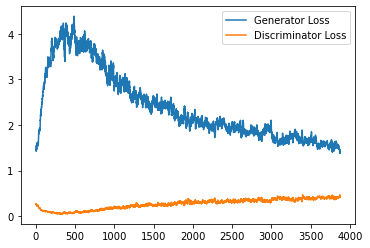

Step 78000: Generator loss: 1.4606638844013227, discriminator loss: 0.42228372228145616


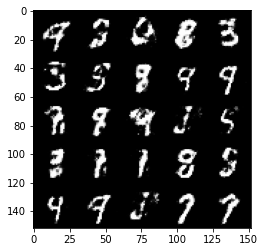

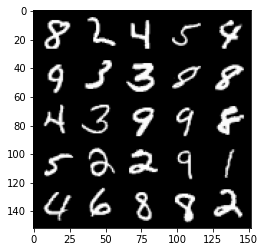

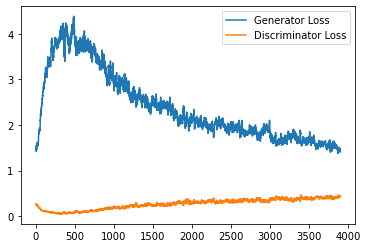

Step 78500: Generator loss: 1.410087579965592, discriminator loss: 0.4415612409710883


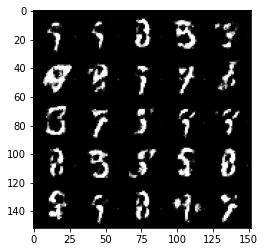

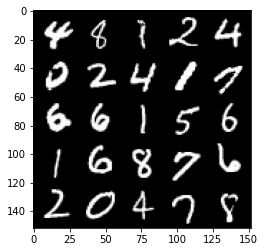

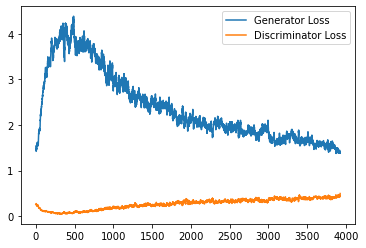

Step 79000: Generator loss: 1.3141944564580919, discriminator loss: 0.49739871227741217


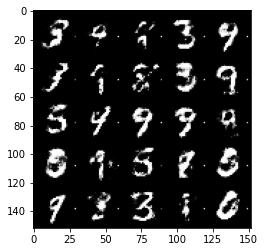

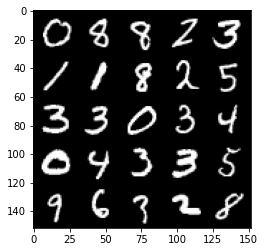

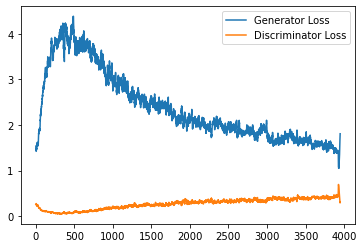

Step 79500: Generator loss: 1.7199284622669224, discriminator loss: 0.3527199135422707


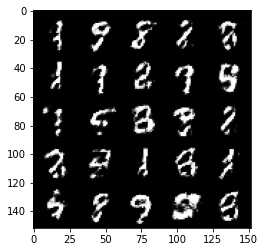

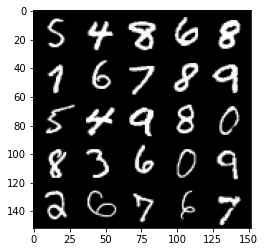

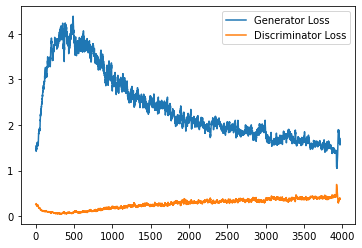

Step 80000: Generator loss: 1.629440478801728, discriminator loss: 0.37615014123916635


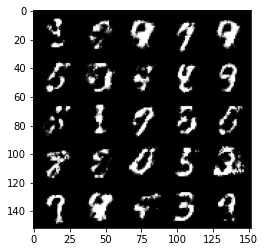

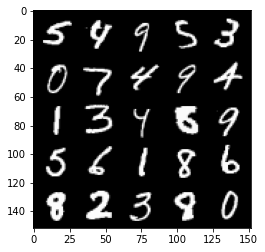

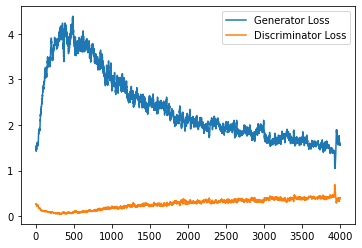

Step 80500: Generator loss: 1.6196879005432123, discriminator loss: 0.3793365369439129


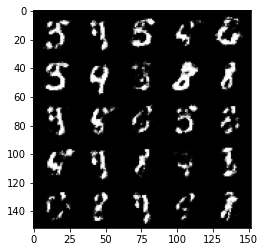

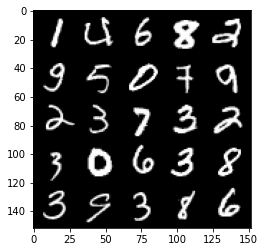

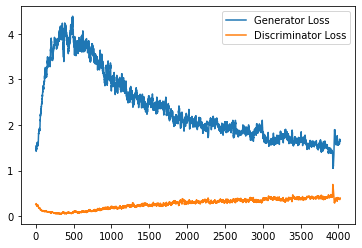

Step 81000: Generator loss: 1.5058220372200026, discriminator loss: 0.4213150224089621


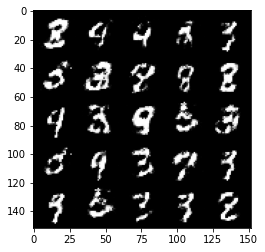

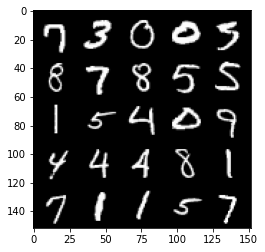

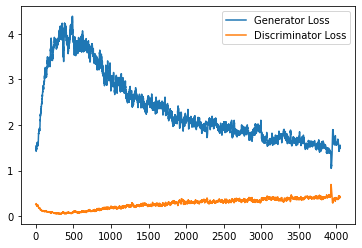

Step 81500: Generator loss: 1.495687955856322, discriminator loss: 0.41514978301525157


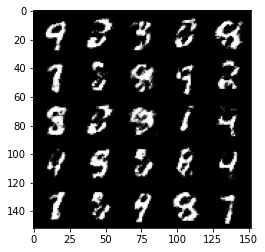

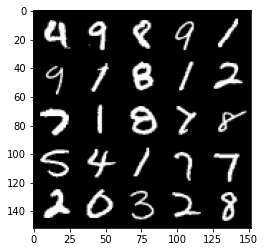

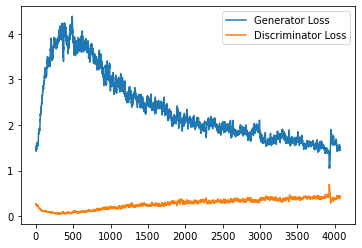

Step 82000: Generator loss: 1.4177840354442595, discriminator loss: 0.43959230160713203


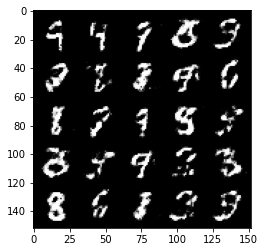

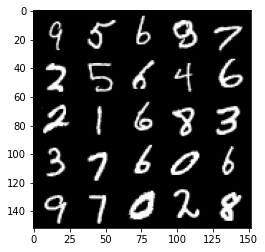

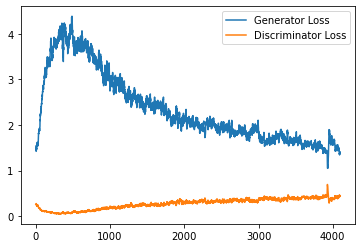

Step 82500: Generator loss: 1.4776552281379705, discriminator loss: 0.403998174011707


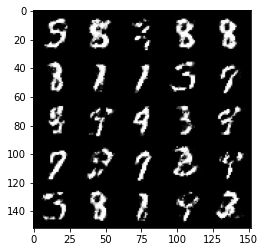

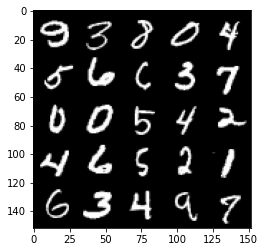

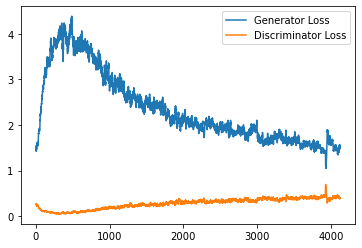

Step 83000: Generator loss: 1.4367591052055346, discriminator loss: 0.43007871323823926


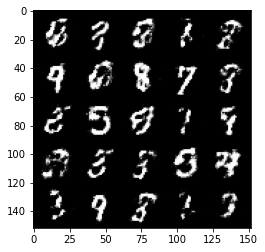

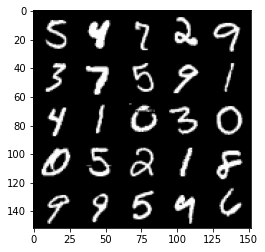

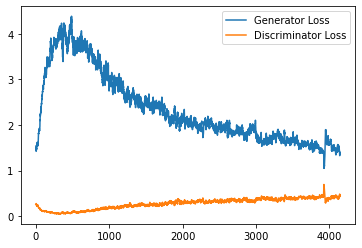

Step 83500: Generator loss: 1.4063333730697634, discriminator loss: 0.4487371797561643


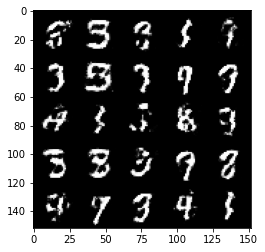

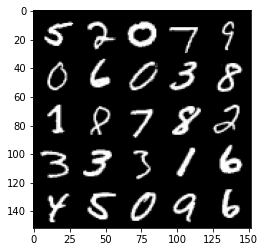

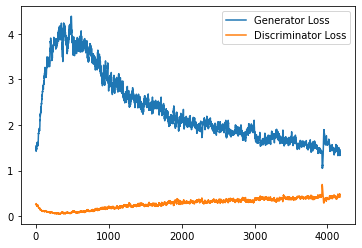

Step 84000: Generator loss: 1.486049461841582, discriminator loss: 0.42175151318311704


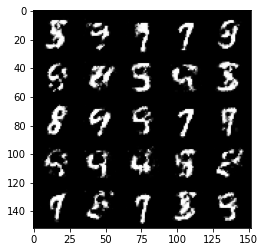

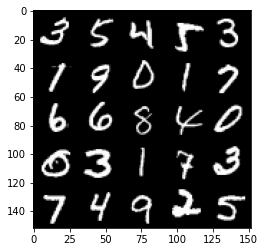

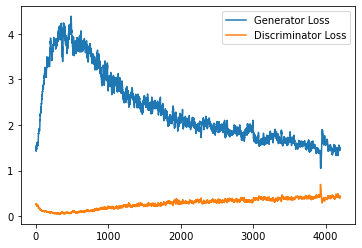

Step 84500: Generator loss: 1.4469858250617966, discriminator loss: 0.4317334797382358


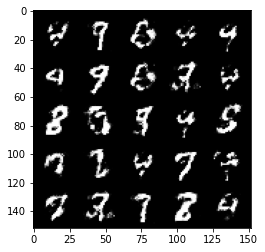

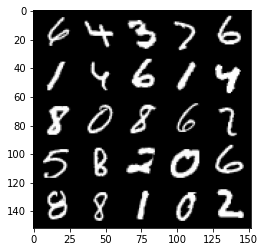

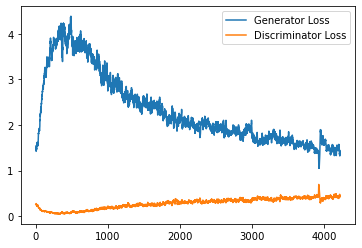

Step 85000: Generator loss: 1.4876436512470235, discriminator loss: 0.4190155006051061


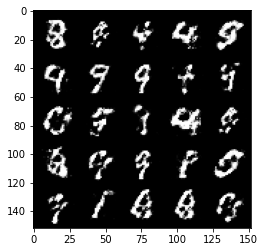

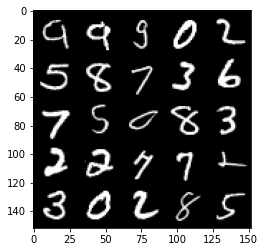

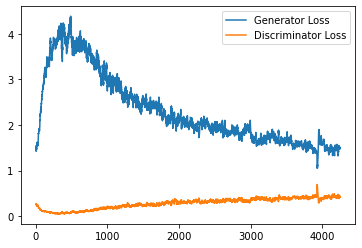

Step 85500: Generator loss: 1.5261754355430612, discriminator loss: 0.41023901289701475


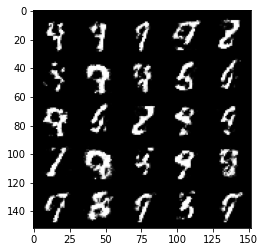

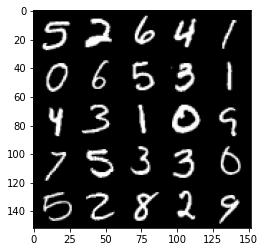

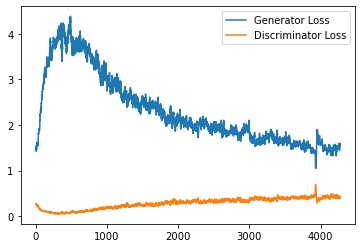

Step 86000: Generator loss: 1.431414300203323, discriminator loss: 0.4407593930363652


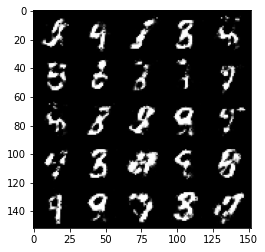

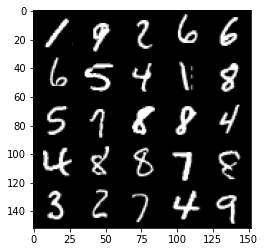

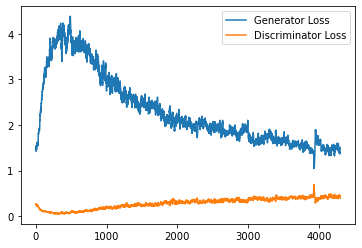

Step 86500: Generator loss: 1.4713587739467628, discriminator loss: 0.41432957100868273


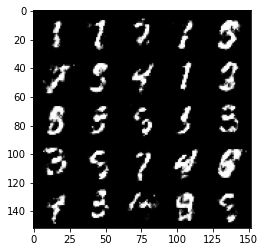

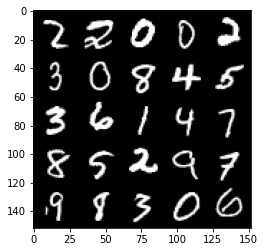

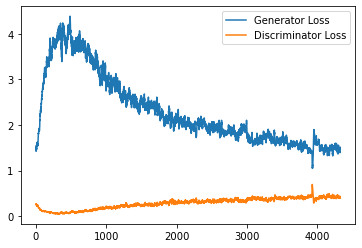

Step 87000: Generator loss: 1.4528959426879873, discriminator loss: 0.42123552960157384


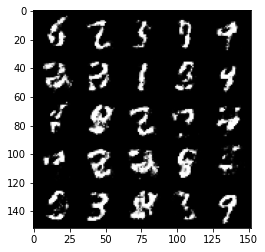

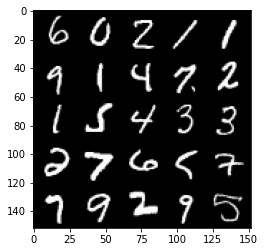

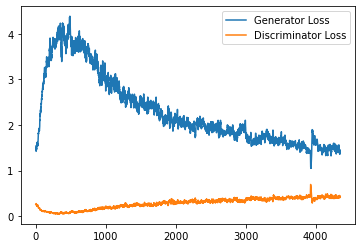

Step 87500: Generator loss: 1.5183628952503208, discriminator loss: 0.4175800541043279


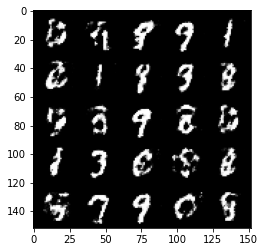

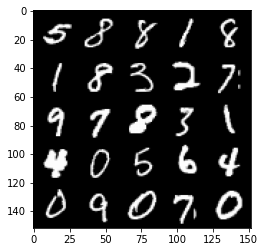

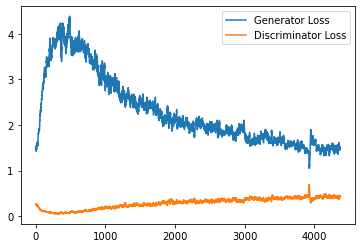

Step 88000: Generator loss: 1.4054356234073644, discriminator loss: 0.4457388240098952


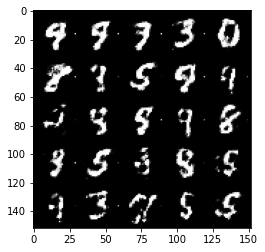

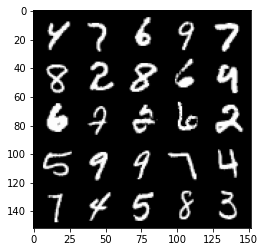

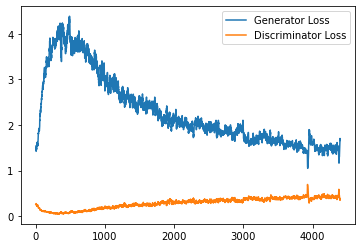

Step 88500: Generator loss: 1.4088530578613288, discriminator loss: 0.4627794448733329


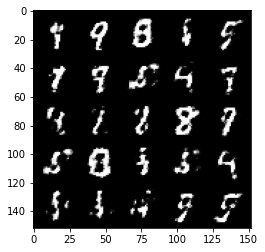

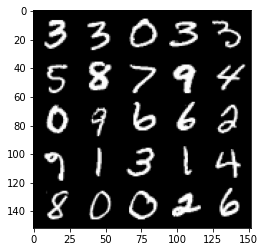

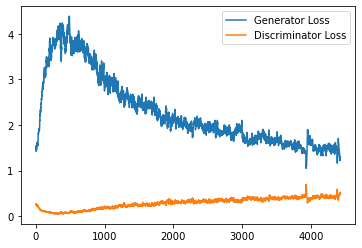

Step 89000: Generator loss: 1.3747812404632578, discriminator loss: 0.4517893751859667


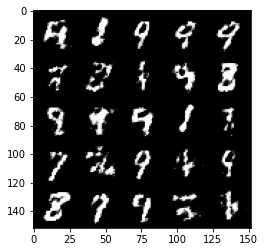

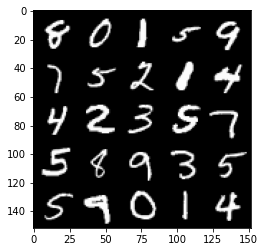

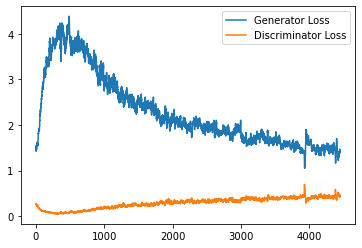

Step 89500: Generator loss: 1.4149788014888764, discriminator loss: 0.438455805718899


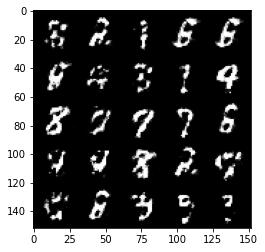

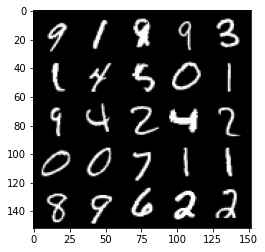

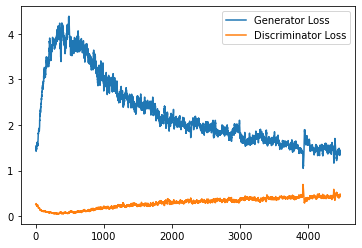

Step 90000: Generator loss: 1.3313482038974767, discriminator loss: 0.46360887211561236


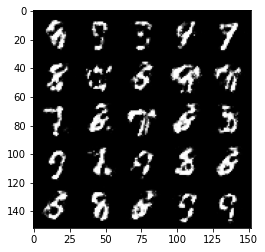

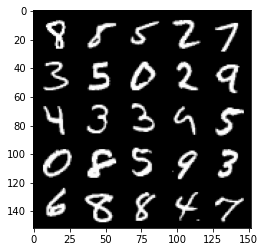

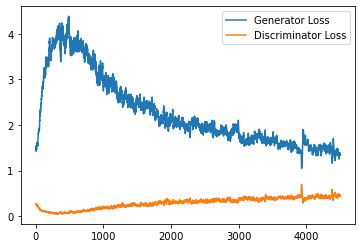

Step 90500: Generator loss: 1.3867258017063138, discriminator loss: 0.44206601917743693


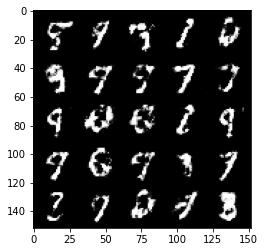

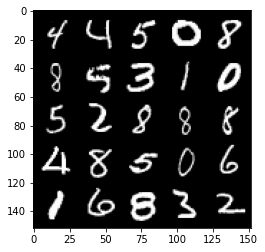

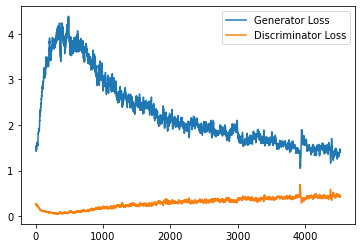

Step 91000: Generator loss: 1.433295247316362, discriminator loss: 0.4310590447187426


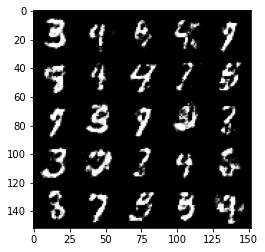

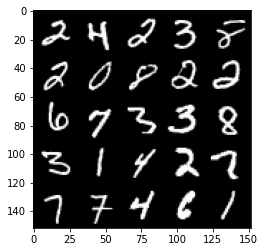

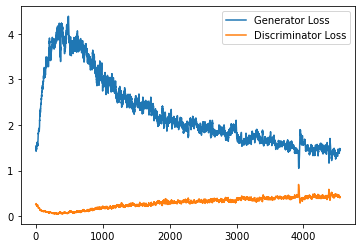

Step 91500: Generator loss: 1.4393682947158823, discriminator loss: 0.4349997352361683


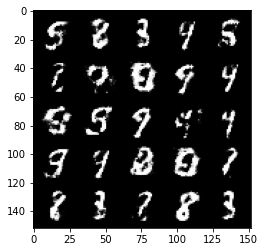

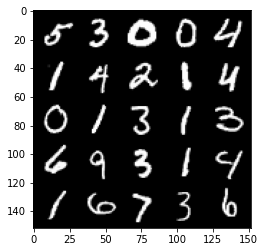

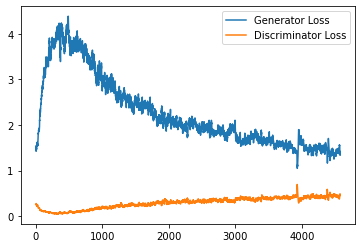

Step 92000: Generator loss: 1.4204412162303919, discriminator loss: 0.4304763212800024


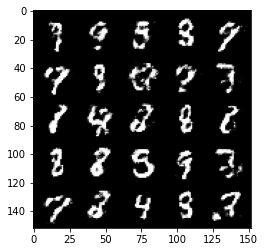

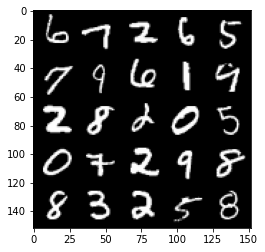

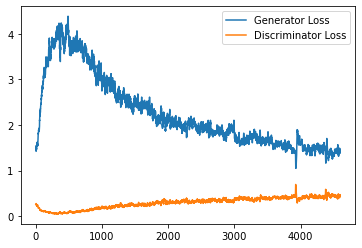

Step 92500: Generator loss: 1.4561295735836035, discriminator loss: 0.4221094393134118


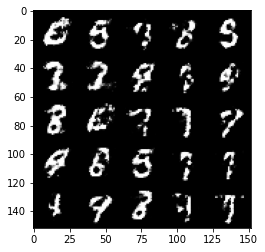

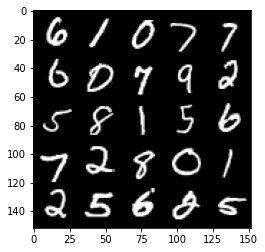

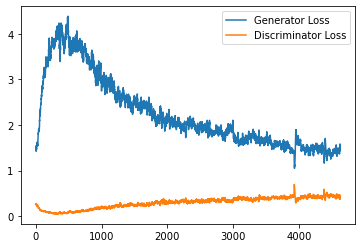

Step 93000: Generator loss: 1.4983461666107174, discriminator loss: 0.4155678146481515


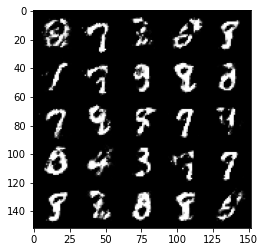

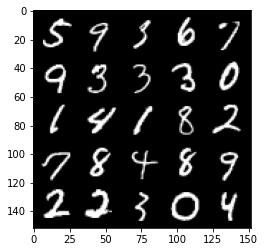

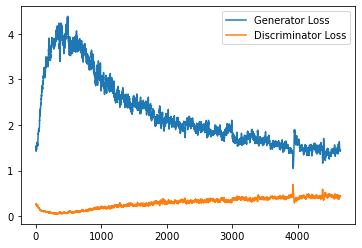

Step 93500: Generator loss: 1.3926796405315398, discriminator loss: 0.44458987134695094


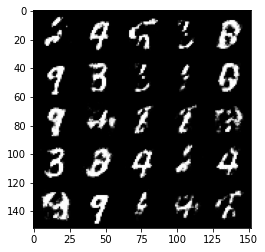

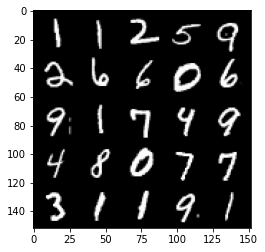

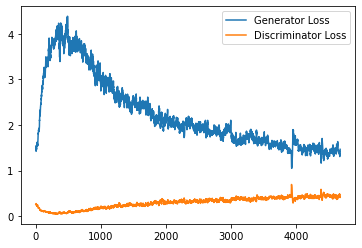

Step 94000: Generator loss: 1.4093470711708074, discriminator loss: 0.44056812238693216


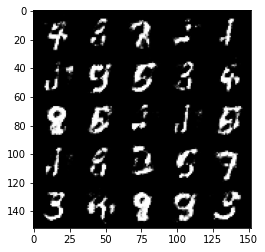

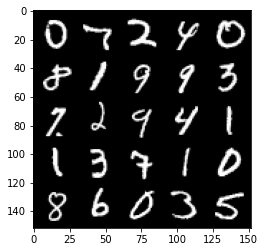

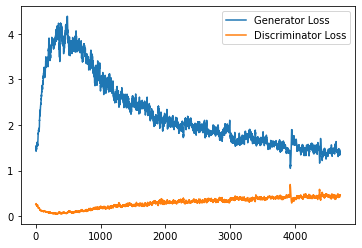

Step 94500: Generator loss: 1.3185372717380521, discriminator loss: 0.46096775519847877


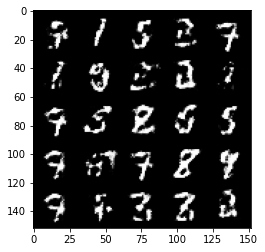

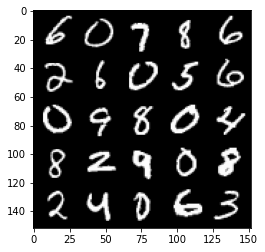

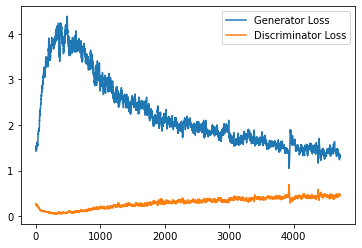

Step 95000: Generator loss: 1.423505189895629, discriminator loss: 0.4240951535105709


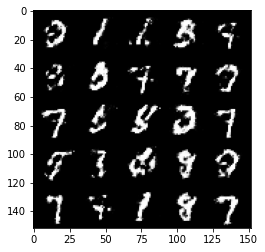

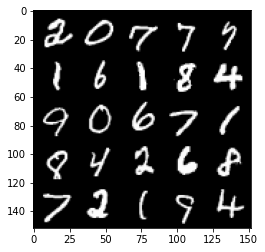

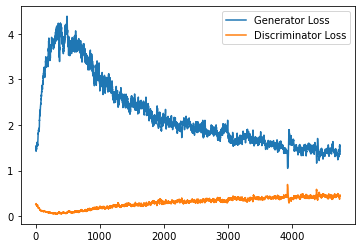

Step 95500: Generator loss: 1.4278207218647003, discriminator loss: 0.4328982349038125


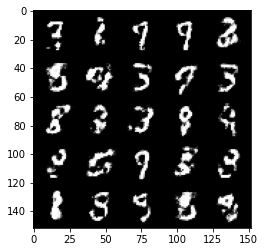

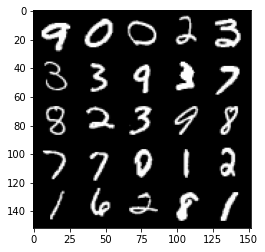

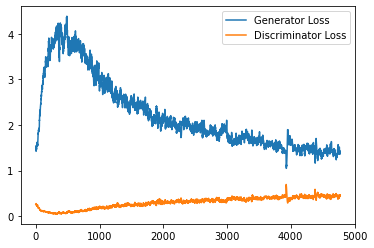

Step 96000: Generator loss: 1.43177005314827, discriminator loss: 0.44284567809104897


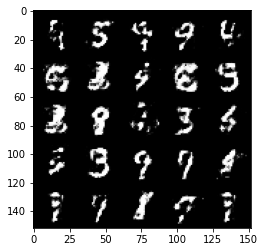

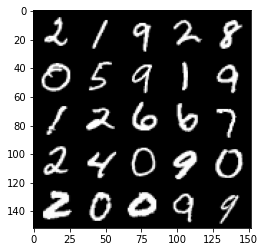

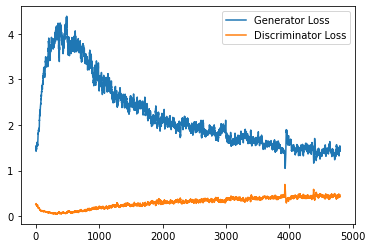

Step 96500: Generator loss: 1.385189695596695, discriminator loss: 0.4509194452166558


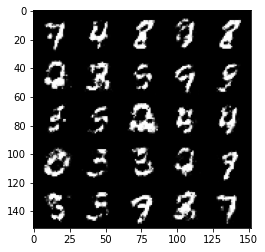

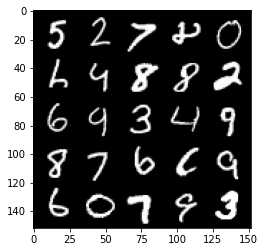

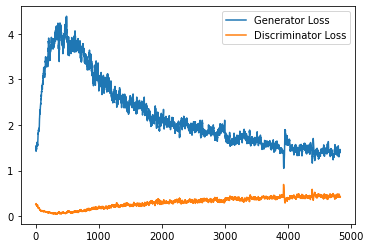

Step 97000: Generator loss: 1.3892022364139551, discriminator loss: 0.44257154774665836


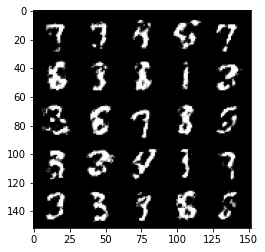

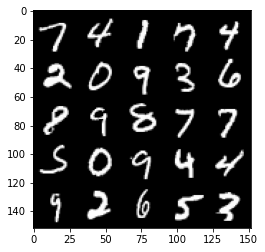

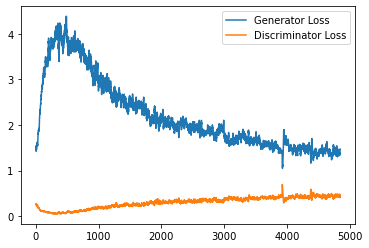

Step 97500: Generator loss: 1.4306418704986577, discriminator loss: 0.43846537196636237


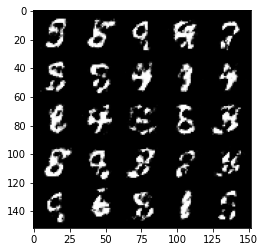

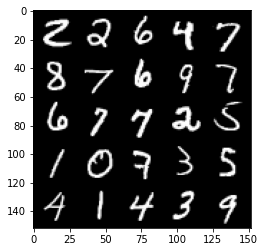

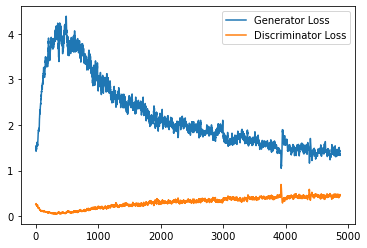

Step 98000: Generator loss: 1.4501456782817832, discriminator loss: 0.4264824543595313


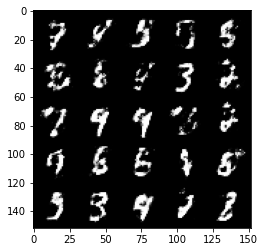

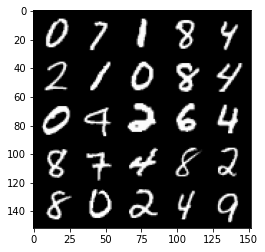

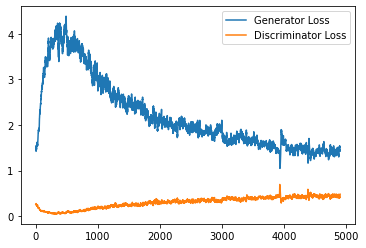

Step 98500: Generator loss: 1.3792023634910586, discriminator loss: 0.4339703345894808


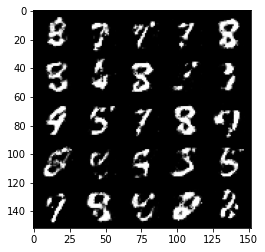

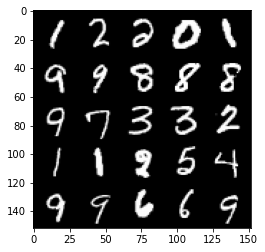

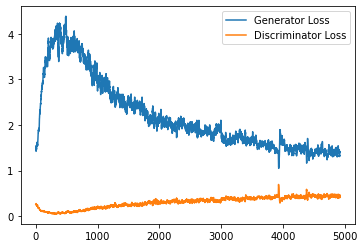

Step 99000: Generator loss: 1.3588746659755702, discriminator loss: 0.4441645727157593


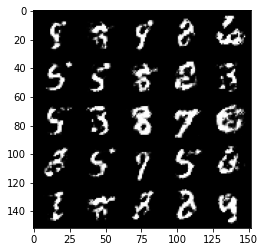

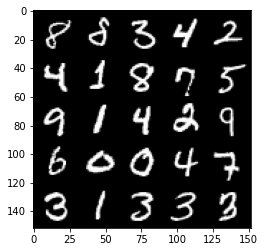

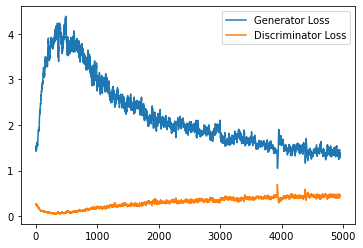

Step 99500: Generator loss: 1.305436882257462, discriminator loss: 0.46696292936801925


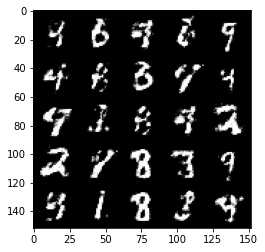

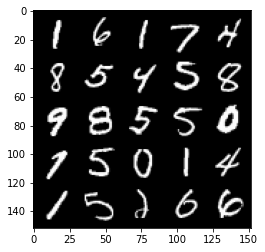

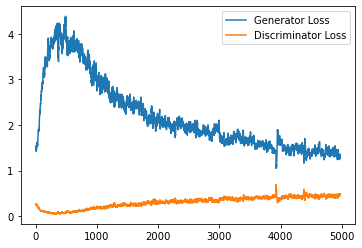

Step 100000: Generator loss: 1.2842104768753047, discriminator loss: 0.47921880137920364


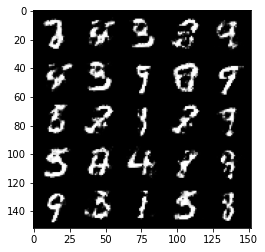

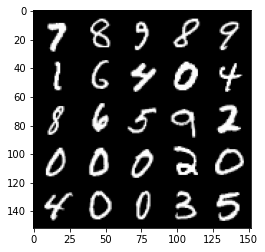

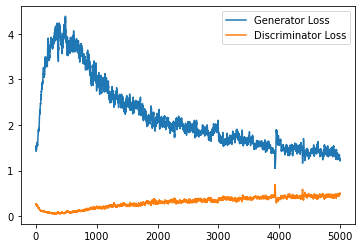

Step 100500: Generator loss: 1.257024091243743, discriminator loss: 0.4826137691140171


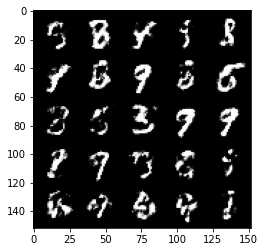

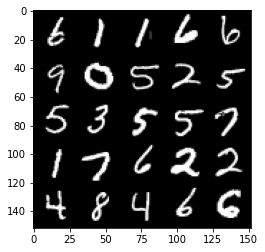

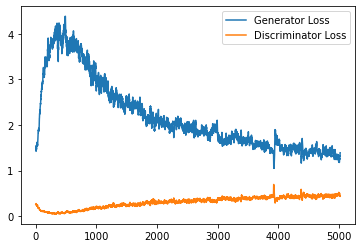

Step 101000: Generator loss: 1.321478950023652, discriminator loss: 0.4611188471317293


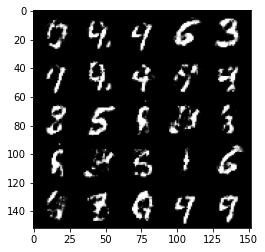

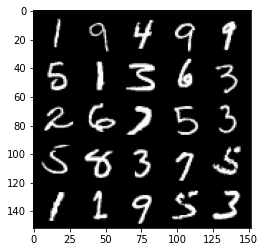

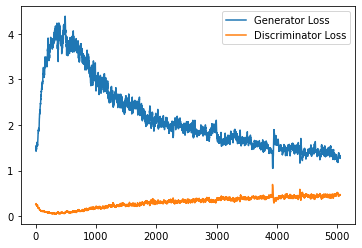

Step 101500: Generator loss: 1.2342989335060122, discriminator loss: 0.4813189335465435


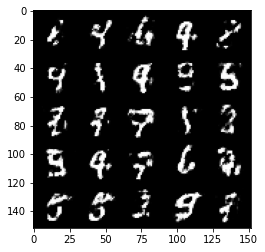

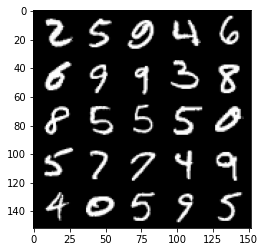

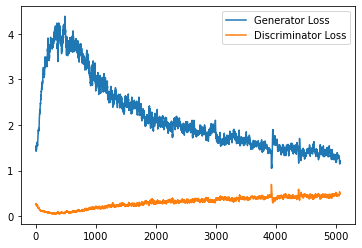

Step 102000: Generator loss: 1.2730577647686012, discriminator loss: 0.46879155296087266


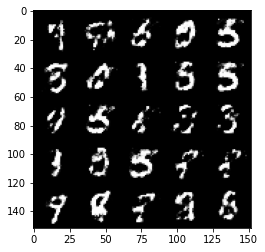

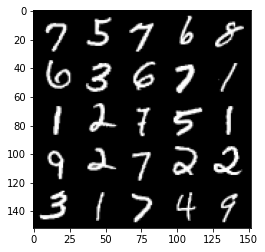

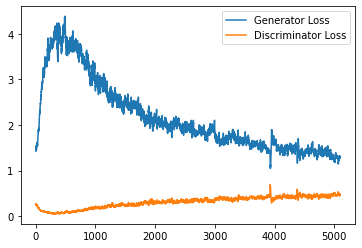

Step 102500: Generator loss: 1.2648326973915092, discriminator loss: 0.4847860326766966


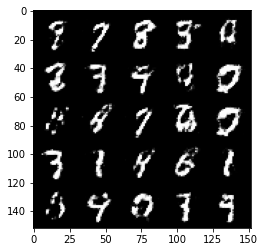

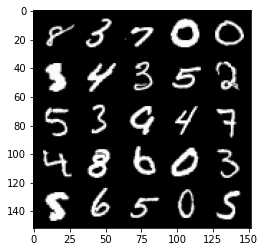

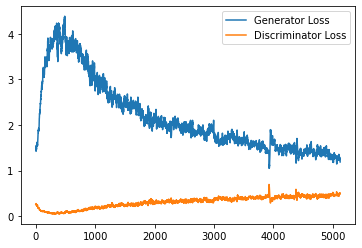

Step 103000: Generator loss: 1.2412858362197872, discriminator loss: 0.4872933403253556


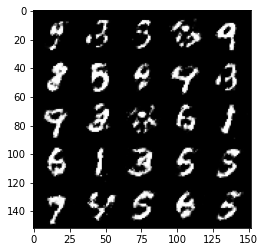

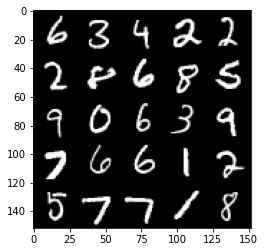

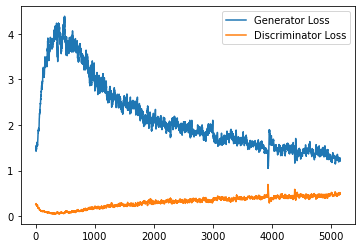

Step 103500: Generator loss: 1.1876940687894812, discriminator loss: 0.5042887178659435


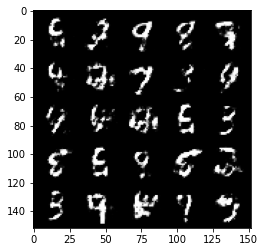

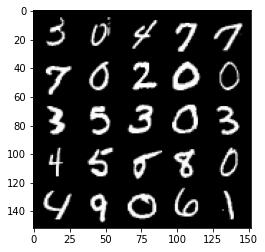

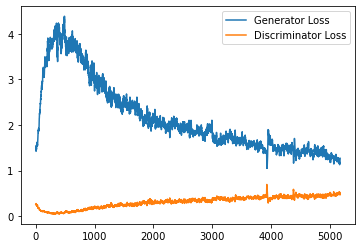

Step 104000: Generator loss: 1.1726720187664033, discriminator loss: 0.5054072275161743


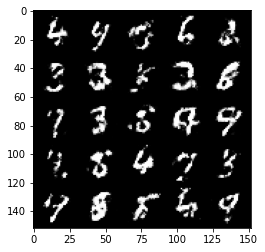

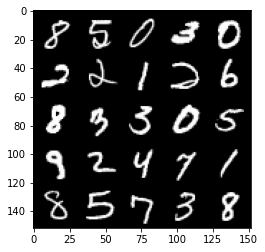

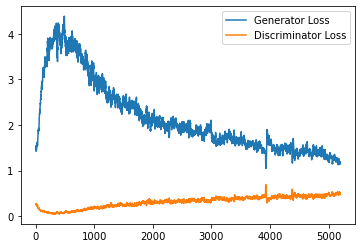

Step 104500: Generator loss: 1.229029468297959, discriminator loss: 0.48218827557563726


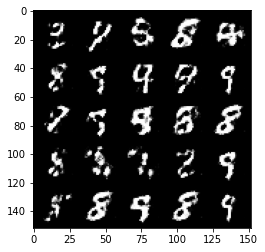

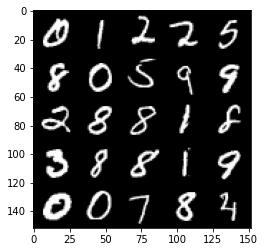

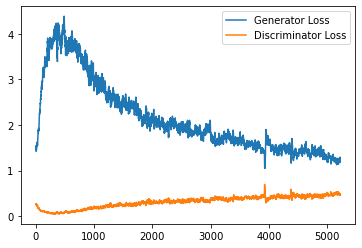

Step 105000: Generator loss: 1.2499270348548879, discriminator loss: 0.4810001903772354


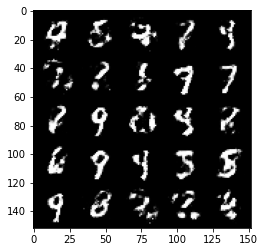

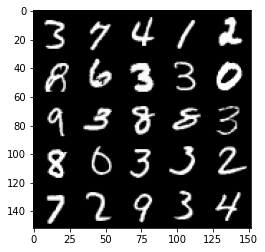

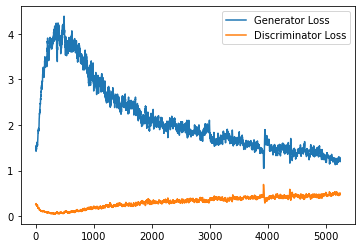

Step 105500: Generator loss: 1.3049384093284615, discriminator loss: 0.4665397316217426


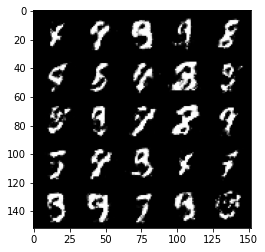

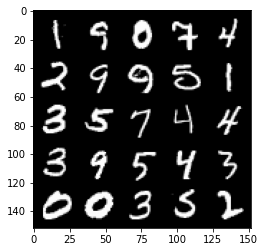

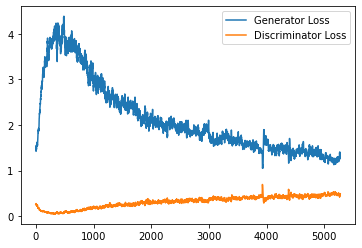

Step 106000: Generator loss: 1.2589500756263734, discriminator loss: 0.47703547322750117


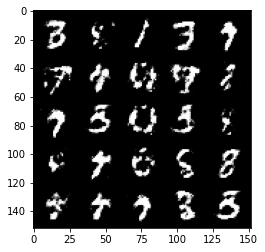

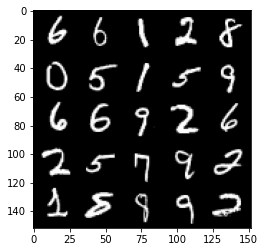

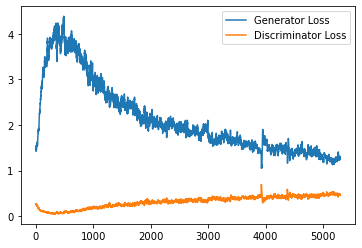

Step 106500: Generator loss: 1.377006223201752, discriminator loss: 0.43552105057239554


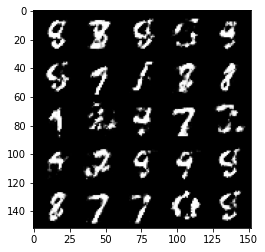

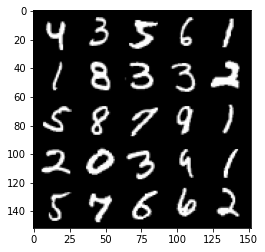

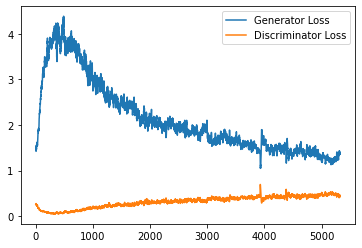

Step 107000: Generator loss: 1.3734288446903233, discriminator loss: 0.4480066459178923


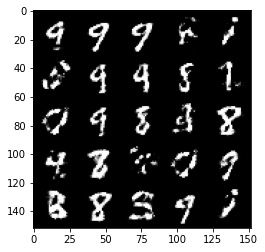

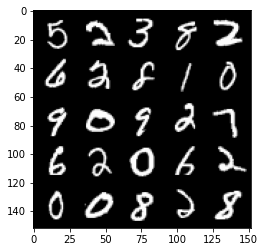

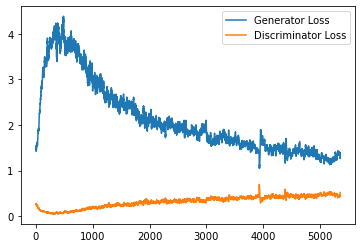

Step 107500: Generator loss: 1.2960000615119938, discriminator loss: 0.4709403908848759


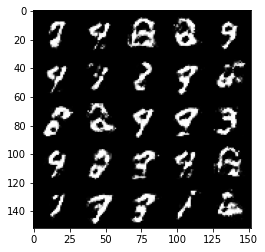

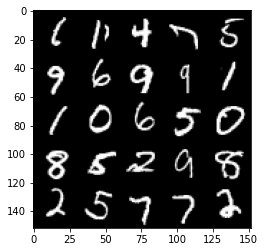

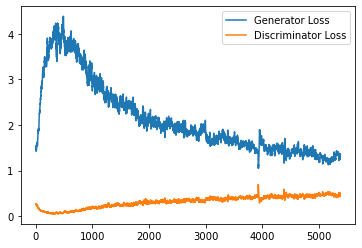

Step 108000: Generator loss: 1.4029167785644527, discriminator loss: 0.44547404378652555


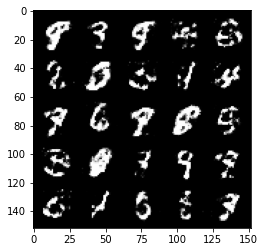

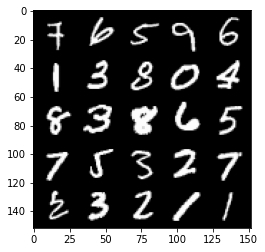

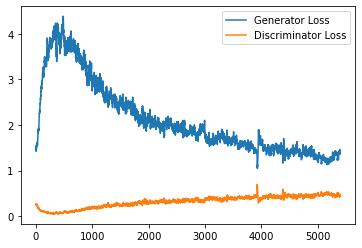

Step 108500: Generator loss: 1.3441546204090122, discriminator loss: 0.45278158396482454


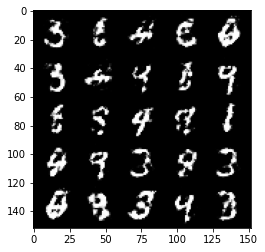

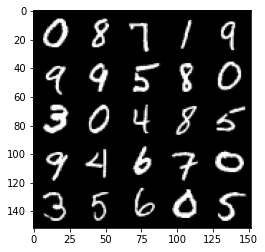

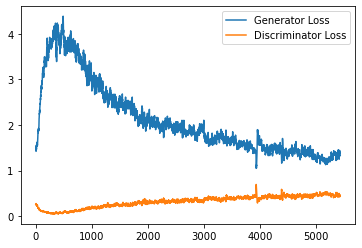

Step 109000: Generator loss: 1.3236443886756897, discriminator loss: 0.45002733063697786


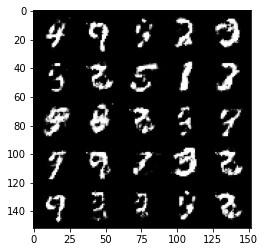

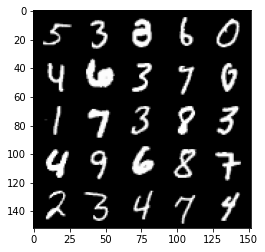

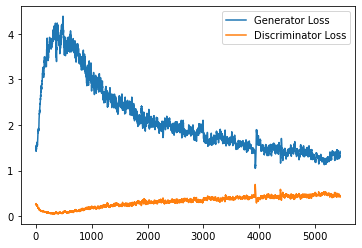

Step 109500: Generator loss: 1.3620652050971993, discriminator loss: 0.4383263997435567


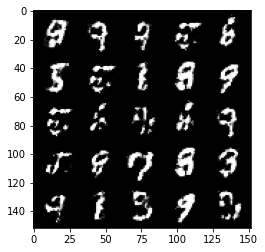

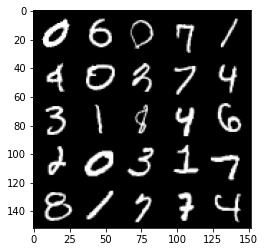

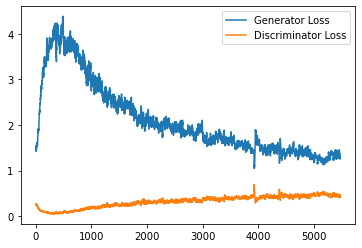

Step 110000: Generator loss: 1.425760756254196, discriminator loss: 0.41554905802011477


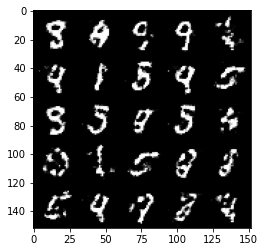

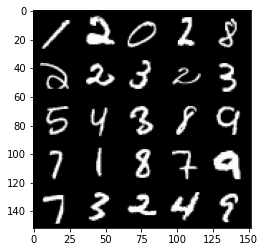

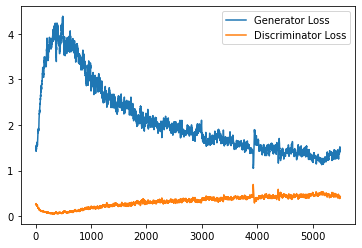

Step 110500: Generator loss: 1.4006794550418855, discriminator loss: 0.43653986114263527


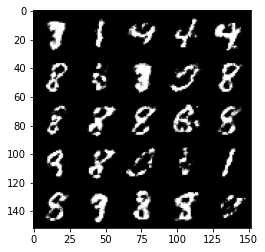

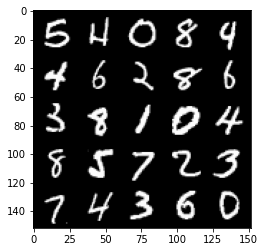

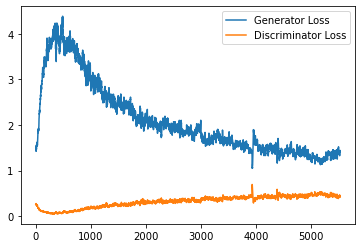

Step 111000: Generator loss: 1.413246845960618, discriminator loss: 0.4278201808929443


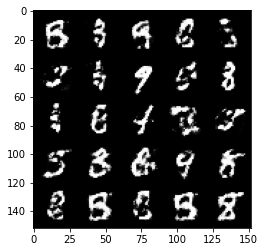

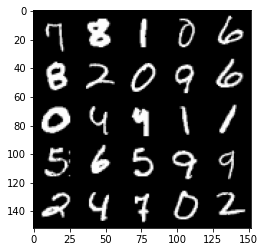

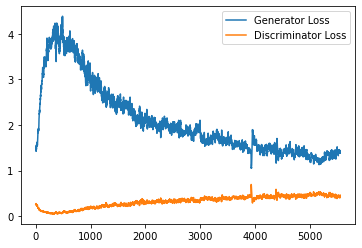

Step 111500: Generator loss: 1.3613704650402074, discriminator loss: 0.44218502509593977


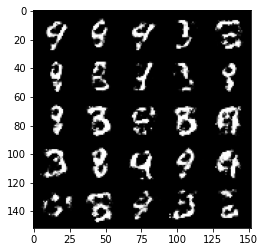

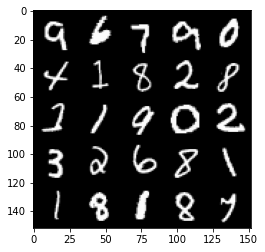

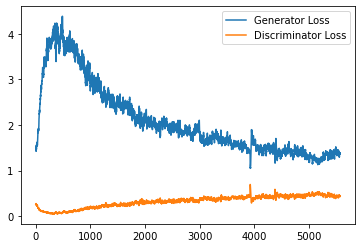

Step 112000: Generator loss: 1.2786185946464534, discriminator loss: 0.46996555066108747


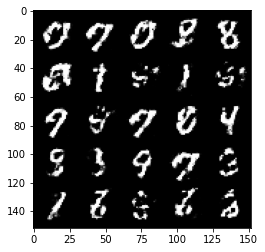

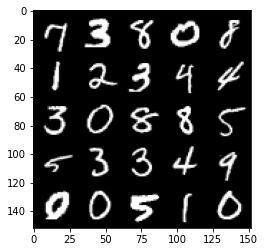

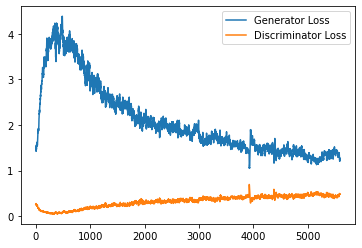

Step 112500: Generator loss: 1.3541964409351344, discriminator loss: 0.45009680008888237


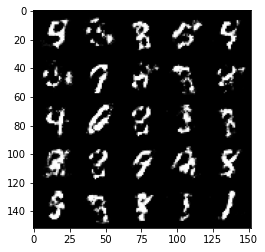

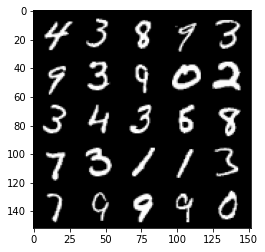

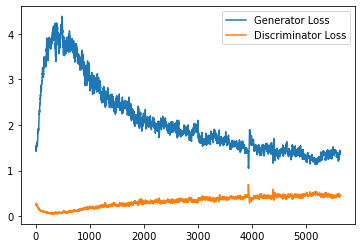

Step 113000: Generator loss: 1.2622173409461983, discriminator loss: 0.4873537577986722


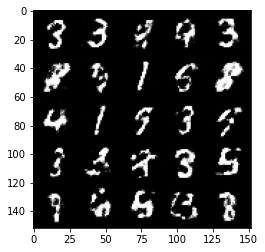

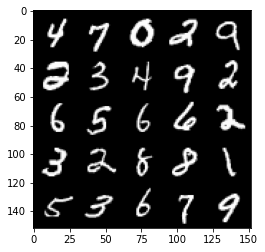

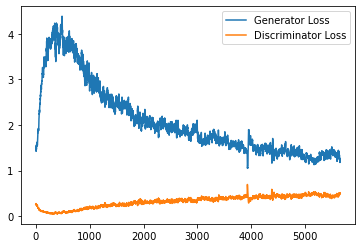

Step 113500: Generator loss: 1.2707706239223475, discriminator loss: 0.47556454932689685


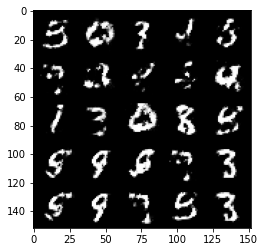

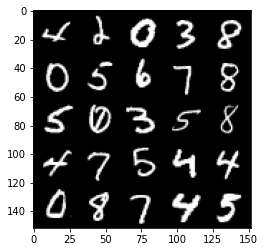

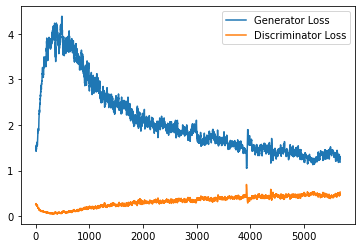

Step 114000: Generator loss: 1.1527926784753808, discriminator loss: 0.5186445292830463


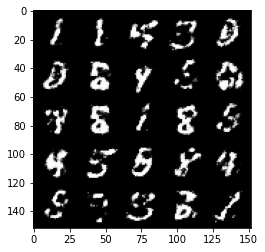

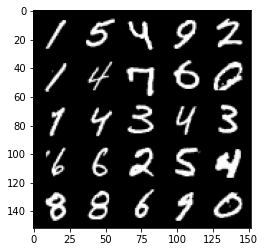

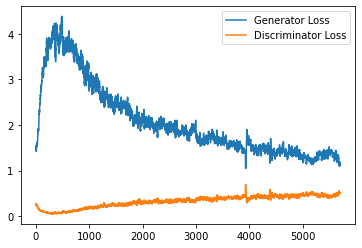

Step 114500: Generator loss: 1.2274243972301495, discriminator loss: 0.4799491010904314


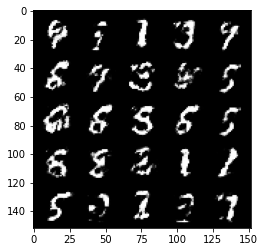

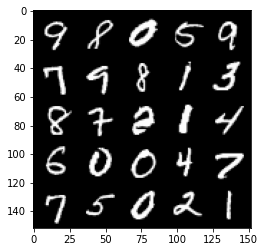

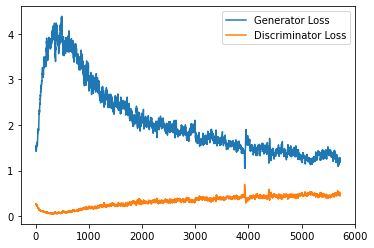

Step 115000: Generator loss: 1.3436694798469542, discriminator loss: 0.45483880889415745


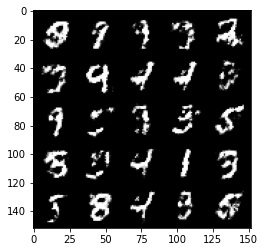

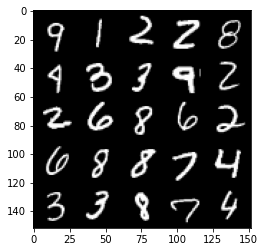

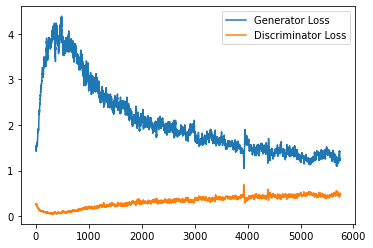

Step 115500: Generator loss: 1.251391063451767, discriminator loss: 0.4816324477791787


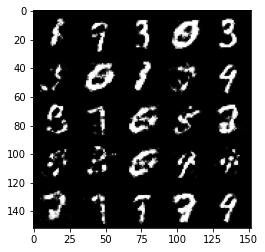

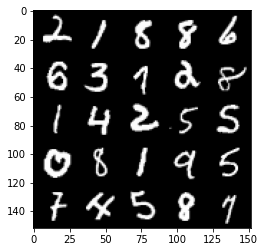

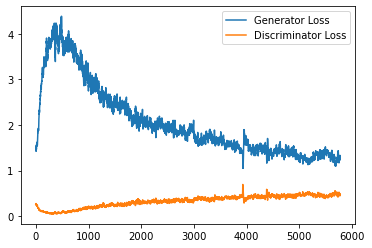

Step 116000: Generator loss: 1.2355311386585233, discriminator loss: 0.48565281546115857


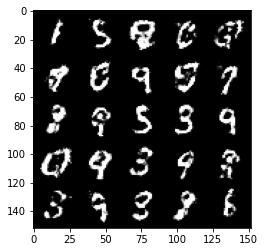

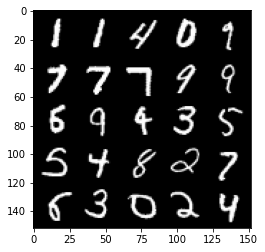

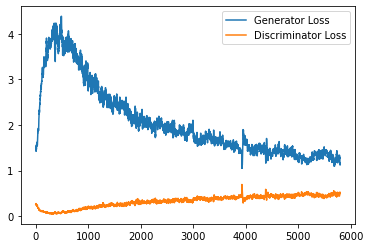

Step 116500: Generator loss: 1.2729960420131698, discriminator loss: 0.46972356438636786


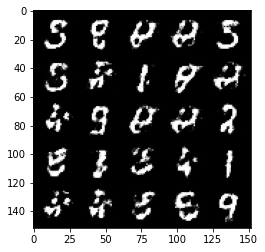

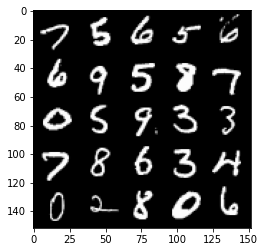

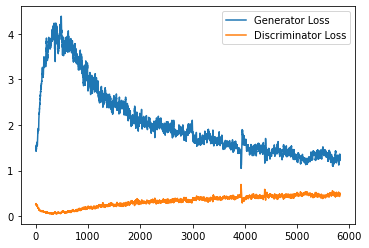

Step 117000: Generator loss: 1.2242840478420256, discriminator loss: 0.5031949654817585


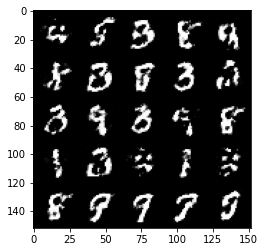

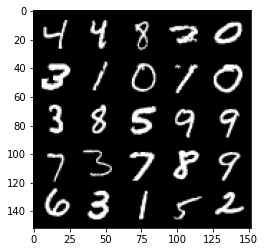

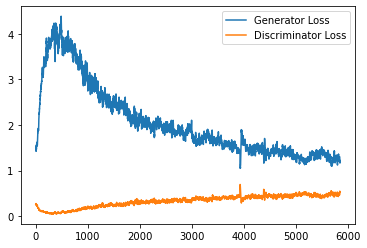

Step 117500: Generator loss: 1.1799455173015603, discriminator loss: 0.5181819503307344


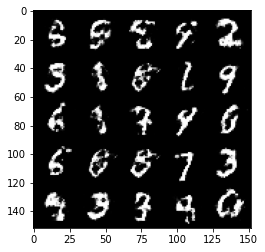

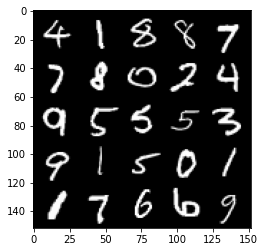

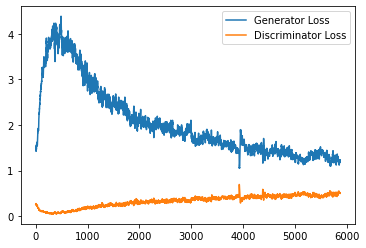

Step 118000: Generator loss: 1.198430189371108, discriminator loss: 0.4973087278008461


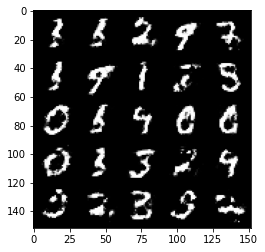

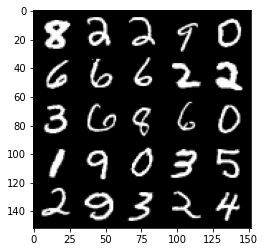

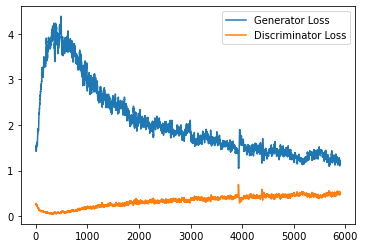

Step 118500: Generator loss: 1.1585986435413367, discriminator loss: 0.513088021874428


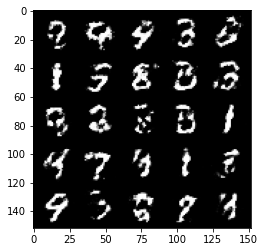

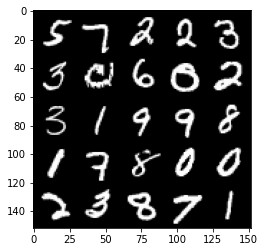

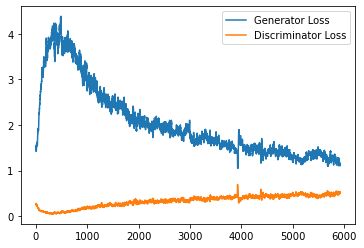

Step 119000: Generator loss: 1.1742846857309346, discriminator loss: 0.49774287343025164


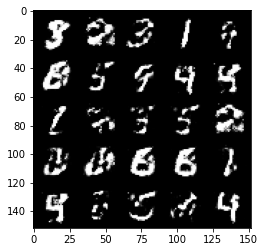

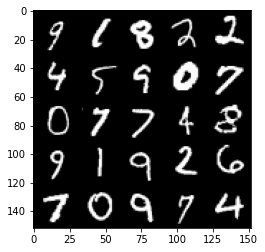

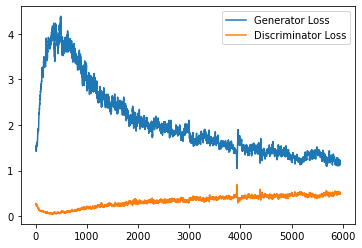

Step 119500: Generator loss: 1.1566316376924504, discriminator loss: 0.4962062608003623


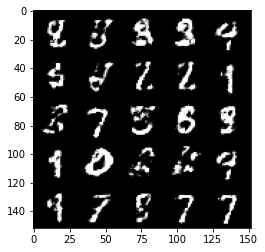

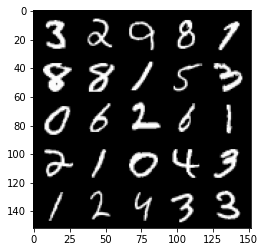

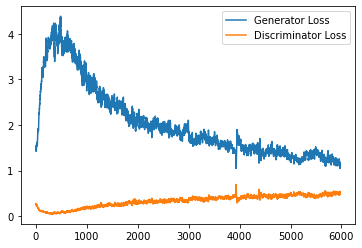

Step 120000: Generator loss: 1.1496301411390304, discriminator loss: 0.5094401825070383


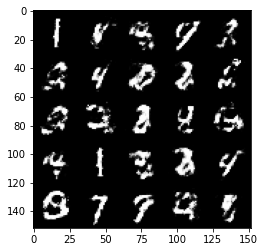

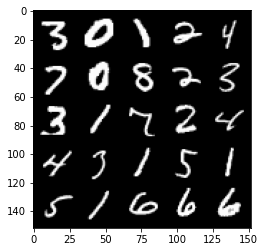

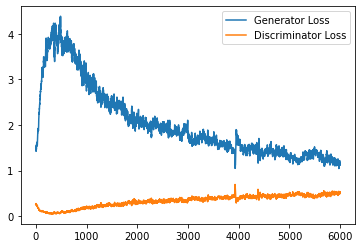

Step 120500: Generator loss: 1.158315588951111, discriminator loss: 0.5160955696105958


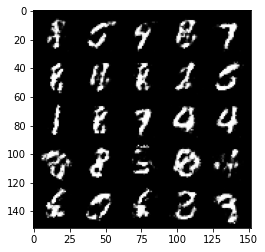

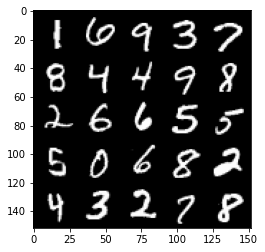

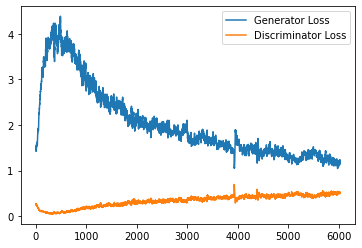

Step 121000: Generator loss: 1.1557907508611676, discriminator loss: 0.5192819638848305


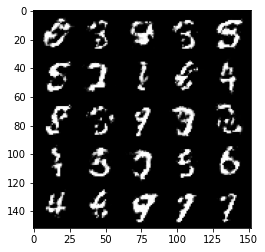

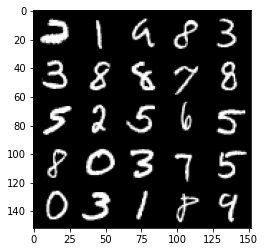

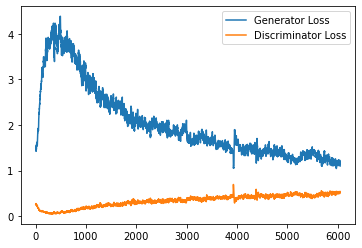

Step 121500: Generator loss: 1.1892251855134965, discriminator loss: 0.49834886753559127


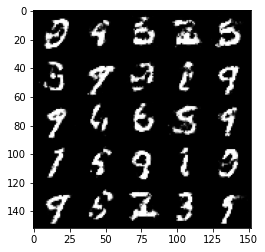

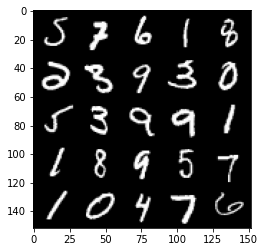

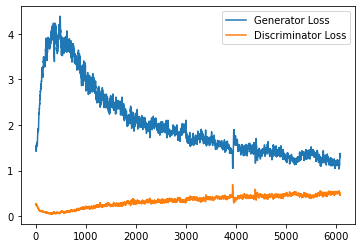

Step 122000: Generator loss: 1.2078886353969576, discriminator loss: 0.5043637635111808


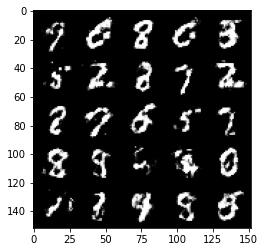

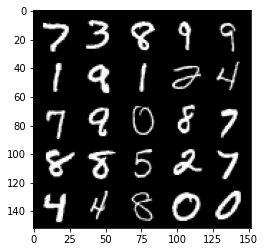

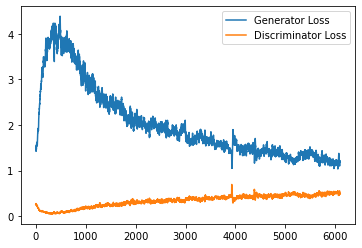

Step 122500: Generator loss: 1.1852439731359476, discriminator loss: 0.5095393233895302


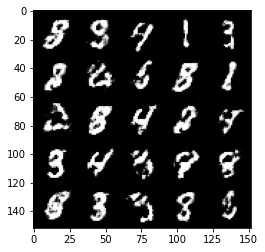

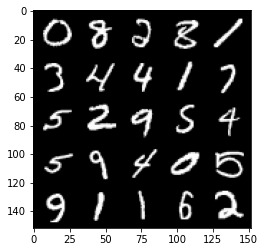

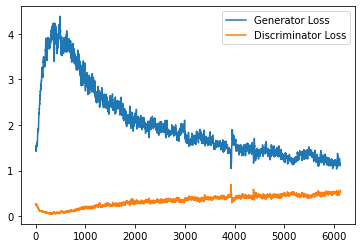

Step 123000: Generator loss: 1.084867793560029, discriminator loss: 0.5370252615213396


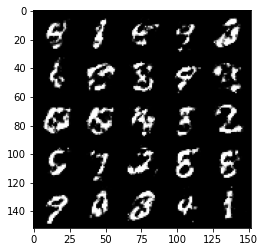

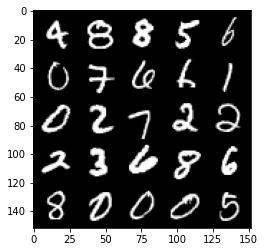

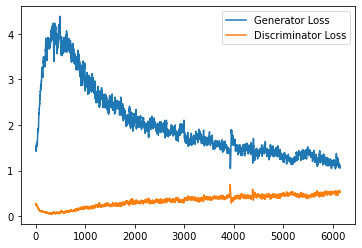

Step 123500: Generator loss: 1.1773565804958346, discriminator loss: 0.49763821011781667


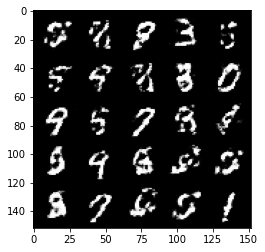

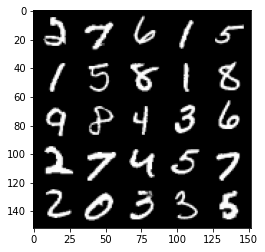

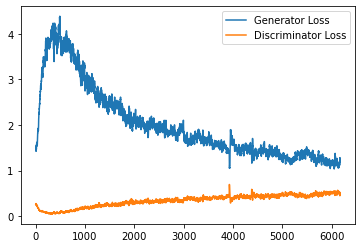

Step 124000: Generator loss: 1.1922730934619905, discriminator loss: 0.503370811700821


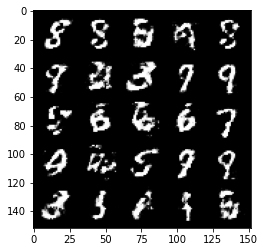

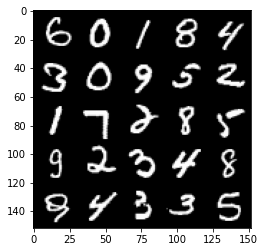

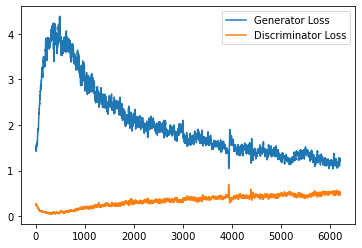

Step 124500: Generator loss: 1.2359484908580782, discriminator loss: 0.4895969969034198


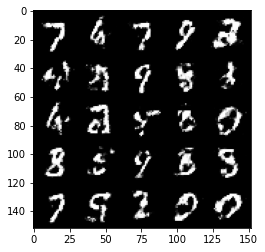

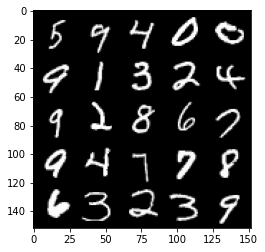

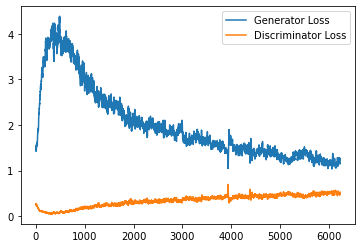

Step 125000: Generator loss: 1.1493446482419967, discriminator loss: 0.5198757616877554


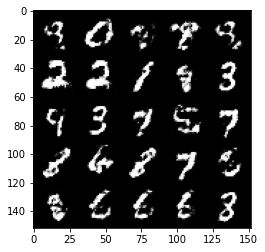

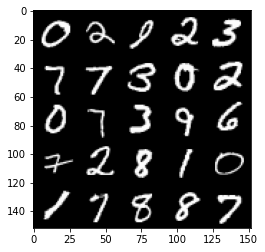

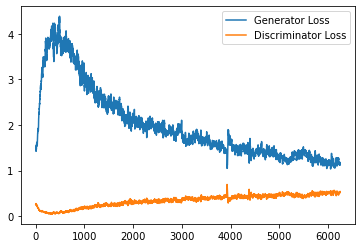

Step 125500: Generator loss: 1.1372275232076667, discriminator loss: 0.5250946150422094


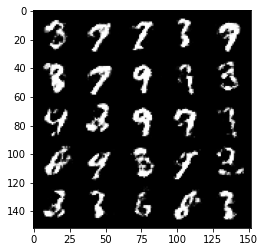

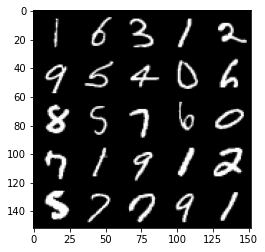

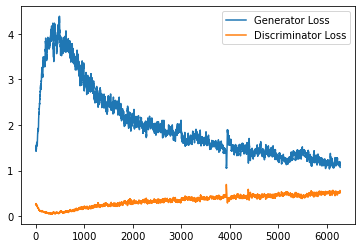

Step 126000: Generator loss: 1.0899479227066033, discriminator loss: 0.5291348019838334


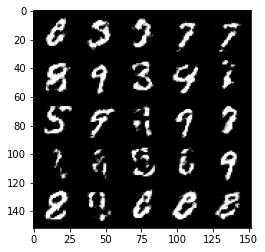

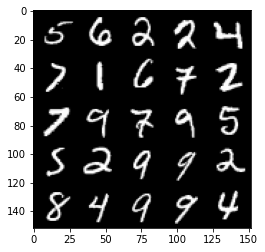

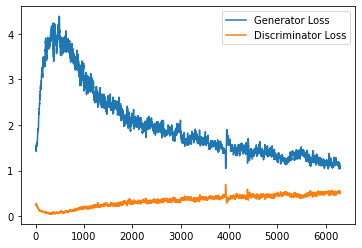

Step 126500: Generator loss: 1.1113058900833124, discriminator loss: 0.5216461298465725


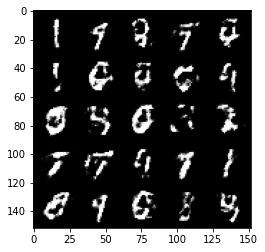

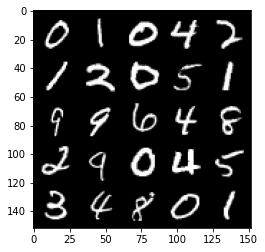

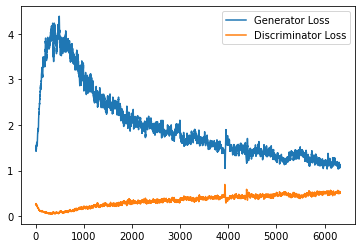

Step 127000: Generator loss: 1.1598200807571402, discriminator loss: 0.5004124229550362


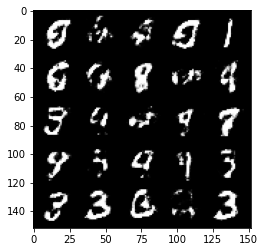

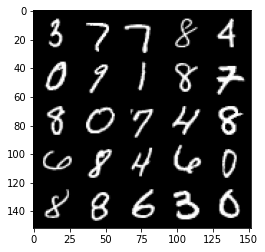

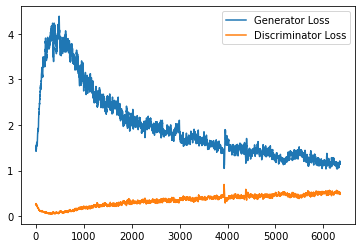

Step 127500: Generator loss: 1.1589970977306363, discriminator loss: 0.5085403484106071


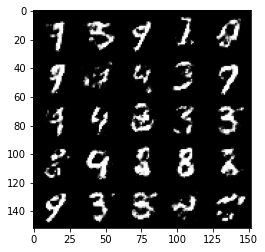

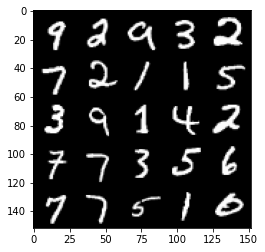

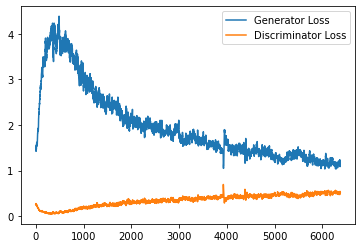

Step 128000: Generator loss: 1.1284948644638049, discriminator loss: 0.5140824825763703


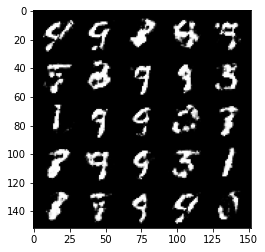

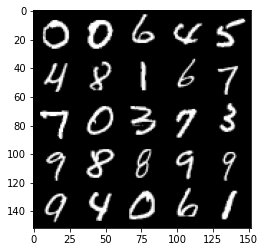

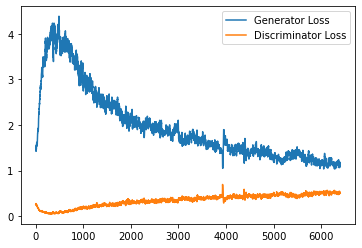

Step 128500: Generator loss: 1.1555991704463953, discriminator loss: 0.5064820886850355


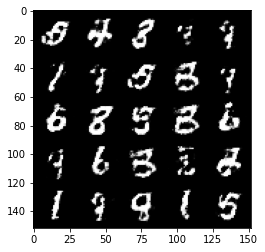

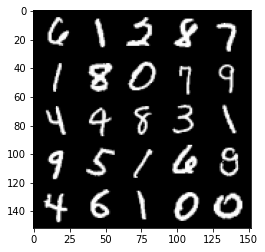

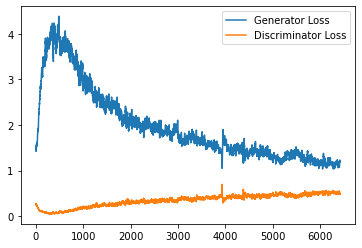

Step 129000: Generator loss: 1.2019061861038196, discriminator loss: 0.48327399379014946


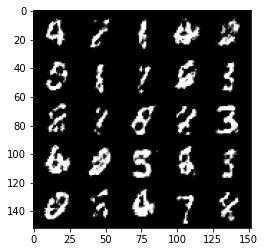

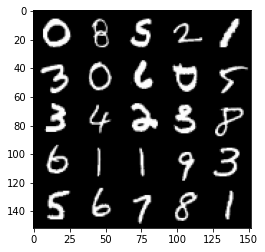

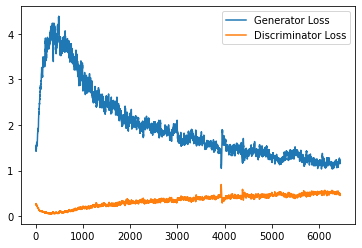

Step 129500: Generator loss: 1.185390721797943, discriminator loss: 0.5050359474420548


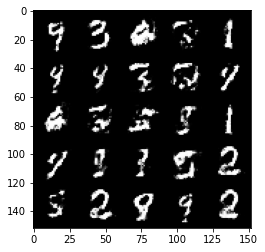

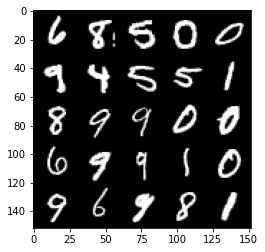

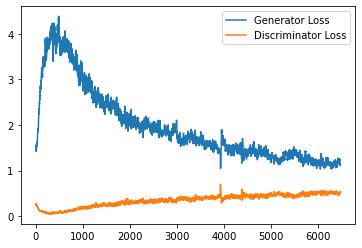

Step 130000: Generator loss: 1.1083355500698102, discriminator loss: 0.5231332327127456


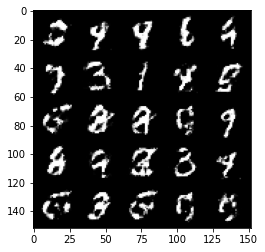

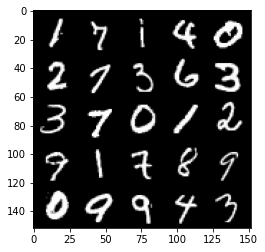

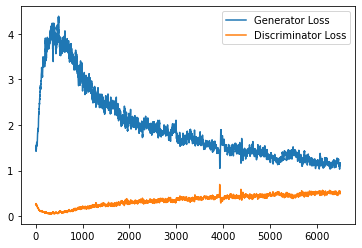

Step 130500: Generator loss: 1.1351947152614585, discriminator loss: 0.5191485614776614


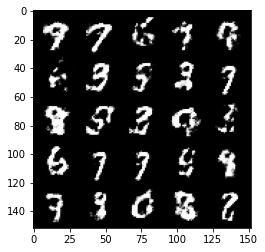

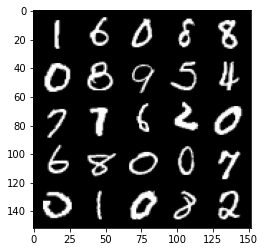

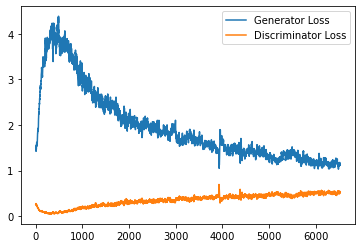

Step 131000: Generator loss: 1.1844411172866829, discriminator loss: 0.4877141926884655


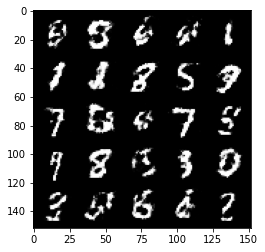

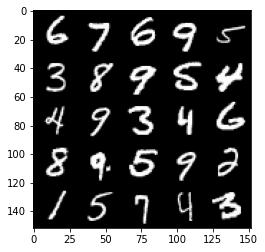

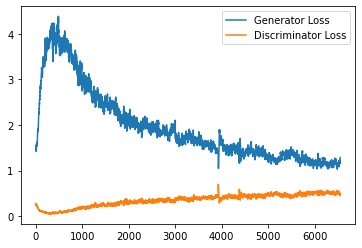

Step 131500: Generator loss: 1.1685172710418703, discriminator loss: 0.5025788487792018


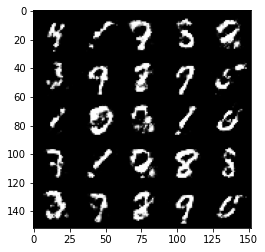

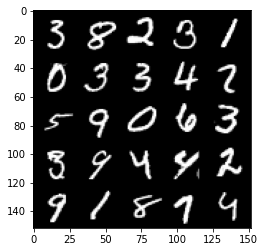

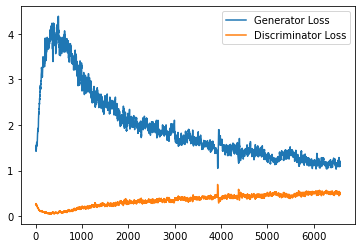

Step 132000: Generator loss: 1.0868788937330232, discriminator loss: 0.528952437341214


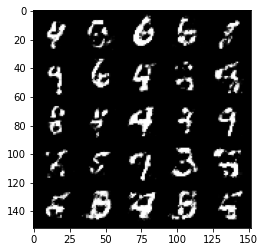

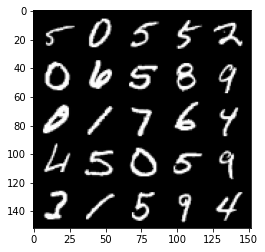

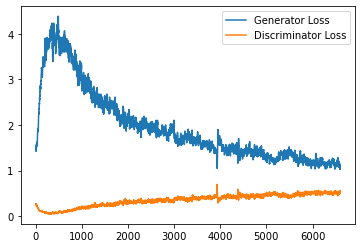

Step 132500: Generator loss: 1.121823455095291, discriminator loss: 0.5120140740871433


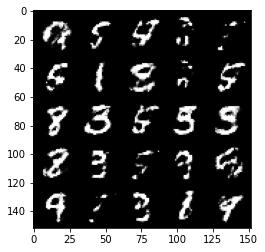

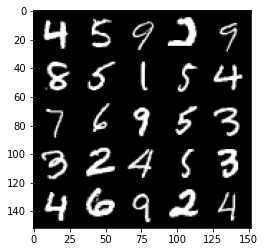

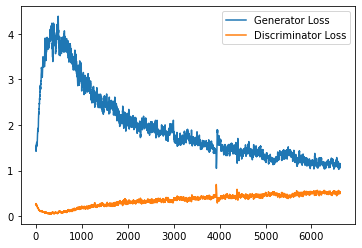

Step 133000: Generator loss: 1.0941198889017096, discriminator loss: 0.5210144478678702


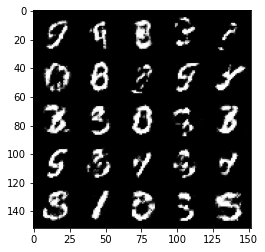

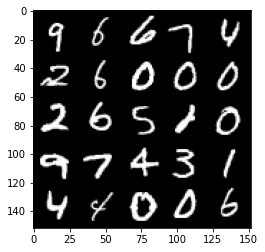

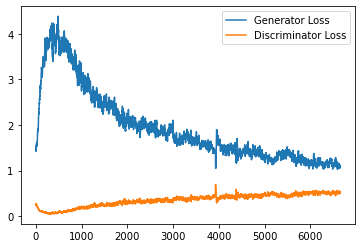

Step 133500: Generator loss: 1.08763729250431, discriminator loss: 0.5222348949909214


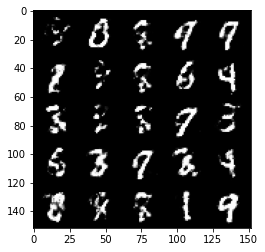

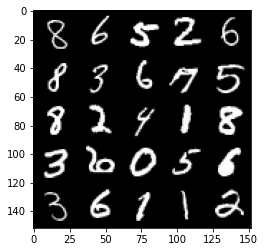

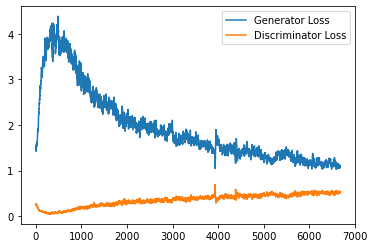

Step 134000: Generator loss: 1.1230732671022414, discriminator loss: 0.51680086094141


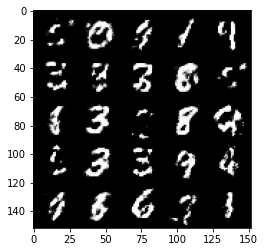

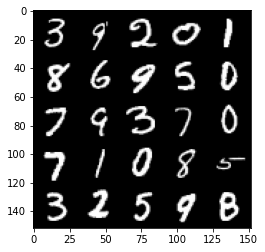

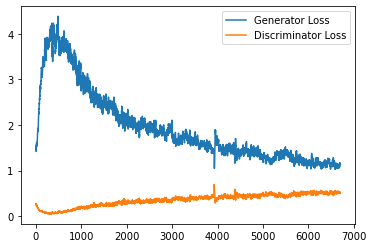

Step 134500: Generator loss: 1.0589907343387597, discriminator loss: 0.5349080966114999


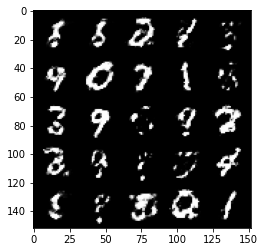

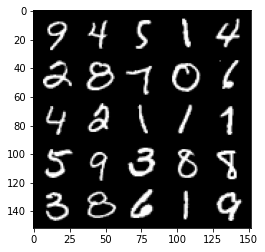

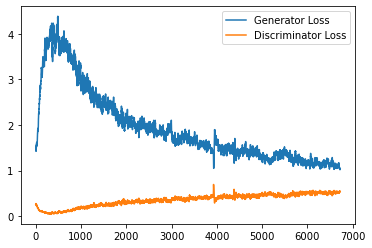

Step 135000: Generator loss: 1.0933884272575374, discriminator loss: 0.5203712607622148


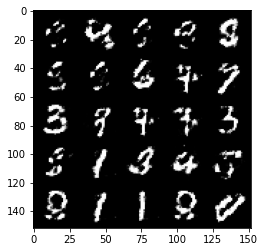

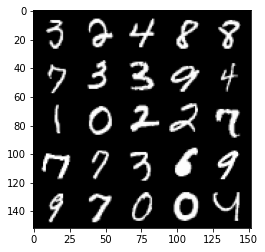

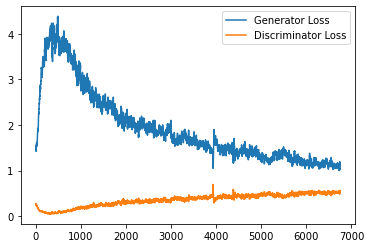

Step 135500: Generator loss: 1.1266768171787256, discriminator loss: 0.5114897277355196


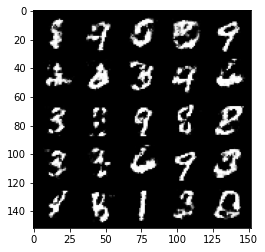

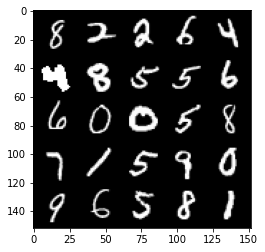

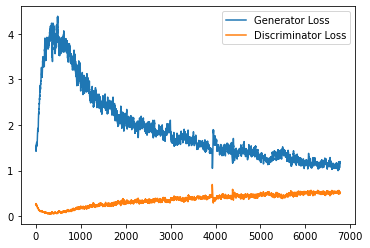

Step 136000: Generator loss: 1.1342464739084244, discriminator loss: 0.5166795686483383


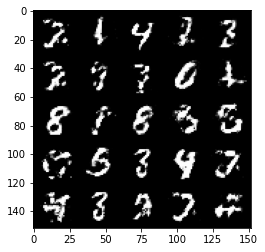

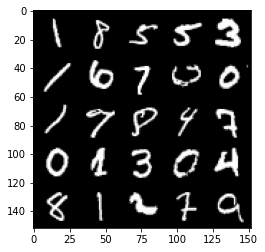

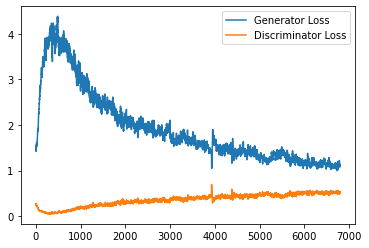

Step 136500: Generator loss: 1.1185163362026203, discriminator loss: 0.5298731054663659


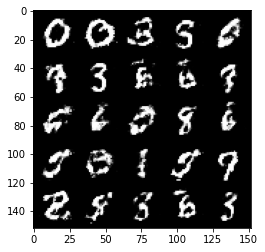

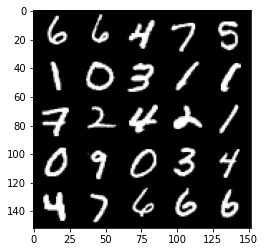

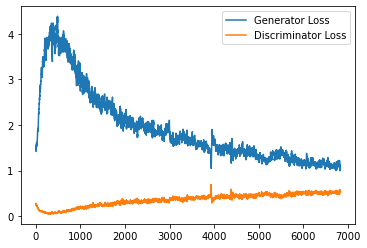

Step 137000: Generator loss: 1.0904127326011652, discriminator loss: 0.5342094074487685


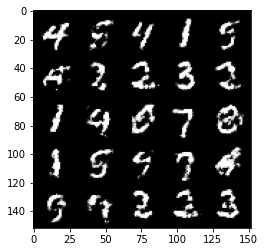

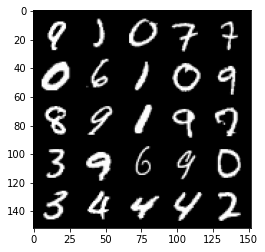

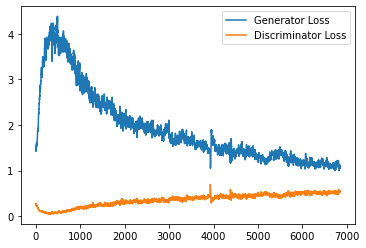

Step 137500: Generator loss: 1.1383643424510954, discriminator loss: 0.5074501142501828


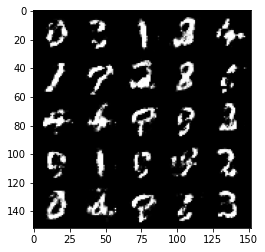

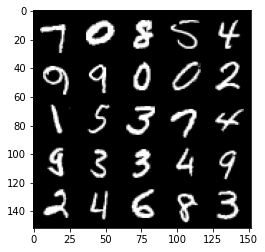

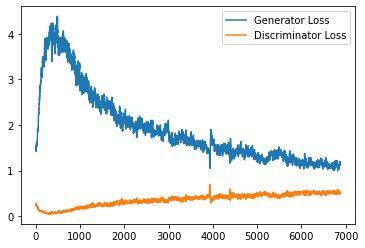

Step 138000: Generator loss: 1.1531767284870156, discriminator loss: 0.5052215000987058


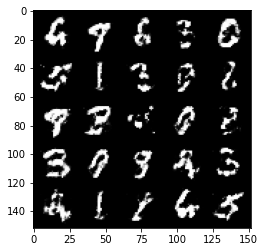

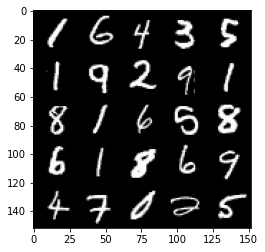

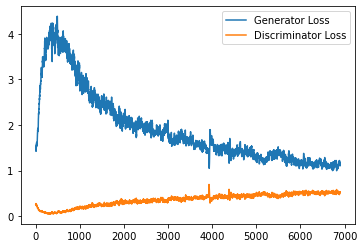

Step 138500: Generator loss: 1.0627232573032375, discriminator loss: 0.5537094789147379


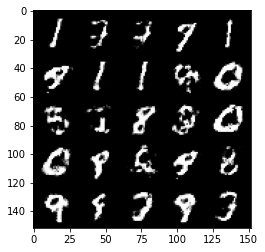

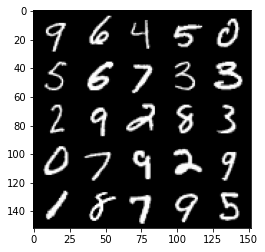

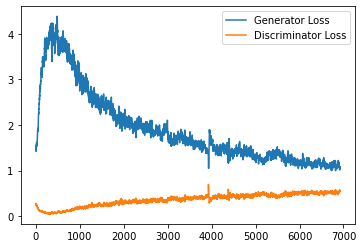

Step 139000: Generator loss: 1.0461309229135518, discriminator loss: 0.5582583942413332


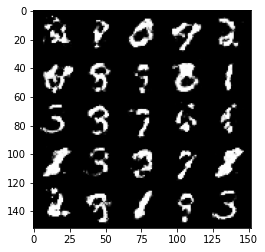

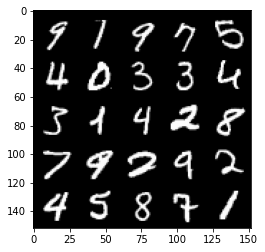

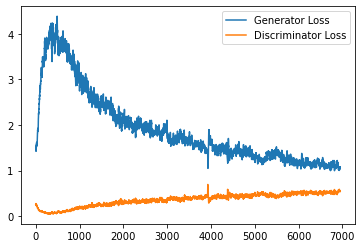

Step 139500: Generator loss: 1.0630344265699379, discriminator loss: 0.5398068803548808


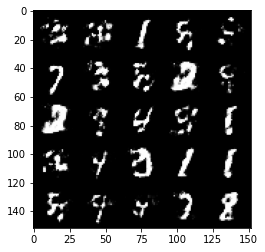

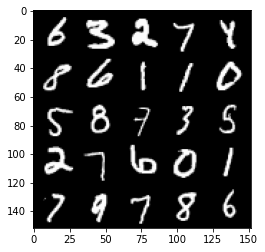

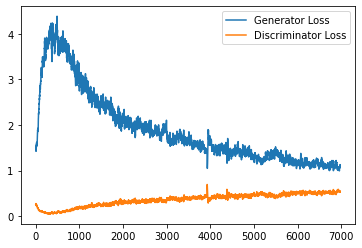

Step 140000: Generator loss: 1.093528325080873, discriminator loss: 0.5268887474536893


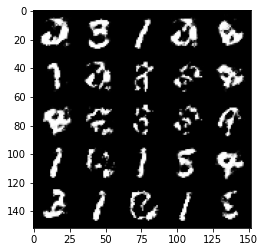

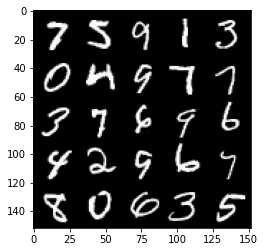

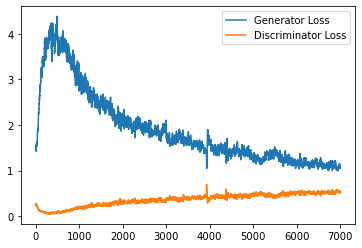

Step 140500: Generator loss: 1.1258525716066359, discriminator loss: 0.5178400580883026


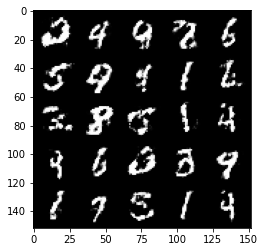

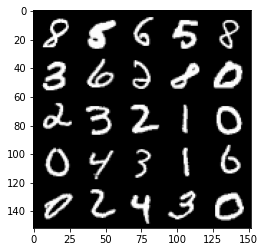

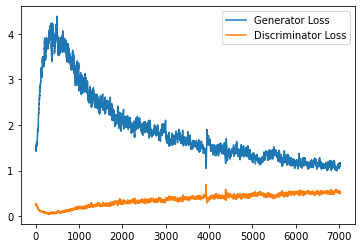

In [20]:
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
test_generator = True # Whether the generator should be tested
gen_loss = False
error = False

generator_losses = []
discriminator_losses = []

for epoch in range(n_epochs):
  
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)

        # Flatten the batch of real images from the dataset
        real = real.view(cur_batch_size, -1).to(device)

        ### Update discriminator ###
        # Zero out the gradients before backpropagation
        disc_opt.zero_grad()

        # Calculate discriminator loss
        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)

        # Update gradients
        disc_loss.backward(retain_graph=True)

        # Update optimizer
        disc_opt.step()

         # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        # For testing purposes, to keep track of the generator weights
        if test_generator:
            old_generator_weights = gen.gen[0][0].weight.detach().clone()
            
        ### Update generator ###
        #     Hint: This code will look a lot like the discriminator updates!
        #     These are the steps you will need to complete:
        #       1) Zero out the gradients.
        #       2) Calculate the generator loss, assigning it to gen_loss.
        #       3) Backprop through the generator: update the gradients and optimizer.
        
        gen_opt.zero_grad()
    
        gen_loss = get_gen_loss(gen, disc, criterion, cur_batch_size, z_dim, device)
        
        gen_loss.backward(retain_graph=True)

        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]

        # For testing purposes, to check that your code changes the generator weights
        if test_generator:
            try:
                assert lr > 0.0000002 or (gen.gen[0][0].weight.grad.abs().max() < 0.0005 and epoch == 0)
                assert torch.any(gen.gen[0][0].weight.detach().clone() != old_generator_weights)
            except:
                error = True
                print("Runtime tests have failed")

        # Keep track of the average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step

        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step

        
        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )

            mean_generator_loss = 0
            mean_discriminator_loss = 0
            plt.legend()
            plt.show()

        cur_step += 1
